In [1]:
import cv2
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms, models
from torch.utils.data import DataLoader, random_split, WeightedRandomSampler
from torch.optim import lr_scheduler, Adam
from torchmetrics.classification import MultilabelF1Score, MultilabelAccuracy, MultilabelAUROC
import torch.optim as optim
import matplotlib.pyplot as plt
import torchinfo
import pandas as pd
import numpy as np
# ImageFolder


In [2]:
torch.cuda.is_available()

True

In [3]:

from torchvision.datasets import ImageFolder

from PIL import Image, ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
# from cykooz.resizer import FilterType, ResizeAlg, Resizer




# for i in range(1, 10):
#     image = Image.open('nasa_%d-4928x3279.png' % i)
#     resizer.resize_pil(image, dst_image)
#     dst_image.save('nasa_%d-255x170.png' % i)

In [5]:
df_info = pd.read_csv('../data/wikiart_csv/genre_train.csv', header=None)
df_info.columns = ['filelocation', 'genre_code']
df_label = pd.read_csv('../data/wikiart_csv/genre_class.txt', sep=' ', header=None)
df_label.columns = ['genre_code', 'genre']

df_total = pd.merge(df_info, df_label, on='genre_code')
df_total = df_total[df_total['genre'] != 'nude_painting']
df_total

,filelocation,genre_code,genre
0,Northern_Renaissance/hieronymus-bosch_st-jacqu...,7,religious_painting
1,Northern_Renaissance/albrecht-durer_temptation...,7,religious_painting
2,Northern_Renaissance/joachim-patinir_rocky-lan...,7,religious_painting
3,Northern_Renaissance/albrecht-durer_the-adorat...,7,religious_painting
4,High_Renaissance/pinturicchio_the-annunciation...,7,religious_painting
...,...,...,...
45498,Expressionism/henri-matisse_still-life-with-a-...,9,still_life
45499,Cubism/amadeo-de-souza-cardoso_parto-da-viola-...,9,still_life
45500,Realism/martin-johnson-heade_giant-magnolias-o...,9,still_life
45501,Cubism/juan-gris_bottle-and-pitcher.jpg,9,still_life


In [6]:
df_total.genre.value_counts(), df_total.genre.nunique()

(portrait              9880
 landscape             9351
 genre_painting        7602
 religious_painting    4577
 abstract_painting     3478
 cityscape             3223
 sketch_and_study      2761
 still_life            1952
 illustration          1332
 Name: genre, dtype: int64,
 9)

In [7]:
def df_add_weight(df, name = 'genre'):
    df_weight = df.shape[0] / df.groupby(name)[name].count()
    print(df_weight)
    return df_weight

df_weight = df_add_weight(df_total)
# pd.merge(df_total, df_weight, how='inner', on='genre')
df_total_weight = pd.merge(df_total, df_weight, left_on='genre', right_index=True)
df_total_weight.drop('genre_x', axis=1, inplace=True)
df_total_weight.rename(columns={'genre_y': 'weights'}, inplace=True)
df_total_weight.head()


genre
abstract_painting     12.695802
cityscape             13.700279
genre_painting         5.808471
illustration          33.150150
landscape              4.722062
portrait               4.469231
religious_painting     9.647367
sketch_and_study      15.992756
still_life            22.620902
Name: genre, dtype: float64


,genre,filelocation,genre_code,weights
0,religious_painting,Northern_Renaissance/hieronymus-bosch_st-jacqu...,7,9.647367
1,religious_painting,Northern_Renaissance/albrecht-durer_temptation...,7,9.647367
2,religious_painting,Northern_Renaissance/joachim-patinir_rocky-lan...,7,9.647367
3,religious_painting,Northern_Renaissance/albrecht-durer_the-adorat...,7,9.647367
4,religious_painting,High_Renaissance/pinturicchio_the-annunciation...,7,9.647367


In [12]:
artistdf = pd.read_csv('../data/wikiart_csv/genre_val.csv', header=None)
artistdf.columns = ['filelocation', 'code']
artistdf_label = pd.read_csv('../data/wikiart_csv/genre_class.txt', sep=' ', header=None)
artistdf_label.columns = ['code', 'classes']

artistdf_total = pd.merge(artistdf, artistdf_label, on='code')
artistdf_total.head()

,filelocation,code,classes
0,Rococo/william-hogarth_w-a-rake-s-progress-the...,2,genre_painting
1,Impressionism/edgar-degas_dancers-on-set-1880.jpg,2,genre_painting
2,Mannerism_Late_Renaissance/jacopo-pontormo_epi...,2,genre_painting
3,Impressionism/giovanni-boldini_a-guitar-player...,2,genre_painting
4,Impressionism/john-singer-sargent_at-torre-gal...,2,genre_painting


In [13]:
import os
from PIL import Image
import shutil

ROOT = '../data/wiki_image/wikiart/'
TARGET = '../data/wiki_image/genre_val/'
def copy_image_via_category(ROOT, TARGET, df, find='classes'):
    os.makedirs(TARGET, exist_ok=True)
    for i, row in enumerate(df['filelocation'].values):
    # Image.open(ROOT + df_total_weight.iloc[0]['filelocation'], 'r')
        os.makedirs(TARGET + df.iloc[i][find], exist_ok=True)
        shutil.copy(ROOT + row, TARGET + df.iloc[i][find] + '/')

# copy_image_via_category(ROOT, TARGET, df_total_weight)
# copy_image_via_category(ROOT, TARGET, artistdf_total)

In [14]:
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [15]:
## 이미지 파일 전처리

preprocess_vgg11 = transforms.Compose(
    [
    # transforms.Resize((224 // 2, 224 //2)),
    transforms.ToTensor(),
    transforms.Normalize(
     mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
    ),
]
)

In [16]:
trainLocation = '../data/wiki_image/genre_train_resized/'
trainOrigin = '../data/wiki_image/genre_train/'
testLocation = '../data/wiki_image/genre_val_resize/'
testOrigin = '../data/wiki_image/genre_val/'

trainset = ImageFolder(trainLocation, transform=preprocess_vgg11)
testset = ImageFolder(testLocation, transform=preprocess_vgg11)
trainsetorigin = ImageFolder(trainOrigin, transform=preprocess_vgg11)
testsetorigin = ImageFolder(testOrigin, transform=preprocess_vgg11)
BATCH = 32
numCLASS = len(trainset.classes)

np.array(trainset.targets)

array([0, 0, 0, ..., 8, 8, 8])

In [17]:
from PIL import Image
import os
from cykooz.resizer import FilterType, ResizeAlg, Resizer
path = '../data/wiki_image/genre_train_resized/'

def resize(path):
    resizer = Resizer(ResizeAlg.convolution(FilterType.lanczos3))
    dst_size = (64, 64)
    
    for item in os.listdir( path ):
        if os.path.isfile(path+item):
            dst_image = Image.new('RGB', dst_size)
            image = Image.open(path+item)
            f, e = os.path.splitext(path+item)
            # imResize = im.resize((256,256))
            # print(path+item)
            resizer.resize_pil(image, dst_image)
            dst_image.save(f + '_resized.jpg', 'JPEG', quality=100)
            os.remove(path+item)
        elif not os.path.isfile(path+item):
            resize(path+item+'/')


# resize(path)

In [18]:
testset.targets.__len__()

18916

In [19]:
def weightfromtset(dataset):
    arrayset = np.array(dataset.targets)
    arrayset_unique = np.unique(arrayset, return_counts=True)[1]
    arrayset_ratio  = arrayset_unique / np.sum(arrayset_unique)
    arrayset_unique_weight = 1 / arrayset_ratio
    result = [arrayset_unique_weight[i] for i in arrayset]
    return result

trainweight = weightfromtset(trainset)
testweight = weightfromtset(testset)

trainweightsampler = WeightedRandomSampler(trainweight, len(trainweight))
testweightsampler = WeightedRandomSampler(testweight, len(testweight))

trainDL = DataLoader(trainset, sampler=trainweightsampler, batch_size=BATCH * 10,num_workers=16, generator=torch.manual_seed(42), drop_last=True)
testDL = DataLoader(testset, batch_size=testset.targets.__len__(), shuffle=True,num_workers=16,  drop_last=True)

np.unique(testweight)

array([ 4.46869832,  4.72073871,  5.80779859,  9.64609893, 12.69530201,
       13.70724638, 16.00338409, 22.62679426, 33.18596491])

In [20]:

class VGG11_pretrained(nn.Module):
    def __init__(self):
        super(VGG11_pretrained, self).__init__()
        self.model = models.vgg11(weights=models.VGG11_Weights.DEFAULT)
        self.model.classifier[6] = nn.Linear(4096, numCLASS)

        for name, model in self.model.named_parameters():
            if name.find('classifier') < 0:
                model.requires_grad = False
            else:
                model.requires_grad = True
        
    def forward(self, x):
        x = self.model(x)
        return x

class CustomModel(nn.Module):
    def __init__(self):
        super(CustomModel, self).__init__()
        self.seq = nn.Sequential(
        )
        self.seq.add_module('conv1_1', nn.Conv2d(3, 64, kernel_size=3, padding=1))
        self.seq.add_module('relu1_1', nn.ReLU(inplace=True))
        self.seq.add_module('pool1_1', nn.MaxPool2d(kernel_size=2, stride=2))
        self.seq.add_module('conv1_2', nn.Conv2d(64, 32, kernel_size=3, padding=1))
        self.seq.add_module('relu1_2', nn.ReLU(inplace=True))
        self.seq.add_module('pool1_2', nn.MaxPool2d(kernel_size=2, stride=2))
        self.seq.add_module('conv2_1', nn.Conv2d(32, 10, kernel_size=3, padding=1))
        self.seq.add_module('relu2_1', nn.ReLU(inplace=True))
        self.seq.add_module('pool2_1', nn.MaxPool2d(kernel_size=2, stride=2))
        self.seq.add_module('flatten', nn.Flatten())
        self.seq_fc = nn.Sequential(
        )
        self.seq_fc.add_module('fc1', nn.Linear(10 * 64, 1024))
        self.seq_fc.add_module('relu1', nn.ReLU(inplace=True))
        self.seq_fc.add_module('fc2', nn.Linear(1024, 10))

    def forward(self, x):
        x = self.seq(x)
        x = self.seq_fc(x)
        return x



model = VGG11_pretrained().to(DEVICE)
# model = CustomModel().to(DEVICE)


In [21]:
dir(model.model)

['T_destination',
 '__annotations__',
 '__call__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattr__',
 '__getattribute__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setstate__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_apply',
 '_backward_hooks',
 '_backward_pre_hooks',
 '_buffers',
 '_call_impl',
 '_compiled_call_impl',
 '_forward_hooks',
 '_forward_hooks_always_called',
 '_forward_hooks_with_kwargs',
 '_forward_pre_hooks',
 '_forward_pre_hooks_with_kwargs',
 '_get_backward_hooks',
 '_get_backward_pre_hooks',
 '_get_name',
 '_is_full_backward_hook',
 '_load_from_state_dict',
 '_load_state_dict_post_hooks',
 '_load_state_dict_pre_hooks',
 '_maybe_warn_non_full_backward_hook',
 '_modules',
 '_named_members',
 '_non_persistent_buffers_se

In [22]:
criterion = nn.CrossEntropyLoss()
optimizer = Adam(model.model.classifier.parameters(), lr=10e-7)
scheduler = lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

def train(model, trainDL, criterion, optimizer, scheduler, epoch):
    model.train()
    lossList = []
    f1List = []
    f1classList = []
    accList = []
    acc_class_list = []

    f1 = MultilabelF1Score(num_labels=numCLASS, threshold = 0.1).to(DEVICE)
    f1_class = MulticlassF1Score(num_classes=numCLASS).to(DEVICE)
    acc = MultilabelAccuracy(num_labels=numCLASS).to(DEVICE)

    auroc = MultilabelAUROC(num_labels=numCLASS).to(DEVICE)
    confusion = MultilabelConfusionMatrix(numCLASS).to(DEVICE)
    confusion_class = MulticlassConfusionMatrix(numCLASS).to(DEVICE)


    for idx, (images, labels) in enumerate(trainDL):
        images = images.to(DEVICE)
        labels_origin = labels.to(DEVICE)
        labels = F.one_hot(labels, numCLASS).to(DEVICE)
        labels = torch.tensor(labels, dtype=torch.float32).to(DEVICE)
        
        pred = model(images)

        loss = criterion(pred, labels)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        

        f1classList.append(f1_class(torch.max(pred, dim=1)[1], labels_origin).item())
        acc_class_list.append(torch.sum(torch.max(pred, dim=1)[1] == labels_origin).item() / labels_origin.shape[0])
        lossList.append(loss.item())
        
    # scheduler.step()
    
    result = np.mean(lossList)
    resultf1_class = np.mean(f1classList)
    resultacc_class = np.mean(acc_class_list)
    result_confu_class = confusion_class(torch.max(model(images), dim=1)[1], labels_origin)
    print(f'Epoch {epoch} Train Loss: {result}')

    return result, scheduler, resultf1_class, resultacc_class, result_confu_class

from torchmetrics.classification import MultilabelF1Score, MultilabelAccuracy, MultilabelAUROC, MultilabelConfusionMatrix, MulticlassConfusionMatrix, MulticlassF1Score, MultilabelRecall, MultilabelPrecision, MulticlassConfusionMatrix
# from torchmetrics.classificatopm import 

def test(model, testDL, criterion):
    model.eval()
    lossList = []
    f1List = []
    f1classList = []
    accList = []
    acc_class_list = []
    
    f1 = MultilabelF1Score(num_labels=numCLASS, threshold = 0.1).to(DEVICE)
    f1_class = MulticlassF1Score(num_classes=numCLASS).to(DEVICE)
    acc = MultilabelAccuracy(num_labels=numCLASS).to(DEVICE)

    auroc = MultilabelAUROC(num_labels=numCLASS).to(DEVICE)
    confusion = MultilabelConfusionMatrix(numCLASS).to(DEVICE)
    confusion_class = MulticlassConfusionMatrix(numCLASS).to(DEVICE)


    with torch.no_grad():
        for images, labels in testDL:
            images = images.to(DEVICE)
            labels = labels.to(DEVICE)
            labels_hot = torch.tensor(F.one_hot(labels, numCLASS).to(DEVICE), dtype=torch.float32).to(DEVICE)
            print(images.size(), images.shape, images.dtype)
            pred = model(images)
            loss = criterion(pred, labels_hot)

            f1classList.append(f1_class(torch.max(pred, dim=1)[1], labels).item())
            acc_class_list.append(torch.sum(torch.max(pred, dim=1)[1] == labels).item() / labels.shape[0])
            lossList.append(loss.item())
            
    result = np.mean(lossList)
    resultf1_class = np.mean(f1classList)
    resultacc_class = np.mean(acc_class_list)
    result_confu_class = confusion_class(torch.max(model(images), dim=1)[1], labels)

    print(f'Test Loss: {result}, F1 score : {resultf1_class}, Accuracy : {resultacc_class}')
    print(result_confu_class)
    print(torch.max(pred, dim=1)[1])
    print(labels)


    return result, resultf1_class, resultacc_class, result_confu_class
   
        



In [23]:
torchinfo.summary(model, (10, 3, 64, 64))

Layer (type:depth-idx)                   Output Shape              Param #
VGG11_pretrained                         [10, 9]                   --
├─VGG: 1-1                               [10, 9]                   --
│    └─Sequential: 2-1                   [10, 512, 2, 2]           --
│    │    └─Conv2d: 3-1                  [10, 64, 64, 64]          (1,792)
│    │    └─ReLU: 3-2                    [10, 64, 64, 64]          --
│    │    └─MaxPool2d: 3-3               [10, 64, 32, 32]          --
│    │    └─Conv2d: 3-4                  [10, 128, 32, 32]         (73,856)
│    │    └─ReLU: 3-5                    [10, 128, 32, 32]         --
│    │    └─MaxPool2d: 3-6               [10, 128, 16, 16]         --
│    │    └─Conv2d: 3-7                  [10, 256, 16, 16]         (295,168)
│    │    └─ReLU: 3-8                    [10, 256, 16, 16]         --
│    │    └─Conv2d: 3-9                  [10, 256, 16, 16]         (590,080)
│    │    └─ReLU: 3-10                   [10, 256, 16, 16]  

In [48]:
EPOCHES = 30
from tqdm import tqdm, trange
f1 = []
f1_train = []
acc = []
acc_train = []
train_loss = []
test_loss = []
min_lr = 10e-10


In [49]:

for epoch in tqdm(range(EPOCHES), desc='Epoch'):
    loss, scheduler, resultf1_class, resultacc_class, result_confu_class= train(model, trainDL, criterion, optimizer, scheduler, epoch)
    result = test(model, testDL, criterion)
    f1.append(result[1])
    f1_train.append(resultf1_class)
    acc.append(result[2])
    acc_train.append(resultacc_class)
    train_loss.append(loss)
    test_loss.append(result[0])
    print(testset.classes)
    
    # cm = result[3].cpu().numpy()
    # if scheduler.get_last_lr()[-1] < min_lr:
    #     print(f"Min LR Reached break run")
    #     break
        



Epoch:   0%|          | 0/300 [00:00<?, ?it/s]

/tmp/ipykernel_70242/228821428.py:26: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels = torch.tensor(labels, dtype=torch.float32).to(DEVICE)


Epoch 0 Train Loss: 2.353117880159921


/tmp/ipykernel_70242/228821428.py:75: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels_hot = torch.tensor(F.one_hot(labels, numCLASS).to(DEVICE), dtype=torch.float32).to(DEVICE)


torch.Size([18916, 3, 64, 64]) torch.Size([18916, 3, 64, 64]) torch.float32


Epoch:   0%|          | 1/300 [00:14<1:11:23, 14.32s/it]

Test Loss: 2.007401466369629, F1 score : 0.25250566005706787, Accuracy : 0.29075914569676464
tensor([[ 484,  122,  225,  133,   26,  102,   89,  269,   40],
        [  40,  597,  144,  144,  169,   30,   74,  113,   69],
        [ 228,  661,  586,  384,  293,  344,  243,  263,  255],
        [  35,   73,   68,  128,   24,   45,   55,  112,   30],
        [ 187,  842,  457,  657, 1190,  113,  176,  254,  131],
        [ 349,  310,  645,  261,  145, 1741,  215,  356,  211],
        [ 126,  310,  300,  271,   79,  306,  204,  159,  206],
        [  49,   87,  144,  148,   50,  141,   61,  465,   37],
        [ 135,   61,  175,   62,   49,  131,   47,   71,  105]],
       device='cuda:0')
tensor([4, 0, 1,  ..., 0, 7, 0], device='cuda:0')
tensor([5, 3, 6,  ..., 2, 5, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 1 Train Loss: 2.0868640424561327
torch.Size([18916

Epoch:   1%|          | 2/300 [00:28<1:10:45, 14.25s/it]

Test Loss: 1.8053086996078491, F1 score : 0.3518756031990051, Accuracy : 0.40579403679424825
tensor([[ 715,   96,  107,  101,   41,   70,   80,  208,   72],
        [  29,  752,   70,   80,  239,   17,   76,   80,   37],
        [ 161,  636,  452,  261,  422,  412,  343,  259,  311],
        [  30,   50,   45,  161,   37,   35,   70,  106,   36],
        [ 147,  774,  233,  291, 2003,   80,  162,  202,  115],
        [ 172,  153,  382,  160,  102, 2380,  279,  347,  258],
        [  63,  270,  209,  218,   93,  358,  341,  139,  270],
        [  36,   55,   60,  120,   60,  110,   57,  643,   41],
        [ 111,   44,  109,   43,   44,  125,   66,   65,  229]],
       device='cuda:0')
tensor([8, 3, 5,  ..., 7, 8, 2], device='cuda:0')
tensor([8, 4, 5,  ..., 2, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 2 Train Loss: 1.8950026131024327
torch.Size([18916

Epoch:   1%|          | 3/300 [00:42<1:09:11, 13.98s/it]

Test Loss: 1.6574900150299072, F1 score : 0.4005999267101288, Accuracy : 0.45654472404313806
tensor([[ 849,   70,   61,   86,   52,   38,   62,  166,  106],
        [  26,  804,   55,   53,  271,   11,   64,   67,   29],
        [ 134,  577,  409,  218,  497,  398,  408,  263,  353],
        [  23,   35,   34,  185,   46,   23,   67,  114,   43],
        [ 139,  653,  181,  185, 2375,   52,  137,  182,  103],
        [ 126,   95,  292,  117,   93, 2536,  310,  354,  310],
        [  50,  230,  178,  207,  107,  332,  446,  135,  276],
        [  30,   44,   34,  112,   77,   90,   55,  706,   34],
        [  99,   30,   87,   28,   39,   98,   75,   54,  326]],
       device='cuda:0')
tensor([7, 8, 4,  ..., 1, 4, 4], device='cuda:0')
tensor([3, 8, 4,  ..., 1, 2, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 3 Train Loss: 1.765187925665918
torch.Size([18916,

Epoch:   1%|▏         | 4/300 [00:56<1:09:05, 14.00s/it]

Test Loss: 1.5519496202468872, F1 score : 0.43133676052093506, Accuracy : 0.48493338972298583
tensor([[ 924,   50,   48,   75,   53,   27,   50,  142,  121],
        [  25,  831,   44,   58,  269,    5,   61,   54,   33],
        [ 129,  532,  442,  226,  511,  379,  445,  238,  355],
        [  25,   39,   28,  208,   41,   19,   62,  105,   43],
        [ 144,  602,  165,  165, 2505,   36,  132,  166,   92],
        [ 126,   68,  258,  120,   77, 2585,  324,  339,  336],
        [  44,  202,  164,  198,  101,  322,  562,  123,  245],
        [  32,   38,   33,  112,   73,   83,   51,  729,   31],
        [  97,   26,   64,   28,   31,   80,   78,   45,  387]],
       device='cuda:0')
tensor([2, 6, 8,  ..., 6, 6, 5], device='cuda:0')
tensor([6, 6, 2,  ..., 2, 4, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 4 Train Loss: 1.6514948093108017
torch.Size([1891

Epoch:   2%|▏         | 5/300 [01:10<1:08:50, 14.00s/it]

Test Loss: 1.4744280576705933, F1 score : 0.45502644777297974, Accuracy : 0.5050222034256714
tensor([[ 972,   42,   45,   61,   53,   22,   44,  120,  131],
        [  24,  830,   44,   52,  284,    4,   54,   51,   37],
        [ 115,  461,  502,  217,  525,  348,  471,  238,  380],
        [  23,   30,   26,  224,   49,   15,   64,   96,   43],
        [ 138,  542,  156,  145, 2629,   27,  128,  148,   94],
        [ 114,   55,  257,  123,   79, 2555,  342,  335,  373],
        [  41,  181,  179,  191,  105,  279,  653,  111,  221],
        [  28,   36,   28,  113,   70,   75,   50,  750,   32],
        [  85,   24,   60,   24,   25,   62,   74,   44,  438]],
       device='cuda:0')
tensor([0, 3, 5,  ..., 1, 1, 0], device='cuda:0')
tensor([0, 7, 5,  ..., 4, 4, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 5 Train Loss: 1.5686265317192913
torch.Size([18916

Epoch:   2%|▏         | 6/300 [01:23<1:07:59, 13.88s/it]

Test Loss: 1.4177980422973633, F1 score : 0.47063350677490234, Accuracy : 0.5189257771198985
tensor([[1007,   40,   38,   57,   47,   20,   41,  107,  133],
        [  27,  862,   43,   52,  264,    4,   48,   46,   34],
        [ 107,  459,  530,  213,  503,  364,  490,  228,  363],
        [  25,   29,   25,  240,   45,   15,   58,   91,   42],
        [ 139,  558,  149,  139, 2635,   22,  123,  147,   95],
        [ 107,   48,  240,  117,   66, 2617,  355,  319,  364],
        [  38,  169,  176,  194,   98,  266,  718,  106,  196],
        [  24,   38,   29,  117,   68,   79,   50,  747,   30],
        [  77,   22,   51,   21,   23,   61,   75,   46,  460]],
       device='cuda:0')
tensor([1, 2, 0,  ..., 8, 0, 8], device='cuda:0')
tensor([2, 2, 0,  ..., 6, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 6 Train Loss: 1.5131710846058644
torch.Size([18916

Epoch:   2%|▏         | 7/300 [01:37<1:07:52, 13.90s/it]

Test Loss: 1.3842992782592773, F1 score : 0.4810025990009308, Accuracy : 0.5261154578134912
tensor([[1015,   39,   39,   56,   45,   17,   37,   96,  146],
        [  25,  882,   47,   47,  248,    4,   45,   46,   36],
        [ 104,  459,  584,  204,  474,  340,  491,  228,  373],
        [  24,   29,   24,  252,   38,   15,   58,   87,   43],
        [ 136,  592,  149,  127, 2617,   21,  116,  149,  100],
        [ 101,   46,  247,  115,   57, 2603,  367,  316,  381],
        [  36,  154,  183,  191,   95,  253,  760,  105,  184],
        [  26,   40,   35,  117,   61,   74,   47,  751,   31],
        [  70,   22,   48,   20,   21,   52,   72,   43,  488]],
       device='cuda:0')
tensor([3, 4, 7,  ..., 5, 5, 7], device='cuda:0')
tensor([0, 4, 5,  ..., 5, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 7 Train Loss: 1.475959392359657
torch.Size([18916, 

Epoch:   3%|▎         | 8/300 [01:51<1:06:57, 13.76s/it]

Test Loss: 1.3547946214675903, F1 score : 0.49078431725502014, Accuracy : 0.5351025586804822
tensor([[1023,   35,   44,   59,   45,   17,   34,   87,  146],
        [  24,  875,   50,   50,  253,    2,   46,   44,   36],
        [ 101,  418,  672,  210,  471,  324,  481,  228,  352],
        [  24,   26,   29,  258,   37,   15,   58,   83,   40],
        [ 139,  557,  163,  124, 2656,   15,  104,  151,   98],
        [  95,   39,  270,  120,   54, 2609,  349,  321,  376],
        [  36,  142,  207,  193,   91,  239,  772,  108,  173],
        [  27,   38,   37,  120,   60,   71,   43,  757,   29],
        [  66,   20,   50,   22,   19,   47,   73,   39,  500]],
       device='cuda:0')
tensor([2, 5, 4,  ..., 4, 5, 1], device='cuda:0')
tensor([2, 2, 4,  ..., 1, 7, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 8 Train Loss: 1.4310586783137635
torch.Size([18916

Epoch:   3%|▎         | 9/300 [02:04<1:06:38, 13.74s/it]

Test Loss: 1.3324583768844604, F1 score : 0.49829813838005066, Accuracy : 0.5417635863818989
tensor([[1023,   33,   41,   60,   46,   20,   32,   84,  151],
        [  25,  882,   51,   47,  245,    2,   47,   44,   37],
        [  95,  387,  709,  216,  466,  324,  482,  222,  356],
        [  25,   21,   30,  264,   37,   16,   61,   78,   38],
        [ 133,  558,  166,  125, 2668,   15,  102,  147,   93],
        [  84,   37,  273,  128,   50, 2626,  349,  310,  376],
        [  34,  122,  209,  191,   86,  234,  815,  109,  161],
        [  26,   38,   37,  118,   58,   74,   46,  758,   27],
        [  61,   20,   50,   22,   20,   48,   74,   38,  503]],
       device='cuda:0')
tensor([2, 8, 0,  ..., 5, 5, 4], device='cuda:0')
tensor([8, 8, 2,  ..., 6, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 9 Train Loss: 1.401656415340674
torch.Size([18916,

Epoch:   3%|▎         | 10/300 [02:18<1:06:12, 13.70s/it]

Test Loss: 1.3159319162368774, F1 score : 0.5046319365501404, Accuracy : 0.5465743286107
tensor([[1021,   32,   43,   61,   43,   21,   30,   83,  156],
        [  22,  889,   52,   49,  240,    2,   47,   43,   36],
        [  94,  377,  750,  221,  456,  301,  497,  214,  347],
        [  22,   21,   30,  276,   34,   16,   60,   72,   39],
        [ 134,  560,  166,  126, 2671,   14,  102,  143,   91],
        [  82,   39,  277,  130,   49, 2613,  364,  301,  378],
        [  32,  115,  200,  193,   85,  223,  855,  106,  152],
        [  25,   38,   36,  122,   57,   74,   47,  755,   28],
        [  58,   20,   53,   24,   17,   43,   77,   35,  509]],
       device='cuda:0')
tensor([6, 0, 8,  ..., 0, 1, 5], device='cuda:0')
tensor([6, 0, 4,  ..., 6, 1, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 10 Train Loss: 1.3755125390352123
torch.Size([18916, 3

Epoch:   4%|▎         | 11/300 [02:32<1:05:53, 13.68s/it]

Test Loss: 1.2988382577896118, F1 score : 0.5089079737663269, Accuracy : 0.5505920913512371
tensor([[1035,   30,   42,   61,   42,   22,   30,   78,  150],
        [  23,  894,   52,   45,  240,    3,   48,   42,   33],
        [  97,  384,  755,  213,  455,  317,  492,  221,  323],
        [  21,   23,   28,  285,   31,   16,   58,   72,   36],
        [ 134,  568,  169,  125, 2675,   14,   96,  142,   84],
        [  80,   39,  273,  128,   52, 2646,  352,  305,  358],
        [  32,  113,  203,  192,   85,  226,  861,  111,  138],
        [  28,   40,   36,  126,   56,   71,   43,  758,   24],
        [  58,   21,   51,   23,   19,   46,   76,   36,  506]],
       device='cuda:0')
tensor([5, 1, 7,  ..., 5, 5, 5], device='cuda:0')
tensor([5, 1, 7,  ..., 5, 5, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 11 Train Loss: 1.3567872430286267
torch.Size([18916

Epoch:   4%|▍         | 12/300 [02:46<1:05:53, 13.73s/it]

Test Loss: 1.2887471914291382, F1 score : 0.5135913491249084, Accuracy : 0.5541869316980335
tensor([[1033,   29,   40,   62,   42,   22,   32,   76,  154],
        [  23,  885,   61,   45,  238,    1,   51,   41,   35],
        [  95,  361,  795,  216,  440,  293,  513,  215,  329],
        [  21,   22,   31,  286,   28,   16,   59,   72,   35],
        [ 128,  555,  180,  126, 2675,   12,  103,  140,   88],
        [  72,   37,  274,  126,   50, 2635,  367,  304,  368],
        [  31,  103,  198,  190,   83,  218,  894,  107,  137],
        [  27,   38,   38,  126,   54,   69,   44,  761,   25],
        [  55,   20,   51,   24,   18,   42,   73,   34,  519]],
       device='cuda:0')
tensor([8, 5, 2,  ..., 3, 6, 4], device='cuda:0')
tensor([5, 5, 2,  ..., 5, 6, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 12 Train Loss: 1.3411867644665014
torch.Size([18916

Epoch:   4%|▍         | 13/300 [02:59<1:05:51, 13.77s/it]

Test Loss: 1.278132438659668, F1 score : 0.5163031816482544, Accuracy : 0.5567244660604779
tensor([[1033,   29,   39,   63,   43,   22,   31,   75,  155],
        [  24,  885,   66,   46,  235,    1,   50,   40,   33],
        [  94,  353,  807,  220,  437,  304,  508,  206,  328],
        [  21,   21,   30,  292,   28,   16,   57,   70,   35],
        [ 127,  546,  176,  133, 2682,   13,  106,  138,   86],
        [  73,   38,  278,  128,   45, 2648,  360,  294,  369],
        [  34,   98,  199,  194,   80,  217,  905,  102,  132],
        [  28,   35,   37,  132,   55,   72,   46,  751,   26],
        [  55,   17,   49,   25,   17,   40,   71,   34,  528]],
       device='cuda:0')
tensor([4, 7, 2,  ..., 6, 1, 2], device='cuda:0')
tensor([2, 7, 6,  ..., 6, 2, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 13 Train Loss: 1.3191613315665809
torch.Size([18916,

Epoch:   5%|▍         | 14/300 [03:13<1:05:36, 13.76s/it]

Test Loss: 1.2700190544128418, F1 score : 0.519677460193634, Accuracy : 0.5595791922182279
tensor([[1046,   31,   36,   59,   41,   21,   31,   73,  152],
        [  24,  901,   63,   46,  231,    2,   45,   36,   32],
        [  96,  359,  830,  212,  427,  307,  486,  209,  331],
        [  21,   21,   28,  292,   29,   16,   57,   69,   37],
        [ 126,  560,  173,  129, 2674,   13,   97,  146,   89],
        [  70,   39,  289,  123,   43, 2648,  341,  301,  379],
        [  35,   99,  198,  190,   80,  219,  901,  104,  135],
        [  29,   35,   39,  126,   54,   70,   44,  760,   25],
        [  55,   16,   48,   22,   17,   39,   70,   36,  533]],
       device='cuda:0')
tensor([1, 2, 4,  ..., 7, 6, 1], device='cuda:0')
tensor([1, 5, 0,  ..., 7, 6, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 14 Train Loss: 1.3056678658854353
torch.Size([18916,

Epoch:   5%|▌         | 15/300 [03:27<1:05:10, 13.72s/it]

Test Loss: 1.262913703918457, F1 score : 0.5236880779266357, Accuracy : 0.5628568407697188
tensor([[1050,   31,   35,   58,   41,   16,   31,   72,  156],
        [  24,  909,   64,   45,  222,    1,   47,   37,   31],
        [  94,  360,  836,  208,  416,  302,  504,  211,  326],
        [  21,   22,   28,  296,   26,   14,   59,   68,   36],
        [ 120,  566,  171,  129, 2673,   14,   97,  149,   88],
        [  65,   39,  281,  121,   42, 2646,  361,  303,  375],
        [  35,   95,  191,  182,   80,  202,  940,  106,  130],
        [  28,   34,   41,  126,   53,   68,   47,  761,   24],
        [  52,   16,   43,   21,   15,   40,   76,   37,  536]],
       device='cuda:0')
tensor([3, 5, 8,  ..., 5, 5, 3], device='cuda:0')
tensor([3, 5, 1,  ..., 5, 5, 3], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 15 Train Loss: 1.2841820099057943
torch.Size([18916,

Epoch:   5%|▌         | 16/300 [03:41<1:05:45, 13.89s/it]

Test Loss: 1.2538543939590454, F1 score : 0.5262950658798218, Accuracy : 0.5652886445337281
tensor([[1059,   31,   35,   57,   41,   17,   31,   72,  147],
        [  23,  916,   60,   44,  222,    2,   45,   38,   30],
        [  94,  367,  833,  212,  412,  311,  505,  209,  314],
        [  21,   21,   29,  302,   26,   14,   59,   66,   32],
        [ 117,  575,  172,  127, 2674,   12,   98,  150,   82],
        [  64,   39,  272,  120,   42, 2671,  356,  309,  360],
        [  35,   95,  189,  185,   80,  207,  943,  107,  120],
        [  28,   37,   41,  125,   52,   68,   47,  763,   21],
        [  51,   16,   43,   22,   15,   44,   76,   37,  532]],
       device='cuda:0')
tensor([7, 0, 6,  ..., 4, 5, 0], device='cuda:0')
tensor([4, 0, 6,  ..., 4, 5, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 16 Train Loss: 1.2723597027089475
torch.Size([18916

Epoch:   6%|▌         | 17/300 [03:55<1:05:04, 13.80s/it]

Test Loss: 1.2451879978179932, F1 score : 0.5281009674072266, Accuracy : 0.567508987100867
tensor([[1066,   30,   35,   62,   41,   14,   31,   68,  143],
        [  23,  906,   59,   45,  232,    2,   44,   39,   30],
        [  92,  348,  840,  222,  429,  309,  492,  204,  321],
        [  22,   21,   29,  305,   27,   14,   56,   64,   32],
        [ 111,  552,  161,  128, 2714,   12,   95,  149,   85],
        [  62,   37,  277,  125,   47, 2669,  351,  305,  360],
        [  36,   93,  195,  190,   81,  202,  941,  102,  121],
        [  32,   35,   42,  130,   53,   68,   46,  756,   20],
        [  50,   14,   44,   22,   16,   41,   75,   36,  538]],
       device='cuda:0')
tensor([3, 1, 4,  ..., 1, 1, 8], device='cuda:0')
tensor([3, 2, 1,  ..., 4, 4, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 17 Train Loss: 1.260352107730225
torch.Size([18916, 

Epoch:   6%|▌         | 18/300 [04:09<1:05:08, 13.86s/it]

Test Loss: 1.2387839555740356, F1 score : 0.5308659076690674, Accuracy : 0.5700465214633115
tensor([[1074,   30,   34,   62,   41,   14,   31,   62,  142],
        [  23,  915,   59,   45,  224,    2,   44,   37,   31],
        [  95,  347,  862,  225,  409,  318,  484,  197,  320],
        [  21,   23,   26,  309,   27,   15,   56,   60,   33],
        [ 113,  569,  164,  129, 2696,   13,   92,  146,   85],
        [  63,   37,  278,  125,   43, 2695,  341,  293,  358],
        [  38,   93,  194,  190,   79,  209,  938,   98,  122],
        [  32,   37,   41,  133,   52,   69,   46,  752,   20],
        [  48,   14,   44,   22,   16,   45,   70,   35,  542]],
       device='cuda:0')
tensor([1, 6, 1,  ..., 2, 4, 0], device='cuda:0')
tensor([1, 2, 2,  ..., 2, 4, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 18 Train Loss: 1.251263858628099
torch.Size([18916,

Epoch:   6%|▋         | 19/300 [04:22<1:04:15, 13.72s/it]

Test Loss: 1.2304078340530396, F1 score : 0.532433271408081, Accuracy : 0.57205540283358
tensor([[1071,   30,   34,   60,   41,   14,   29,   69,  142],
        [  22,  898,   61,   45,  239,    2,   44,   39,   30],
        [  93,  336,  881,  213,  416,  313,  478,  208,  319],
        [  20,   21,   29,  304,   26,   15,   55,   67,   33],
        [ 108,  539,  172,  120, 2732,   12,   88,  151,   85],
        [  60,   37,  281,  119,   45, 2686,  335,  312,  358],
        [  38,   94,  196,  181,   81,  203,  943,  107,  118],
        [  32,   34,   44,  125,   52,   63,   46,  766,   20],
        [  48,   14,   45,   21,   16,   44,   71,   37,  540]],
       device='cuda:0')
tensor([5, 1, 2,  ..., 5, 0, 2], device='cuda:0')
tensor([5, 4, 6,  ..., 5, 0, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 19 Train Loss: 1.227720214502655
torch.Size([18916, 3,

Epoch:   7%|▋         | 20/300 [04:36<1:03:47, 13.67s/it]

Test Loss: 1.2291148900985718, F1 score : 0.534533679485321, Accuracy : 0.5724783252273208
tensor([[1077,   30,   33,   63,   41,   14,   30,   59,  143],
        [  21,  916,   59,   43,  227,    1,   45,   37,   31],
        [  94,  347,  884,  215,  400,  305,  494,  201,  317],
        [  19,   22,   28,  311,   27,   13,   56,   62,   32],
        [ 107,  561,  174,  127, 2703,   11,   91,  148,   85],
        [  59,   40,  299,  124,   39, 2662,  353,  301,  356],
        [  38,   95,  191,  188,   73,  192,  972,  100,  112],
        [  33,   36,   43,  127,   50,   61,   48,  764,   20],
        [  47,   14,   42,   20,   16,   43,   78,   36,  540]],
       device='cuda:0')
tensor([5, 2, 2,  ..., 5, 7, 2], device='cuda:0')
tensor([6, 2, 5,  ..., 5, 7, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 20 Train Loss: 1.2284985371749766
torch.Size([18916,

Epoch:   7%|▋         | 21/300 [04:49<1:03:53, 13.74s/it]

Test Loss: 1.2234374284744263, F1 score : 0.536476194858551, Accuracy : 0.5746458024952421
tensor([[1076,   29,   33,   62,   41,   16,   29,   62,  142],
        [  19,  915,   60,   43,  229,    2,   44,   38,   30],
        [  92,  346,  883,  210,  395,  311,  492,  207,  321],
        [  18,   21,   27,  308,   25,   16,   58,   66,   31],
        [ 106,  556,  174,  127, 2703,   11,   89,  155,   86],
        [  56,   39,  286,  120,   39, 2687,  346,  303,  357],
        [  38,   91,  186,  183,   72,  200,  979,  103,  109],
        [  31,   35,   42,  125,   50,   61,   48,  770,   20],
        [  46,   14,   38,   19,   16,   43,   76,   35,  549]],
       device='cuda:0')
tensor([6, 2, 5,  ..., 7, 6, 8], device='cuda:0')
tensor([5, 5, 5,  ..., 2, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 21 Train Loss: 1.2133379635149546
torch.Size([18916,

Epoch:   7%|▋         | 22/300 [05:03<1:03:41, 13.75s/it]

Test Loss: 1.2165454626083374, F1 score : 0.5386635661125183, Accuracy : 0.5767075491647282
tensor([[1084,   29,   33,   62,   40,   16,   29,   60,  137],
        [  20,  919,   64,   43,  224,    1,   42,   38,   29],
        [  94,  342,  924,  208,  391,  314,  457,  209,  318],
        [  19,   21,   29,  310,   25,   16,   56,   64,   30],
        [ 109,  557,  177,  126, 2699,   11,   85,  158,   85],
        [  56,   40,  296,  118,   37, 2697,  329,  304,  356],
        [  38,   93,  199,  183,   72,  204,  956,  104,  112],
        [  32,   34,   43,  124,   50,   64,   46,  771,   18],
        [  45,   14,   45,   19,   15,   45,   68,   36,  549]],
       device='cuda:0')
tensor([6, 6, 5,  ..., 1, 0, 8], device='cuda:0')
tensor([2, 2, 5,  ..., 1, 0, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 22 Train Loss: 1.2003422122802176
torch.Size([18916

Epoch:   8%|▊         | 23/300 [05:18<1:04:16, 13.92s/it]

Test Loss: 1.2144896984100342, F1 score : 0.5396258234977722, Accuracy : 0.5768132797631634
tensor([[1087,   30,   32,   62,   40,   14,   29,   59,  137],
        [  20,  920,   60,   43,  229,    1,   42,   37,   28],
        [  95,  343,  918,  210,  397,  304,  460,  208,  322],
        [  19,   21,   26,  315,   25,   13,   57,   62,   32],
        [ 106,  563,  169,  127, 2708,   10,   82,  157,   85],
        [  56,   39,  294,  120,   42, 2665,  343,  310,  364],
        [  37,   92,  197,  181,   73,  194,  971,  104,  112],
        [  32,   35,   42,  124,   50,   60,   49,  770,   20],
        [  44,   15,   41,   18,   17,   41,   70,   33,  557]],
       device='cuda:0')
tensor([0, 4, 0,  ..., 4, 4, 2], device='cuda:0')
tensor([0, 4, 0,  ..., 4, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 23 Train Loss: 1.1889260633148415
torch.Size([18916

Epoch:   8%|▊         | 24/300 [05:32<1:04:04, 13.93s/it]

Test Loss: 1.210464358329773, F1 score : 0.5411974191665649, Accuracy : 0.5779763163459505
tensor([[1087,   29,   34,   64,   40,   16,   28,   57,  135],
        [  19,  922,   63,   43,  225,    1,   43,   37,   27],
        [  91,  344,  915,  210,  391,  306,  479,  206,  315],
        [  19,   22,   27,  315,   23,   12,   60,   62,   30],
        [ 100,  562,  173,  127, 2710,   10,   84,  156,   85],
        [  55,   39,  290,  120,   37, 2665,  359,  303,  365],
        [  36,   89,  192,  180,   72,  189,  991,  102,  110],
        [  32,   35,   41,  124,   50,   61,   51,  768,   20],
        [  43,   15,   37,   17,   16,   41,   75,   32,  560]],
       device='cuda:0')
tensor([4, 6, 5,  ..., 8, 4, 4], device='cuda:0')
tensor([4, 2, 6,  ..., 8, 2, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 24 Train Loss: 1.1908097058317086
torch.Size([18916,

Epoch:   8%|▊         | 25/300 [05:45<1:03:31, 13.86s/it]

Test Loss: 1.200580358505249, F1 score : 0.5447094440460205, Accuracy : 0.5820469443857053
tensor([[1089,   30,   34,   64,   40,   16,   29,   59,  129],
        [  19,  917,   65,   43,  231,    1,   42,   37,   25],
        [  90,  329,  947,  207,  396,  310,  471,  209,  298],
        [  19,   21,   26,  314,   24,   15,   60,   63,   28],
        [  97,  529,  180,  123, 2743,   10,   86,  160,   79],
        [  55,   37,  297,  117,   41, 2689,  344,  304,  349],
        [  36,   85,  197,  176,   73,  199,  985,  104,  106],
        [  31,   35,   42,  116,   50,   63,   51,  776,   18],
        [  44,   14,   42,   18,   16,   43,   74,   35,  550]],
       device='cuda:0')
tensor([4, 4, 4,  ..., 7, 4, 5], device='cuda:0')
tensor([4, 4, 4,  ..., 4, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 25 Train Loss: 1.1648080792740314
torch.Size([18916,

Epoch:   9%|▊         | 26/300 [05:59<1:03:39, 13.94s/it]

Test Loss: 1.1940838098526, F1 score : 0.5457160472869873, Accuracy : 0.5831571156692746
tensor([[1091,   29,   34,   62,   41,   16,   29,   57,  131],
        [  19,  914,   65,   43,  234,    1,   42,   37,   25],
        [  91,  329,  948,  200,  402,  315,  462,  207,  303],
        [  19,   21,   26,  313,   25,   14,   59,   63,   30],
        [  96,  521,  179,  120, 2758,   10,   83,  159,   81],
        [  55,   37,  295,  116,   42, 2692,  339,  306,  351],
        [  36,   85,  198,  173,   75,  199,  983,  106,  106],
        [  32,   34,   44,  112,   51,   65,   47,  778,   19],
        [  44,   14,   43,   17,   16,   43,   70,   35,  554]],
       device='cuda:0')
tensor([5, 6, 1,  ..., 4, 4, 4], device='cuda:0')
tensor([5, 6, 4,  ..., 1, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 26 Train Loss: 1.172172965794584
torch.Size([18916, 3,

Epoch:   9%|▉         | 27/300 [06:13<1:03:03, 13.86s/it]

Test Loss: 1.193420171737671, F1 score : 0.5465818047523499, Accuracy : 0.5835271727637978
tensor([[1094,   29,   32,   64,   41,   17,   28,   56,  129],
        [  19,  919,   66,   44,  225,    1,   43,   37,   26],
        [  89,  325,  949,  207,  391,  322,  465,  205,  304],
        [  19,   22,   26,  317,   23,   16,   56,   62,   29],
        [  97,  535,  187,  127, 2726,   10,   83,  160,   82],
        [  53,   36,  287,  120,   39, 2708,  334,  301,  355],
        [  36,   83,  191,  178,   71,  203,  991,  103,  105],
        [  31,   34,   43,  117,   50,   68,   47,  775,   17],
        [  43,   14,   42,   18,   16,   43,   68,   33,  559]],
       device='cuda:0')
tensor([2, 4, 8,  ..., 2, 5, 3], device='cuda:0')
tensor([1, 4, 1,  ..., 2, 5, 3], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 27 Train Loss: 1.1539758735329566
torch.Size([18916,

Epoch:   9%|▉         | 28/300 [06:26<1:02:10, 13.72s/it]

Test Loss: 1.1903250217437744, F1 score : 0.5471522808074951, Accuracy : 0.583897229858321
tensor([[1093,   29,   32,   66,   42,   16,   28,   56,  128],
        [  19,  922,   68,   44,  225,    1,   39,   37,   25],
        [  89,  324,  958,  204,  389,  316,  456,  207,  314],
        [  19,   22,   26,  319,   23,   14,   56,   62,   29],
        [  95,  531,  189,  126, 2735,   10,   78,  159,   84],
        [  52,   37,  291,  116,   38, 2696,  337,  308,  358],
        [  36,   83,  198,  176,   73,  200,  987,  103,  105],
        [  31,   35,   45,  117,   50,   63,   46,  776,   19],
        [  42,   14,   44,   18,   16,   43,   66,   34,  559]],
       device='cuda:0')
tensor([6, 5, 5,  ..., 2, 6, 2], device='cuda:0')
tensor([5, 5, 5,  ..., 4, 6, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 28 Train Loss: 1.1514905804265154
torch.Size([18916,

Epoch:  10%|▉         | 29/300 [06:40<1:02:07, 13.76s/it]

Test Loss: 1.1847175359725952, F1 score : 0.5492469072341919, Accuracy : 0.5866990907168534
tensor([[1094,   29,   31,   69,   42,   17,   28,   52,  128],
        [  19,  917,   67,   46,  229,    1,   39,   37,   25],
        [  87,  324,  962,  207,  391,  320,  455,  204,  307],
        [  17,   21,   26,  320,   24,   15,   57,   61,   29],
        [  92,  521,  183,  128, 2760,   10,   76,  155,   82],
        [  52,   36,  289,  117,   39, 2719,  339,  297,  345],
        [  36,   81,  193,  177,   73,  199,  997,  101,  104],
        [  30,   34,   45,  116,   51,   69,   45,  773,   19],
        [  42,   14,   44,   18,   16,   44,   67,   35,  556]],
       device='cuda:0')
tensor([8, 6, 0,  ..., 4, 3, 4], device='cuda:0')
tensor([2, 6, 0,  ..., 4, 3, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 29 Train Loss: 1.1362226827301247
torch.Size([18916

Epoch:  10%|█         | 30/300 [06:54<1:02:13, 13.83s/it]

Test Loss: 1.1832550764083862, F1 score : 0.5506601333618164, Accuracy : 0.5869105519137239
tensor([[1101,   29,   32,   67,   42,   15,   27,   52,  125],
        [  19,  919,   71,   46,  225,    1,   38,   36,   25],
        [  88,  317,  992,  204,  385,  305,  450,  205,  311],
        [  17,   20,   27,  321,   23,   14,   57,   61,   30],
        [  90,  525,  187,  134, 2745,   10,   76,  154,   86],
        [  53,   35,  312,  117,   40, 2687,  331,  303,  355],
        [  36,   77,  199,  176,   74,  193,  999,  101,  106],
        [  30,   33,   45,  115,   51,   65,   46,  775,   22],
        [  42,   13,   44,   18,   16,   43,   64,   33,  563]],
       device='cuda:0')
tensor([3, 5, 4,  ..., 6, 8, 2], device='cuda:0')
tensor([3, 2, 2,  ..., 6, 8, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 30 Train Loss: 1.1266718089145467
torch.Size([18916

Epoch:  10%|█         | 31/300 [07:08<1:02:03, 13.84s/it]

Test Loss: 1.1795071363449097, F1 score : 0.5519598722457886, Accuracy : 0.5883907802918165
tensor([[1101,   28,   31,   66,   43,   16,   27,   52,  126],
        [  19,  913,   66,   46,  232,    1,   41,   37,   25],
        [  87,  311,  967,  202,  393,  305,  468,  208,  316],
        [  17,   20,   26,  322,   23,   14,   57,   61,   30],
        [  90,  502,  182,  129, 2778,   10,   77,  155,   84],
        [  53,   33,  299,  115,   40, 2683,  347,  306,  357],
        [  35,   74,  190,  172,   74,  189, 1020,  102,  105],
        [  31,   33,   46,  114,   52,   61,   45,  781,   19],
        [  41,   13,   43,   18,   16,   41,   66,   33,  565]],
       device='cuda:0')
tensor([1, 6, 4,  ..., 4, 5, 4], device='cuda:0')
tensor([2, 2, 4,  ..., 4, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 31 Train Loss: 1.1299637529971827
torch.Size([18916

Epoch:  11%|█         | 32/300 [07:22<1:01:23, 13.74s/it]

Test Loss: 1.178209662437439, F1 score : 0.5525844097137451, Accuracy : 0.5880735884965109
tensor([[1103,   30,   31,   66,   41,   16,   28,   51,  124],
        [  18,  925,   69,   46,  223,    1,   39,   34,   25],
        [  88,  317,  984,  200,  385,  305,  466,  206,  306],
        [  17,   22,   26,  321,   22,   13,   58,   61,   30],
        [  89,  532,  185,  128, 2746,   10,   79,  153,   85],
        [  54,   35,  306,  112,   37, 2674,  357,  308,  350],
        [  34,   76,  192,  173,   73,  187, 1024,  100,  102],
        [  31,   34,   47,  112,   51,   60,   47,  782,   18],
        [  41,   14,   44,   18,   15,   41,   66,   32,  565]],
       device='cuda:0')
tensor([1, 0, 7,  ..., 8, 6, 5], device='cuda:0')
tensor([1, 0, 5,  ..., 2, 7, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 32 Train Loss: 1.1275218024741125
torch.Size([18916,

Epoch:  11%|█         | 33/300 [07:35<1:00:57, 13.70s/it]

Test Loss: 1.1736531257629395, F1 score : 0.553389310836792, Accuracy : 0.5897124127722563
tensor([[1107,   29,   27,   67,   41,   16,   29,   53,  121],
        [  19,  924,   67,   46,  223,    1,   40,   35,   25],
        [  90,  318,  973,  200,  385,  319,  464,  205,  303],
        [  17,   22,   26,  322,   22,   14,   57,   60,   30],
        [  93,  535,  178,  128, 2742,   10,   82,  156,   83],
        [  55,   35,  289,  111,   38, 2715,  344,  303,  343],
        [  35,   75,  187,  174,   72,  191, 1027,   99,  101],
        [  31,   34,   47,  112,   51,   63,   44,  782,   18],
        [  42,   15,   42,   18,   15,   42,   67,   32,  563]],
       device='cuda:0')
tensor([5, 5, 4,  ..., 8, 4, 4], device='cuda:0')
tensor([5, 2, 1,  ..., 2, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 33 Train Loss: 1.1122405755258824
torch.Size([18916,

Epoch:  11%|█▏        | 34/300 [07:49<1:01:04, 13.78s/it]

Test Loss: 1.1721230745315552, F1 score : 0.5542340278625488, Accuracy : 0.5897124127722563
tensor([[1109,   30,   29,   66,   41,   16,   28,   51,  120],
        [  19,  930,   67,   44,  221,    1,   40,   34,   24],
        [  89,  320,  980,  200,  384,  314,  465,  207,  298],
        [  17,   22,   25,  324,   22,   13,   58,   60,   29],
        [  93,  538,  180,  129, 2743,   10,   81,  153,   80],
        [  56,   35,  299,  112,   39, 2690,  350,  311,  341],
        [  35,   74,  192,  175,   72,  186, 1031,   97,   99],
        [  30,   35,   46,  113,   51,   59,   46,  784,   18],
        [  41,   15,   42,   19,   15,   41,   67,   32,  564]],
       device='cuda:0')
tensor([1, 7, 1,  ..., 6, 6, 2], device='cuda:0')
tensor([1, 5, 1,  ..., 6, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 34 Train Loss: 1.1092285218029996
torch.Size([18916

Epoch:  12%|█▏        | 35/300 [08:04<1:01:41, 13.97s/it]

Test Loss: 1.1654654741287231, F1 score : 0.5561323165893555, Accuracy : 0.5919327553393953
tensor([[1110,   29,   30,   64,   41,   16,   29,   50,  121],
        [  20,  929,   72,   44,  223,    1,   36,   32,   23],
        [  88,  312,  988,  203,  384,  318,  462,  201,  301],
        [  16,   21,   25,  326,   23,   13,   57,   59,   30],
        [  90,  525,  184,  128, 2762,   10,   80,  149,   79],
        [  55,   32,  306,  109,   39, 2715,  337,  292,  348],
        [  35,   73,  193,  174,   72,  191, 1026,   95,  102],
        [  31,   34,   47,  116,   52,   64,   45,  774,   19],
        [  39,   14,   43,   19,   15,   44,   67,   28,  567]],
       device='cuda:0')
tensor([4, 6, 2,  ..., 2, 4, 2], device='cuda:0')
tensor([4, 2, 4,  ..., 2, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 35 Train Loss: 1.1044085530469017
torch.Size([18916

Epoch:  12%|█▏        | 36/300 [08:18<1:02:08, 14.12s/it]

Test Loss: 1.1613613367080688, F1 score : 0.5585157871246338, Accuracy : 0.5942059632057517
tensor([[1110,   30,   32,   66,   41,   16,   27,   50,  118],
        [  20,  930,   75,   45,  223,    0,   32,   32,   23],
        [  89,  310, 1025,  205,  375,  319,  447,  199,  288],
        [  16,   21,   27,  329,   23,   13,   55,   59,   27],
        [  90,  524,  188,  129, 2760,   10,   78,  149,   79],
        [  56,   34,  318,  111,   37, 2728,  322,  295,  332],
        [  35,   71,  205,  178,   69,  195, 1018,   95,   95],
        [  29,   34,   48,  118,   51,   63,   45,  775,   19],
        [  40,   13,   47,   19,   15,   44,   64,   29,  565]],
       device='cuda:0')
tensor([7, 5, 8,  ..., 4, 4, 7], device='cuda:0')
tensor([2, 5, 8,  ..., 4, 4, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 36 Train Loss: 1.10325418249534
torch.Size([18916, 

Epoch:  12%|█▏        | 37/300 [08:32<1:01:24, 14.01s/it]

Test Loss: 1.1564221382141113, F1 score : 0.5596123337745667, Accuracy : 0.5964791710721082
tensor([[1115,   31,   28,   64,   41,   16,   26,   52,  117],
        [  20,  929,   68,   43,  225,    2,   34,   36,   23],
        [  91,  313,  985,  200,  387,  336,  451,  203,  291],
        [  16,   21,   24,  326,   23,   15,   56,   60,   29],
        [  92,  514,  179,  121, 2780,   11,   78,  154,   78],
        [  55,   31,  293,  105,   40, 2776,  312,  299,  322],
        [  36,   70,  188,  170,   72,  206, 1025,   98,   96],
        [  29,   34,   46,  112,   53,   65,   44,  780,   19],
        [  40,   14,   39,   19,   15,   48,   65,   29,  567]],
       device='cuda:0')
tensor([2, 4, 4,  ..., 6, 6, 6], device='cuda:0')
tensor([6, 1, 4,  ..., 2, 6, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 37 Train Loss: 1.0933512719008174
torch.Size([18916

Epoch:  13%|█▎        | 38/300 [08:46<1:00:59, 13.97s/it]

Test Loss: 1.1562772989273071, F1 score : 0.5601946711540222, Accuracy : 0.5966906322689787
tensor([[1117,   29,   28,   66,   40,   16,   27,   53,  114],
        [  20,  922,   68,   46,  225,    2,   38,   36,   23],
        [  94,  304, 1006,  210,  374,  326,  468,  192,  283],
        [  16,   21,   24,  331,   22,   13,   57,   59,   27],
        [  92,  507,  183,  136, 2770,   11,   78,  154,   76],
        [  57,   31,  300,  109,   36, 2765,  330,  293,  312],
        [  36,   67,  188,  176,   70,  201, 1037,   96,   90],
        [  29,   34,   47,  118,   50,   65,   45,  775,   19],
        [  41,   11,   40,   20,   15,   49,   68,   28,  564]],
       device='cuda:0')
tensor([4, 4, 5,  ..., 6, 7, 1], device='cuda:0')
tensor([4, 5, 5,  ..., 8, 2, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 38 Train Loss: 1.0879187470805036
torch.Size([18916

Epoch:  13%|█▎        | 39/300 [08:59<1:00:23, 13.88s/it]

Test Loss: 1.1533188819885254, F1 score : 0.5625408291816711, Accuracy : 0.5984880524423768
tensor([[1122,   29,   30,   63,   40,   16,   25,   52,  113],
        [  20,  933,   72,   46,  223,    0,   31,   33,   22],
        [  94,  305, 1028,  205,  374,  321,  454,  194,  282],
        [  16,   20,   26,  332,   23,   13,   55,   59,   26],
        [  93,  510,  182,  131, 2777,   10,   77,  151,   76],
        [  59,   32,  316,  108,   36, 2753,  315,  300,  314],
        [  36,   68,  195,  174,   70,  199, 1032,   96,   91],
        [  29,   34,   48,  116,   51,   63,   44,  778,   19],
        [  41,   12,   42,   19,   15,   47,   66,   28,  566]],
       device='cuda:0')
tensor([3, 2, 6,  ..., 1, 3, 1], device='cuda:0')
tensor([1, 5, 5,  ..., 1, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 39 Train Loss: 1.0782876967513648
torch.Size([18916

Epoch:  13%|█▎        | 40/300 [09:14<1:00:50, 14.04s/it]

Test Loss: 1.1524553298950195, F1 score : 0.5615851879119873, Accuracy : 0.5973250158595897
tensor([[1122,   28,   28,   62,   40,   16,   24,   52,  118],
        [  20,  933,   71,   43,  224,    0,   32,   34,   23],
        [  91,  306, 1016,  197,  380,  318,  457,  198,  294],
        [  16,   21,   25,  328,   22,   13,   55,   58,   32],
        [  90,  514,  177,  126, 2783,   10,   78,  148,   81],
        [  58,   31,  315,  103,   36, 2729,  324,  301,  336],
        [  36,   69,  193,  167,   73,  191, 1035,   98,   99],
        [  29,   34,   47,  113,   54,   61,   45,  780,   19],
        [  41,   12,   39,   19,   15,   46,   64,   27,  573]],
       device='cuda:0')
tensor([5, 6, 7,  ..., 4, 5, 2], device='cuda:0')
tensor([5, 2, 4,  ..., 6, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 40 Train Loss: 1.0627416298337227
torch.Size([18916

Epoch:  14%|█▎        | 41/300 [09:27<59:58, 13.90s/it]  

Test Loss: 1.1534521579742432, F1 score : 0.5612912178039551, Accuracy : 0.5963734404736731
tensor([[1122,   28,   28,   64,   40,   16,   25,   52,  115],
        [  20,  943,   67,   45,  217,    1,   33,   32,   22],
        [  92,  317, 1011,  205,  365,  317,  465,  193,  292],
        [  16,   22,   23,  331,   21,   13,   55,   58,   31],
        [  92,  539,  182,  132, 2741,   10,   80,  150,   81],
        [  60,   35,  311,  106,   35, 2736,  331,  292,  327],
        [  36,   69,  190,  173,   69,  192, 1045,   92,   95],
        [  29,   34,   48,  116,   50,   63,   46,  777,   19],
        [  41,   12,   39,   19,   14,   46,   64,   26,  575]],
       device='cuda:0')
tensor([2, 8, 5,  ..., 4, 3, 4], device='cuda:0')
tensor([5, 0, 5,  ..., 4, 2, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 41 Train Loss: 1.0552332610109427
torch.Size([18916

Epoch:  14%|█▍        | 42/300 [09:41<1:00:02, 13.96s/it]

Test Loss: 1.1523430347442627, F1 score : 0.5616139769554138, Accuracy : 0.5967434975681962
tensor([[1122,   28,   26,   64,   38,   16,   26,   53,  117],
        [  20,  950,   62,   42,  215,    1,   35,   33,   22],
        [  91,  326,  992,  198,  362,  321,  480,  196,  291],
        [  16,   22,   23,  329,   20,   12,   57,   59,   32],
        [  92,  554,  177,  127, 2733,   10,   82,  150,   82],
        [  59,   36,  298,  102,   35, 2747,  343,  290,  323],
        [  36,   74,  180,  165,   66,  191, 1061,   93,   95],
        [  27,   35,   45,  113,   49,   67,   47,  780,   19],
        [  41,   12,   38,   19,   14,   46,   65,   27,  574]],
       device='cuda:0')
tensor([4, 8, 6,  ..., 8, 4, 8], device='cuda:0')
tensor([4, 2, 6,  ..., 5, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 42 Train Loss: 1.0560568701611819
torch.Size([18916

Epoch:  14%|█▍        | 43/300 [09:55<59:30, 13.89s/it]  

Test Loss: 1.1487618684768677, F1 score : 0.563163161277771, Accuracy : 0.5982237259462888
tensor([[1133,   27,   27,   61,   39,   16,   24,   51,  112],
        [  20,  950,   66,   41,  216,    0,   34,   32,   21],
        [  93,  329, 1014,  197,  365,  320,  463,  195,  281],
        [  16,   23,   23,  328,   21,   12,   57,   59,   31],
        [  92,  552,  178,  124, 2745,   10,   81,  150,   75],
        [  59,   37,  308,  105,   35, 2741,  334,  299,  315],
        [  37,   75,  187,  162,   69,  188, 1053,   96,   94],
        [  29,   34,   45,  112,   53,   63,   46,  781,   19],
        [  42,   13,   38,   20,   14,   47,   64,   27,  571]],
       device='cuda:0')
tensor([5, 0, 4,  ..., 0, 7, 1], device='cuda:0')
tensor([5, 0, 4,  ..., 5, 7, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 43 Train Loss: 1.0580287005779516
torch.Size([18916,

Epoch:  15%|█▍        | 44/300 [10:09<59:16, 13.89s/it]

Test Loss: 1.1436333656311035, F1 score : 0.5664587020874023, Accuracy : 0.6012899133009093
tensor([[1131,   27,   28,   61,   39,   16,   25,   51,  112],
        [  20,  948,   69,   41,  217,    0,   31,   33,   21],
        [  91,  314, 1040,  196,  367,  320,  452,  196,  281],
        [  15,   22,   25,  326,   23,   13,   56,   59,   31],
        [  88,  532,  186,  123, 2768,    9,   78,  150,   73],
        [  60,   34,  320,  101,   35, 2744,  330,  301,  308],
        [  37,   71,  195,  152,   72,  189, 1056,   97,   92],
        [  28,   34,   46,  108,   53,   63,   45,  786,   19],
        [  42,   12,   38,   17,   14,   47,   63,   28,  575]],
       device='cuda:0')
tensor([7, 5, 6,  ..., 2, 5, 7], device='cuda:0')
tensor([3, 6, 5,  ..., 5, 2, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 44 Train Loss: 1.0487952549962232
torch.Size([18916

Epoch:  15%|█▌        | 45/300 [10:23<58:34, 13.78s/it]

Test Loss: 1.1424462795257568, F1 score : 0.5659530162811279, Accuracy : 0.6012370480016916
tensor([[1129,   27,   28,   61,   39,   16,   24,   50,  116],
        [  20,  949,   68,   42,  215,    1,   32,   32,   21],
        [  91,  316, 1025,  196,  364,  324,  456,  198,  287],
        [  15,   22,   24,  326,   22,   14,   57,   59,   31],
        [  89,  540,  183,  124, 2752,   10,   81,  149,   79],
        [  60,   33,  302,  100,   34, 2769,  331,  295,  309],
        [  37,   71,  186,  153,   70,  193, 1063,   94,   94],
        [  28,   34,   44,  110,   53,   66,   45,  783,   19],
        [  41,   12,   37,   17,   14,   48,   62,   28,  577]],
       device='cuda:0')
tensor([5, 7, 1,  ..., 6, 3, 5], device='cuda:0')
tensor([2, 7, 4,  ..., 6, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 45 Train Loss: 1.0386250954474845
torch.Size([18916

Epoch:  15%|█▌        | 46/300 [10:36<58:03, 13.72s/it]

Test Loss: 1.1388684511184692, F1 score : 0.5670876502990723, Accuracy : 0.6027701416790019
tensor([[1139,   27,   27,   58,   38,   15,   24,   50,  112],
        [  20,  944,   64,   42,  219,    1,   35,   32,   23],
        [  94,  309, 1024,  199,  369,  325,  457,  195,  285],
        [  16,   21,   24,  329,   23,   13,   55,   59,   30],
        [  91,  519,  183,  125, 2777,    8,   79,  151,   74],
        [  61,   31,  302,  101,   34, 2771,  328,  294,  311],
        [  37,   70,  186,  156,   70,  191, 1063,   95,   93],
        [  29,   32,   47,  112,   53,   65,   45,  780,   19],
        [  42,   12,   38,   19,   14,   47,   63,   26,  575]],
       device='cuda:0')
tensor([3, 8, 2,  ..., 5, 7, 5], device='cuda:0')
tensor([7, 8, 4,  ..., 5, 7, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 46 Train Loss: 1.0286010281883018
torch.Size([18916

Epoch:  16%|█▌        | 47/300 [10:50<57:22, 13.60s/it]

Test Loss: 1.1379611492156982, F1 score : 0.5661357641220093, Accuracy : 0.6018714315923028
tensor([[1138,   26,   27,   60,   38,   15,   25,   50,  111],
        [  21,  941,   65,   43,  220,    1,   36,   33,   20],
        [  93,  313, 1003,  201,  371,  327,  468,  197,  284],
        [  15,   21,   24,  329,   23,   13,   54,   58,   33],
        [  91,  519,  177,  124, 2782,   10,   80,  149,   75],
        [  61,   30,  292,  103,   35, 2766,  340,  295,  311],
        [  37,   70,  185,  156,   70,  186, 1070,   94,   93],
        [  29,   33,   44,  111,   53,   65,   47,  781,   19],
        [  42,   13,   38,   18,   14,   47,   63,   26,  575]],
       device='cuda:0')
tensor([4, 5, 2,  ..., 6, 3, 4], device='cuda:0')
tensor([1, 5, 2,  ..., 6, 1, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 47 Train Loss: 1.0319681950729258
torch.Size([18916

Epoch:  16%|█▌        | 48/300 [11:03<57:04, 13.59s/it]

Test Loss: 1.1370216608047485, F1 score : 0.5674856901168823, Accuracy : 0.6025058151829139
tensor([[1141,   27,   27,   60,   38,   15,   25,   50,  107],
        [  21,  954,   65,   43,  211,    1,   35,   32,   18],
        [  95,  316, 1019,  201,  360,  327,  470,  193,  276],
        [  15,   22,   24,  330,   21,   14,   56,   57,   31],
        [  91,  547,  179,  124, 2751,   10,   82,  148,   75],
        [  62,   31,  297,  101,   33, 2770,  337,  294,  308],
        [  37,   70,  186,  151,   67,  185, 1078,   94,   93],
        [  29,   33,   45,  112,   52,   66,   47,  779,   19],
        [  41,   13,   38,   19,   14,   47,   63,   26,  575]],
       device='cuda:0')
tensor([4, 1, 5,  ..., 2, 0, 7], device='cuda:0')
tensor([2, 7, 5,  ..., 2, 0, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 48 Train Loss: 1.0265289592916949
torch.Size([18916

Epoch:  16%|█▋        | 49/300 [11:17<57:47, 13.82s/it]

Test Loss: 1.1316416263580322, F1 score : 0.5690664052963257, Accuracy : 0.6039860435610066
tensor([[1143,   26,   28,   62,   40,   14,   25,   49,  103],
        [  21,  944,   69,   42,  217,    1,   35,   33,   18],
        [  94,  303, 1046,  199,  368,  322,  464,  197,  264],
        [  15,   20,   26,  329,   24,   14,   56,   59,   27],
        [  89,  516,  184,  124, 2783,    9,   79,  150,   73],
        [  61,   30,  312,  101,   34, 2753,  338,  304,  300],
        [  37,   67,  194,  150,   70,  184, 1073,   95,   91],
        [  28,   30,   45,  109,   54,   63,   48,  786,   19],
        [  42,   13,   41,   19,   14,   47,   65,   27,  568]],
       device='cuda:0')
tensor([2, 5, 2,  ..., 8, 6, 8], device='cuda:0')
tensor([2, 5, 7,  ..., 8, 6, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 49 Train Loss: 1.0230909929658374
torch.Size([18916

Epoch:  17%|█▋        | 50/300 [11:31<57:13, 13.73s/it]

Test Loss: 1.129528522491455, F1 score : 0.5709894299507141, Accuracy : 0.605360541340664
tensor([[1146,   26,   28,   61,   39,   14,   25,   50,  101],
        [  21,  951,   71,   41,  212,    1,   32,   33,   18],
        [  95,  309, 1059,  196,  362,  332,  449,  198,  257],
        [  15,   20,   29,  330,   24,   14,   53,   59,   26],
        [  91,  530,  189,  122, 2768,    9,   78,  149,   71],
        [  62,   31,  320,   99,   33, 2772,  319,  304,  293],
        [  37,   68,  202,  150,   69,  188, 1064,   95,   88],
        [  26,   32,   45,  108,   55,   64,   45,  788,   19],
        [  42,   13,   40,   18,   14,   47,   63,   26,  573]],
       device='cuda:0')
tensor([4, 1, 3,  ..., 6, 1, 5], device='cuda:0')
tensor([4, 1, 7,  ..., 2, 1, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 50 Train Loss: 1.0191172735534446
torch.Size([18916, 

Epoch:  17%|█▋        | 51/300 [11:45<56:49, 13.69s/it]

Test Loss: 1.1270310878753662, F1 score : 0.5715213418006897, Accuracy : 0.6061006555297103
tensor([[1147,   26,   29,   59,   39,   14,   24,   50,  102],
        [  21,  953,   72,   41,  210,    1,   33,   32,   17],
        [  93,  312, 1061,  197,  360,  333,  450,  195,  256],
        [  15,   22,   29,  327,   24,   14,   56,   58,   25],
        [  87,  532,  190,  122, 2773,    8,   78,  146,   71],
        [  61,   31,  315,   98,   33, 2778,  325,  298,  294],
        [  37,   68,  202,  150,   68,  189, 1065,   95,   87],
        [  26,   31,   44,  108,   55,   66,   46,  787,   19],
        [  42,   13,   39,   18,   14,   47,   63,   26,  574]],
       device='cuda:0')
tensor([5, 7, 4,  ..., 2, 4, 6], device='cuda:0')
tensor([6, 5, 4,  ..., 7, 1, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 51 Train Loss: 1.0086061023447634
torch.Size([18916

Epoch:  17%|█▋        | 52/300 [11:58<56:09, 13.59s/it]

Test Loss: 1.1237950325012207, F1 score : 0.5721213817596436, Accuracy : 0.607316557411715
tensor([[1148,   25,   27,   59,   39,   14,   24,   52,  102],
        [  22,  946,   69,   42,  213,    2,   36,   32,   18],
        [  93,  307, 1044,  198,  362,  340,  455,  196,  262],
        [  15,   21,   29,  329,   23,   14,   55,   59,   25],
        [  87,  525,  183,  121, 2781,   10,   79,  148,   73],
        [  60,   31,  303,   97,   33, 2808,  318,  296,  287],
        [  36,   67,  193,  152,   68,  194, 1070,   94,   87],
        [  26,   30,   45,  105,   56,   67,   46,  788,   19],
        [  41,   13,   38,   18,   14,   49,   63,   26,  574]],
       device='cuda:0')
tensor([2, 1, 6,  ..., 0, 8, 4], device='cuda:0')
tensor([2, 2, 6,  ..., 0, 8, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 52 Train Loss: 0.9961139716371132
torch.Size([18916,

Epoch:  18%|█▊        | 53/300 [12:12<56:19, 13.68s/it]

Test Loss: 1.123975396156311, F1 score : 0.5726715326309204, Accuracy : 0.6074751533093677
tensor([[1144,   25,   28,   60,   40,   14,   24,   50,  105],
        [  21,  949,   70,   43,  211,    1,   34,   31,   20],
        [  91,  308, 1062,  200,  361,  329,  451,  191,  264],
        [  15,   21,   29,  332,   21,   14,   53,   58,   27],
        [  86,  522,  186,  122, 2784,    9,   77,  145,   76],
        [  61,   31,  317,   97,   33, 2786,  314,  299,  295],
        [  36,   67,  194,  152,   68,  188, 1071,   95,   90],
        [  26,   30,   45,  107,   56,   67,   46,  786,   19],
        [  41,   12,   39,   18,   13,   47,   63,   26,  577]],
       device='cuda:0')
tensor([2, 6, 3,  ..., 5, 4, 4], device='cuda:0')
tensor([5, 6, 5,  ..., 5, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 53 Train Loss: 1.0056779188831357
torch.Size([18916,

Epoch:  18%|█▊        | 54/300 [12:25<55:55, 13.64s/it]

Test Loss: 1.1236754655838013, F1 score : 0.5719552636146545, Accuracy : 0.6066293085218862
tensor([[1152,   25,   27,   56,   39,   13,   23,   51,  104],
        [  23,  944,   70,   42,  214,    0,   35,   33,   19],
        [  92,  304, 1059,  198,  364,  320,  455,  195,  270],
        [  15,   21,   29,  331,   21,   11,   54,   59,   29],
        [  87,  514,  185,  121, 2793,    7,   76,  148,   76],
        [  61,   32,  316,   96,   34, 2759,  329,  303,  303],
        [  35,   68,  195,  150,   68,  182, 1073,   96,   94],
        [  29,   31,   45,  104,   56,   66,   47,  785,   19],
        [  42,   12,   39,   17,   14,   46,   61,   26,  579]],
       device='cuda:0')
tensor([8, 5, 5,  ..., 7, 5, 2], device='cuda:0')
tensor([5, 2, 5,  ..., 4, 2, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 54 Train Loss: 0.9894735147483158
torch.Size([18916

Epoch:  18%|█▊        | 55/300 [12:39<55:18, 13.55s/it]

Test Loss: 1.1226646900177002, F1 score : 0.5729437470436096, Accuracy : 0.6074751533093677
tensor([[1149,   25,   27,   60,   39,   13,   22,   51,  104],
        [  23,  942,   69,   43,  215,    0,   36,   34,   18],
        [  90,  301, 1069,  199,  363,  319,  455,  195,  266],
        [  15,   21,   29,  332,   21,   11,   52,   61,   28],
        [  88,  507,  190,  122, 2793,    7,   76,  150,   74],
        [  60,   32,  318,  100,   34, 2758,  326,  306,  299],
        [  35,   67,  194,  151,   68,  180, 1077,   97,   92],
        [  29,   31,   45,  103,   55,   64,   44,  792,   19],
        [  42,   12,   39,   18,   14,   45,   61,   26,  579]],
       device='cuda:0')
tensor([6, 1, 4,  ..., 6, 7, 1], device='cuda:0')
tensor([6, 2, 4,  ..., 6, 7, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 55 Train Loss: 0.9909299076908696
torch.Size([18916

Epoch:  19%|█▊        | 56/300 [12:52<54:55, 13.50s/it]

Test Loss: 1.1201732158660889, F1 score : 0.5747209787368774, Accuracy : 0.6090611122858955
tensor([[1153,   25,   28,   54,   39,   13,   22,   53,  103],
        [  23,  960,   65,   40,  206,    0,   36,   32,   18],
        [  90,  313, 1074,  192,  361,  317,  453,  195,  262],
        [  16,   21,   30,  327,   23,   12,   54,   60,   27],
        [  89,  526,  185,  116, 2790,    7,   75,  146,   73],
        [  59,   33,  324,   95,   33, 2767,  326,  305,  291],
        [  35,   69,  195,  146,   70,  181, 1078,   97,   90],
        [  29,   31,   46,   99,   55,   65,   46,  793,   18],
        [  41,   13,   40,   18,   14,   45,   60,   26,  579]],
       device='cuda:0')
tensor([3, 7, 3,  ..., 5, 5, 3], device='cuda:0')
tensor([2, 4, 7,  ..., 5, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 56 Train Loss: 0.9850498572753293
torch.Size([18916

Epoch:  19%|█▉        | 57/300 [13:05<54:17, 13.40s/it]

Test Loss: 1.114349365234375, F1 score : 0.5749623775482178, Accuracy : 0.6103298794671178
tensor([[1159,   25,   28,   56,   38,   13,   22,   50,   99],
        [  23,  945,   66,   43,  219,    2,   33,   32,   17],
        [  93,  301, 1063,  198,  374,  330,  448,  193,  257],
        [  16,   21,   30,  329,   23,   14,   53,   58,   26],
        [  90,  505,  179,  121, 2814,    9,   74,  143,   72],
        [  60,   31,  318,   96,   34, 2800,  312,  296,  286],
        [  37,   66,  194,  148,   72,  188, 1074,   95,   87],
        [  30,   30,   45,  103,   59,   65,   46,  785,   19],
        [  42,   13,   40,   18,   14,   47,   60,   26,  576]],
       device='cuda:0')
tensor([7, 1, 7,  ..., 5, 1, 3], device='cuda:0')
tensor([4, 2, 5,  ..., 2, 1, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 57 Train Loss: 0.9803109434399292
torch.Size([18916,

Epoch:  19%|█▉        | 58/300 [13:19<54:36, 13.54s/it]

Test Loss: 1.1156328916549683, F1 score : 0.5748118758201599, Accuracy : 0.6095897652780715
tensor([[1157,   25,   28,   53,   38,   13,   22,   53,  101],
        [  23,  948,   66,   43,  214,    2,   34,   33,   17],
        [  91,  300, 1068,  195,  372,  319,  455,  198,  259],
        [  16,   21,   31,  329,   21,   12,   54,   59,   27],
        [  89,  514,  181,  119, 2804,    9,   74,  145,   72],
        [  60,   31,  319,   95,   34, 2780,  322,  306,  286],
        [  37,   67,  196,  145,   70,  185, 1079,   96,   86],
        [  28,   31,   45,  102,   56,   65,   47,  789,   19],
        [  42,   13,   40,   18,   14,   45,   60,   27,  577]],
       device='cuda:0')
tensor([4, 5, 2,  ..., 1, 5, 4], device='cuda:0')
tensor([4, 5, 4,  ..., 1, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 58 Train Loss: 0.9752275565244856
torch.Size([18916

Epoch:  20%|█▉        | 59/300 [13:33<54:50, 13.65s/it]

Test Loss: 1.1155158281326294, F1 score : 0.575454831123352, Accuracy : 0.6101184182702474
tensor([[1158,   25,   29,   55,   38,   13,   22,   52,   98],
        [  23,  954,   67,   44,  209,    2,   32,   32,   17],
        [  91,  307, 1076,  197,  368,  318,  455,  193,  252],
        [  15,   22,   31,  330,   21,   11,   54,   59,   27],
        [  84,  522,  182,  122, 2799,    8,   73,  145,   72],
        [  60,   32,  320,   98,   34, 2783,  320,  303,  283],
        [  34,   67,  199,  147,   69,  185, 1078,   96,   86],
        [  29,   32,   45,  105,   55,   65,   47,  786,   18],
        [  42,   13,   40,   19,   14,   45,   60,   26,  577]],
       device='cuda:0')
tensor([7, 7, 5,  ..., 8, 0, 0], device='cuda:0')
tensor([5, 5, 5,  ..., 5, 0, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 59 Train Loss: 0.9803726342472717
torch.Size([18916,

Epoch:  20%|██        | 60/300 [13:47<55:30, 13.88s/it]

Test Loss: 1.1096229553222656, F1 score : 0.5771880149841309, Accuracy : 0.6126030873334743
tensor([[1161,   25,   28,   53,   38,   15,   21,   53,   96],
        [  23,  956,   68,   43,  207,    2,   33,   31,   17],
        [  93,  295, 1083,  197,  362,  336,  447,  192,  252],
        [  16,   22,   30,  329,   20,   14,   55,   57,   27],
        [  90,  519,  184,  118, 2797,    9,   73,  145,   72],
        [  60,   30,  309,   98,   34, 2825,  304,  289,  284],
        [  35,   64,  200,  145,   69,  188, 1079,   95,   86],
        [  31,   31,   46,  105,   55,   67,   47,  782,   18],
        [  43,   12,   40,   18,   14,   49,   58,   26,  576]],
       device='cuda:0')
tensor([3, 2, 2,  ..., 6, 1, 5], device='cuda:0')
tensor([8, 5, 0,  ..., 2, 1, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 60 Train Loss: 0.9680315565018758
torch.Size([18916

Epoch:  20%|██        | 61/300 [14:01<54:47, 13.75s/it]

Test Loss: 1.1098469495773315, F1 score : 0.5777608156204224, Accuracy : 0.6126030873334743
tensor([[1157,   24,   29,   54,   39,   13,   22,   53,   99],
        [  23,  949,   66,   42,  213,    2,   36,   32,   17],
        [  89,  294, 1084,  196,  368,  323,  459,  195,  249],
        [  15,   22,   30,  328,   22,   12,   55,   60,   26],
        [  87,  510,  180,  115, 2816,    8,   75,  145,   71],
        [  60,   30,  313,   96,   35, 2791,  321,  304,  283],
        [  35,   63,  194,  138,   69,  185, 1095,   96,   86],
        [  29,   30,   46,   98,   58,   64,   48,  791,   18],
        [  43,   13,   40,   18,   14,   44,   60,   27,  577]],
       device='cuda:0')
tensor([4, 4, 4,  ..., 0, 5, 8], device='cuda:0')
tensor([2, 4, 4,  ..., 0, 5, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 61 Train Loss: 0.9638839790420811
torch.Size([18916

Epoch:  21%|██        | 62/300 [14:15<54:28, 13.73s/it]

Test Loss: 1.1076629161834717, F1 score : 0.5775184631347656, Accuracy : 0.6127616832311271
tensor([[1156,   26,   26,   54,   41,   14,   21,   53,   99],
        [  23,  951,   66,   42,  214,    2,   34,   31,   17],
        [  88,  299, 1083,  196,  370,  321,  452,  193,  255],
        [  15,   22,   29,  328,   22,   13,   54,   59,   28],
        [  89,  509,  179,  115, 2824,    7,   72,  140,   72],
        [  61,   31,  320,   97,   35, 2799,  309,  297,  284],
        [  36,   65,  198,  139,   71,  187, 1085,   95,   85],
        [  30,   30,   46,  102,   59,   65,   47,  784,   19],
        [  43,   13,   39,   18,   14,   42,   60,   26,  581]],
       device='cuda:0')
tensor([6, 1, 5,  ..., 6, 1, 0], device='cuda:0')
tensor([0, 1, 2,  ..., 6, 1, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 62 Train Loss: 0.9604669078423159
torch.Size([18916

Epoch:  21%|██        | 63/300 [14:28<54:09, 13.71s/it]

Test Loss: 1.1067516803741455, F1 score : 0.5779355764389038, Accuracy : 0.6129731444279974
tensor([[1156,   25,   27,   54,   41,   14,   21,   53,   99],
        [  23,  943,   66,   42,  219,    2,   37,   31,   17],
        [  88,  292, 1080,  198,  371,  317,  467,  193,  251],
        [  15,   21,   28,  329,   22,   13,   57,   58,   27],
        [  89,  500,  180,  115, 2830,    7,   75,  141,   70],
        [  61,   31,  309,   93,   35, 2792,  333,  296,  283],
        [  35,   60,  195,  136,   69,  183, 1101,   97,   85],
        [  30,   30,   45,  102,   59,   66,   48,  783,   19],
        [  43,   13,   39,   18,   14,   42,   60,   26,  581]],
       device='cuda:0')
tensor([4, 7, 4,  ..., 6, 5, 4], device='cuda:0')
tensor([4, 2, 4,  ..., 6, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 63 Train Loss: 0.9499967524605076
torch.Size([18916

Epoch:  21%|██▏       | 64/300 [14:42<54:02, 13.74s/it]

Test Loss: 1.1027928590774536, F1 score : 0.5796188116073608, Accuracy : 0.6146119687037429
tensor([[1155,   25,   31,   54,   39,   14,   20,   53,   99],
        [  23,  943,   75,   42,  214,    2,   34,   30,   17],
        [  88,  286, 1115,  194,  363,  320,  448,  192,  251],
        [  16,   21,   30,  327,   23,   13,   54,   58,   28],
        [  89,  500,  189,  115, 2821,    8,   73,  140,   72],
        [  61,   28,  321,   95,   34, 2806,  313,  292,  283],
        [  35,   60,  204,  137,   69,  185, 1090,   96,   85],
        [  30,   30,   46,  102,   58,   66,   48,  783,   19],
        [  43,   12,   41,   17,   13,   42,   56,   26,  586]],
       device='cuda:0')
tensor([1, 4, 8,  ..., 2, 3, 5], device='cuda:0')
tensor([1, 4, 5,  ..., 2, 6, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 64 Train Loss: 0.9544606796146309
torch.Size([18916

Epoch:  22%|██▏       | 65/300 [14:56<53:43, 13.72s/it]

Test Loss: 1.105668306350708, F1 score : 0.5797961950302124, Accuracy : 0.6142947769084373
tensor([[1155,   25,   30,   54,   38,   14,   20,   53,  101],
        [  23,  952,   74,   41,  205,    2,   33,   32,   18],
        [  86,  293, 1117,  192,  351,  319,  454,  194,  251],
        [  16,   21,   31,  328,   20,   12,   55,   58,   29],
        [  89,  518,  188,  117, 2800,    7,   74,  142,   72],
        [  61,   29,  320,   94,   33, 2797,  317,  298,  284],
        [  35,   60,  200,  137,   69,  184, 1095,   96,   85],
        [  29,   31,   45,  101,   56,   64,   46,  791,   19],
        [  43,   12,   40,   17,   12,   43,   58,   26,  585]],
       device='cuda:0')
tensor([0, 3, 5,  ..., 1, 4, 6], device='cuda:0')
tensor([1, 6, 5,  ..., 1, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 65 Train Loss: 0.9411432730020398
torch.Size([18916,

Epoch:  22%|██▏       | 66/300 [15:10<53:54, 13.82s/it]

Test Loss: 1.100588321685791, F1 score : 0.5802566409111023, Accuracy : 0.615510678790442
tensor([[1157,   25,   27,   52,   41,   14,   20,   53,  101],
        [  23,  943,   71,   41,  218,    2,   33,   31,   18],
        [  87,  286, 1104,  192,  368,  328,  449,  193,  250],
        [  16,   21,   29,  329,   23,   13,   53,   57,   29],
        [  89,  492,  180,  116, 2840,    7,   72,  140,   71],
        [  61,   30,  309,   92,   34, 2809,  317,  297,  284],
        [  36,   60,  201,  137,   70,  185, 1088,   97,   87],
        [  30,   30,   45,  100,   58,   66,   46,  788,   19],
        [  43,   12,   40,   17,   13,   43,   57,   26,  585]],
       device='cuda:0')
tensor([4, 4, 8,  ..., 0, 3, 4], device='cuda:0')
tensor([2, 4, 2,  ..., 0, 2, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 66 Train Loss: 0.9309500438453507
torch.Size([18916, 

Epoch:  22%|██▏       | 67/300 [15:23<53:24, 13.75s/it]

Test Loss: 1.1018749475479126, F1 score : 0.5806704759597778, Accuracy : 0.61577500528653
tensor([[1154,   25,   27,   52,   41,   16,   20,   53,  102],
        [  22,  941,   71,   40,  217,    2,   34,   33,   20],
        [  86,  277, 1098,  193,  364,  329,  455,  195,  260],
        [  16,   20,   28,  329,   22,   13,   56,   56,   30],
        [  87,  482,  183,  117, 2840,    8,   73,  143,   74],
        [  59,   27,  308,   90,   33, 2808,  319,  302,  287],
        [  35,   57,  196,  135,   70,  184, 1097,   99,   88],
        [  28,   30,   43,   99,   57,   65,   47,  794,   19],
        [  43,   12,   40,   16,   13,   42,   57,   26,  587]],
       device='cuda:0')
tensor([7, 4, 1,  ..., 3, 2, 7], device='cuda:0')
tensor([2, 4, 1,  ..., 6, 6, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 67 Train Loss: 0.9309006002697632
torch.Size([18916, 

Epoch:  23%|██▎       | 68/300 [15:37<52:56, 13.69s/it]

Test Loss: 1.1002020835876465, F1 score : 0.5813611149787903, Accuracy : 0.6159336011841827
tensor([[1158,   25,   29,   53,   39,   16,   20,   52,   98],
        [  22,  949,   70,   40,  212,    2,   35,   32,   18],
        [  88,  292, 1101,  192,  354,  329,  460,  194,  247],
        [  16,   21,   29,  330,   22,   13,   55,   56,   28],
        [  86,  502,  186,  118, 2828,    7,   73,  139,   68],
        [  60,   27,  314,   88,   34, 2809,  332,  294,  275],
        [  36,   58,  197,  136,   70,  183, 1103,   96,   82],
        [  30,   32,   44,  100,   57,   65,   47,  789,   18],
        [  43,   12,   40,   16,   12,   43,   59,   27,  584]],
       device='cuda:0')
tensor([0, 4, 2,  ..., 7, 0, 1], device='cuda:0')
tensor([0, 4, 4,  ..., 7, 0, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 68 Train Loss: 0.9322445866835378
torch.Size([18916

Epoch:  23%|██▎       | 69/300 [15:51<52:47, 13.71s/it]

Test Loss: 1.0996114015579224, F1 score : 0.5815162658691406, Accuracy : 0.6159336011841827
tensor([[1162,   25,   29,   53,   38,   15,   21,   52,   95],
        [  23,  951,   70,   40,  209,    2,   34,   32,   19],
        [  88,  292, 1120,  191,  353,  322,  450,  192,  249],
        [  16,   21,   32,  328,   21,   13,   53,   58,   28],
        [  89,  511,  189,  118, 2813,    6,   73,  140,   68],
        [  60,   27,  325,   90,   33, 2804,  326,  296,  272],
        [  36,   60,  202,  135,   67,  183, 1098,   98,   82],
        [  32,   32,   45,   98,   56,   63,   47,  792,   17],
        [  43,   13,   40,   17,   12,   43,   59,   26,  583]],
       device='cuda:0')
tensor([1, 5, 4,  ..., 4, 6, 4], device='cuda:0')
tensor([4, 5, 4,  ..., 4, 6, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 69 Train Loss: 0.9196197447115487
torch.Size([18916

Epoch:  23%|██▎       | 70/300 [16:05<53:19, 13.91s/it]

Test Loss: 1.097739338874817, F1 score : 0.5827468633651733, Accuracy : 0.617466694861493
tensor([[1165,   25,   29,   52,   38,   16,   20,   52,   93],
        [  23,  955,   69,   40,  208,    2,   33,   32,   18],
        [  89,  295, 1109,  192,  355,  331,  448,  194,  244],
        [  16,   21,   29,  330,   22,   13,   53,   58,   28],
        [  89,  513,  181,  117, 2820,    7,   73,  139,   68],
        [  60,   27,  321,   87,   34, 2828,  305,  303,  268],
        [  37,   61,  199,  133,   68,  186, 1098,   99,   80],
        [  33,   32,   44,   97,   56,   64,   47,  792,   17],
        [  43,   14,   39,   17,   12,   44,   57,   27,  583]],
       device='cuda:0')
tensor([3, 0, 5,  ..., 7, 4, 1], device='cuda:0')
tensor([2, 0, 5,  ..., 5, 4, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 70 Train Loss: 0.922276082265116
torch.Size([18916, 3

Epoch:  24%|██▎       | 71/300 [16:18<52:19, 13.71s/it]

Test Loss: 1.0939356088638306, F1 score : 0.583304226398468, Accuracy : 0.6185768661450624
tensor([[1166,   22,   29,   52,   39,   15,   21,   52,   94],
        [  23,  947,   69,   41,  214,    2,   34,   32,   18],
        [  89,  283, 1096,  193,  356,  340,  463,  193,  244],
        [  16,   20,   28,  330,   22,   13,   56,   57,   28],
        [  90,  493,  178,  117, 2841,    7,   74,  139,   68],
        [  60,   27,  309,   86,   33, 2840,  323,  291,  264],
        [  37,   59,  190,  132,   69,  184, 1113,   98,   79],
        [  32,   32,   44,   97,   56,   68,   47,  787,   19],
        [  43,   13,   37,   17,   13,   47,   59,   26,  581]],
       device='cuda:0')
tensor([1, 2, 4,  ..., 6, 1, 1], device='cuda:0')
tensor([4, 2, 4,  ..., 6, 2, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 71 Train Loss: 0.9180185342357107
torch.Size([18916,

Epoch:  24%|██▍       | 72/300 [16:32<52:22, 13.78s/it]

Test Loss: 1.096756935119629, F1 score : 0.5829198360443115, Accuracy : 0.6173080989638401
tensor([[1167,   23,   29,   51,   37,   15,   21,   52,   95],
        [  23,  956,   69,   40,  205,    2,   35,   32,   18],
        [  89,  290, 1096,  192,  350,  332,  469,  192,  247],
        [  16,   21,   27,  330,   20,   13,   56,   57,   30],
        [  92,  516,  180,  114, 2808,    7,   78,  142,   70],
        [  61,   27,  309,   84,   33, 2825,  332,  296,  266],
        [  38,   61,  187,  128,   67,  183, 1118,   99,   80],
        [  31,   32,   43,   98,   50,   67,   49,  793,   19],
        [  43,   13,   39,   16,   12,   44,   59,   26,  584]],
       device='cuda:0')
tensor([5, 5, 2,  ..., 4, 8, 0], device='cuda:0')
tensor([5, 5, 2,  ..., 4, 8, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 72 Train Loss: 0.9058968407394242
torch.Size([18916,

Epoch:  24%|██▍       | 73/300 [16:46<51:52, 13.71s/it]

Test Loss: 1.0907739400863647, F1 score : 0.5849228501319885, Accuracy : 0.6198456333262846
tensor([[1167,   23,   31,   50,   38,   15,   21,   52,   93],
        [  23,  948,   70,   39,  213,    2,   35,   32,   18],
        [  89,  283, 1119,  188,  358,  331,  457,  189,  243],
        [  16,   20,   30,  329,   22,   13,   56,   56,   28],
        [  91,  493,  180,  115, 2840,    6,   76,  138,   68],
        [  62,   27,  318,   80,   34, 2840,  321,  292,  259],
        [  37,   58,  194,  127,   70,  184, 1113,  100,   78],
        [  32,   32,   44,   98,   57,   68,   47,  787,   17],
        [  43,   14,   38,   16,   13,   45,   59,   26,  582]],
       device='cuda:0')
tensor([5, 7, 3,  ..., 4, 4, 4], device='cuda:0')
tensor([5, 7, 6,  ..., 2, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 73 Train Loss: 0.9177994558410923
torch.Size([18916

Epoch:  25%|██▍       | 74/300 [17:00<51:49, 13.76s/it]

Test Loss: 1.0922240018844604, F1 score : 0.5843093395233154, Accuracy : 0.6185768661450624
tensor([[1166,   24,   31,   51,   38,   15,   21,   51,   93],
        [  22,  956,   71,   40,  207,    2,   34,   31,   17],
        [  88,  299, 1113,  189,  352,  328,  458,  188,  242],
        [  16,   21,   29,  330,   22,   13,   56,   55,   28],
        [  86,  517,  181,  116, 2822,    6,   76,  136,   67],
        [  60,   27,  320,   84,   34, 2827,  327,  296,  258],
        [  35,   62,  192,  131,   66,  184, 1115,  100,   76],
        [  32,   32,   45,   98,   56,   64,   49,  789,   17],
        [  41,   15,   38,   16,   13,   44,   60,   26,  583]],
       device='cuda:0')
tensor([5, 2, 5,  ..., 4, 3, 1], device='cuda:0')
tensor([7, 2, 5,  ..., 4, 2, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 74 Train Loss: 0.9056214342152116
torch.Size([18916

Epoch:  25%|██▌       | 75/300 [17:13<51:28, 13.73s/it]

Test Loss: 1.0888551473617554, F1 score : 0.5853625535964966, Accuracy : 0.6197399027278494
tensor([[1165,   24,   32,   51,   38,   16,   20,   51,   93],
        [  20,  953,   73,   40,  211,    2,   32,   31,   18],
        [  86,  293, 1133,  189,  353,  330,  451,  183,  239],
        [  16,   22,   31,  330,   21,   14,   53,   55,   28],
        [  86,  512,  181,  116, 2828,    6,   74,  136,   68],
        [  59,   27,  327,   82,   34, 2838,  317,  291,  258],
        [  36,   59,  199,  133,   68,  184, 1106,   99,   77],
        [  31,   32,   45,   98,   57,   70,   47,  785,   17],
        [  41,   15,   37,   16,   14,   46,   56,   26,  585]],
       device='cuda:0')
tensor([1, 2, 4,  ..., 6, 7, 7], device='cuda:0')
tensor([1, 5, 4,  ..., 6, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 75 Train Loss: 0.9021961406199601
torch.Size([18916

Epoch:  25%|██▌       | 76/300 [17:28<52:09, 13.97s/it]

Test Loss: 1.0893205404281616, F1 score : 0.5849713087081909, Accuracy : 0.6198456333262846
tensor([[1167,   26,   28,   51,   38,   16,   20,   50,   94],
        [  21,  954,   70,   39,  211,    2,   33,   32,   18],
        [  88,  297, 1107,  188,  361,  331,  456,  183,  246],
        [  18,   21,   27,  328,   22,   14,   56,   54,   30],
        [  89,  506,  175,  113, 2838,    6,   76,  134,   70],
        [  61,   27,  316,   82,   34, 2843,  320,  287,  263],
        [  37,   62,  188,  129,   69,  184, 1115,   97,   80],
        [  32,   33,   43,   96,   57,   71,   50,  782,   18],
        [  40,   15,   35,   15,   14,   45,   56,   25,  591]],
       device='cuda:0')
tensor([6, 8, 5,  ..., 1, 2, 7], device='cuda:0')
tensor([5, 8, 2,  ..., 4, 6, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 76 Train Loss: 0.8980504348330254
torch.Size([18916

Epoch:  26%|██▌       | 77/300 [17:42<52:06, 14.02s/it]

Test Loss: 1.0877512693405151, F1 score : 0.5859622955322266, Accuracy : 0.6205328822161134
tensor([[1167,   24,   30,   52,   38,   16,   20,   50,   93],
        [  22,  950,   74,   39,  210,    2,   33,   32,   18],
        [  88,  280, 1132,  187,  356,  328,  456,  186,  244],
        [  17,   21,   32,  326,   22,   14,   54,   54,   30],
        [  88,  500,  181,  111, 2839,    6,   76,  136,   70],
        [  59,   27,  326,   83,   33, 2833,  322,  293,  257],
        [  35,   59,  193,  131,   68,  183, 1114,   99,   79],
        [  30,   31,   46,   95,   56,   68,   50,  788,   18],
        [  41,   14,   37,   15,   13,   46,   55,   26,  589]],
       device='cuda:0')
tensor([7, 7, 8,  ..., 7, 6, 1], device='cuda:0')
tensor([7, 5, 2,  ..., 7, 6, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 77 Train Loss: 0.8962198104301509
torch.Size([18916

Epoch:  26%|██▌       | 78/300 [17:57<52:26, 14.17s/it]

Test Loss: 1.0886943340301514, F1 score : 0.5858527421951294, Accuracy : 0.6199513639247198
tensor([[1167,   24,   31,   50,   38,   16,   20,   50,   94],
        [  20,  963,   71,   38,  202,    2,   34,   32,   18],
        [  88,  295, 1122,  187,  349,  328,  459,  185,  244],
        [  17,   22,   31,  326,   21,   14,   55,   54,   30],
        [  88,  518,  182,  112, 2818,    6,   76,  137,   70],
        [  61,   27,  326,   81,   33, 2835,  325,  286,  259],
        [  35,   61,  192,  128,   67,  183, 1119,   98,   78],
        [  30,   31,   47,   96,   56,   68,   50,  786,   18],
        [  39,   15,   36,   15,   13,   45,   56,   26,  591]],
       device='cuda:0')
tensor([5, 7, 5,  ..., 1, 4, 4], device='cuda:0')
tensor([5, 7, 5,  ..., 1, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 78 Train Loss: 0.8892016658817765
torch.Size([18916

Epoch:  26%|██▋       | 79/300 [18:10<51:37, 14.02s/it]

Test Loss: 1.0854132175445557, F1 score : 0.5871289968490601, Accuracy : 0.6218016493973356
tensor([[1167,   22,   33,   52,   40,   15,   20,   48,   93],
        [  21,  955,   72,   39,  208,    2,   33,   32,   18],
        [  88,  284, 1143,  189,  357,  331,  443,  182,  240],
        [  16,   21,   31,  328,   22,   15,   54,   53,   30],
        [  87,  502,  179,  111, 2841,    6,   73,  137,   71],
        [  61,   27,  326,   86,   33, 2842,  312,  285,  261],
        [  36,   59,  195,  132,   68,  184, 1112,   97,   78],
        [  30,   31,   48,   99,   57,   68,   49,  783,   17],
        [  40,   15,   37,   15,   13,   45,   54,   26,  591]],
       device='cuda:0')
tensor([1, 0, 7,  ..., 4, 4, 8], device='cuda:0')
tensor([1, 0, 2,  ..., 4, 1, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 79 Train Loss: 0.8879635255702221
torch.Size([18916

Epoch:  27%|██▋       | 80/300 [18:24<50:49, 13.86s/it]

Test Loss: 1.0842032432556152, F1 score : 0.5870857238769531, Accuracy : 0.6216430534996829
tensor([[1165,   24,   34,   49,   39,   17,   20,   49,   93],
        [  20,  960,   70,   38,  206,    2,   34,   32,   18],
        [  88,  289, 1136,  185,  355,  328,  452,  185,  239],
        [  17,   22,   32,  325,   22,   15,   54,   53,   30],
        [  86,  510,  176,  111, 2839,    6,   72,  137,   70],
        [  60,   28,  325,   84,   33, 2840,  320,  284,  259],
        [  35,   63,  194,  125,   68,  183, 1118,   98,   77],
        [  30,   34,   46,   97,   56,   67,   50,  785,   17],
        [  40,   15,   37,   15,   13,   45,   54,   26,  591]],
       device='cuda:0')
tensor([3, 7, 3,  ..., 8, 4, 7], device='cuda:0')
tensor([3, 7, 7,  ..., 8, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 80 Train Loss: 0.8859111127192086
torch.Size([18916

Epoch:  27%|██▋       | 81/300 [18:37<50:26, 13.82s/it]

Test Loss: 1.085942029953003, F1 score : 0.587144136428833, Accuracy : 0.6212201311059421
tensor([[1163,   26,   31,   50,   38,   17,   20,   52,   93],
        [  19,  970,   69,   37,  198,    2,   35,   32,   18],
        [  85,  301, 1124,  186,  348,  332,  452,  186,  243],
        [  16,   22,   29,  328,   22,   14,   56,   53,   30],
        [  86,  530,  174,  111, 2819,    6,   72,  141,   68],
        [  60,   28,  319,   84,   33, 2845,  319,  287,  258],
        [  34,   64,  192,  123,   67,  184, 1119,  101,   77],
        [  29,   35,   44,   95,   53,   68,   49,  792,   17],
        [  40,   15,   36,   15,   13,   46,   54,   26,  591]],
       device='cuda:0')
tensor([4, 1, 3,  ..., 7, 4, 4], device='cuda:0')
tensor([0, 2, 3,  ..., 7, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 81 Train Loss: 0.876255068465741
torch.Size([18916, 3

Epoch:  27%|██▋       | 82/300 [18:51<50:24, 13.87s/it]

Test Loss: 1.0823808908462524, F1 score : 0.5882271528244019, Accuracy : 0.6225417635863819
tensor([[1169,   23,   30,   50,   40,   17,   20,   50,   91],
        [  20,  955,   69,   37,  212,    2,   35,   32,   18],
        [  88,  284, 1135,  184,  364,  329,  448,  186,  239],
        [  17,   21,   29,  328,   22,   14,   56,   53,   30],
        [  89,  498,  177,  108, 2849,    6,   73,  138,   69],
        [  61,   28,  322,   83,   34, 2841,  317,  288,  259],
        [  36,   62,  193,  125,   69,  184, 1114,  100,   78],
        [  30,   33,   45,   93,   55,   67,   47,  794,   18],
        [  40,   15,   35,   16,   14,   47,   53,   25,  591]],
       device='cuda:0')
tensor([0, 0, 5,  ..., 2, 5, 0], device='cuda:0')
tensor([0, 0, 7,  ..., 2, 5, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 82 Train Loss: 0.8707948079074386
torch.Size([18916

Epoch:  28%|██▊       | 83/300 [19:05<50:15, 13.90s/it]

Test Loss: 1.0829042196273804, F1 score : 0.5881655216217041, Accuracy : 0.6225946288855995
tensor([[1164,   23,   32,   52,   38,   16,   20,   51,   94],
        [  20,  960,   71,   37,  205,    2,   35,   32,   18],
        [  88,  287, 1133,  183,  354,  331,  449,  189,  243],
        [  16,   21,   29,  328,   21,   14,   56,   54,   31],
        [  88,  501,  180,  109, 2839,    6,   74,  141,   69],
        [  60,   28,  318,   83,   33, 2847,  309,  296,  259],
        [  37,   62,  192,  123,   66,  185, 1117,  101,   78],
        [  30,   32,   44,   93,   52,   68,   47,  798,   18],
        [  40,   15,   35,   15,   13,   47,   54,   26,  591]],
       device='cuda:0')
tensor([5, 5, 4,  ..., 8, 6, 5], device='cuda:0')
tensor([2, 5, 2,  ..., 8, 6, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 83 Train Loss: 0.8688920292541058
torch.Size([18916

Epoch:  28%|██▊       | 84/300 [19:20<50:53, 14.13s/it]

Test Loss: 1.0807597637176514, F1 score : 0.5886778831481934, Accuracy : 0.6230175512793402
tensor([[1165,   21,   32,   48,   40,   16,   20,   53,   95],
        [  20,  953,   71,   37,  212,    3,   34,   32,   18],
        [  87,  284, 1143,  177,  360,  327,  450,  190,  239],
        [  17,   20,   30,  327,   21,   14,   56,   54,   31],
        [  85,  495,  180,  108, 2849,    6,   73,  141,   70],
        [  61,   28,  323,   85,   34, 2842,  308,  296,  256],
        [  37,   63,  193,  123,   66,  185, 1116,  101,   77],
        [  30,   32,   44,   92,   51,   68,   48,  799,   18],
        [  40,   15,   36,   15,   13,   46,   54,   26,  591]],
       device='cuda:0')
tensor([4, 2, 4,  ..., 1, 6, 8], device='cuda:0')
tensor([4, 2, 4,  ..., 4, 2, 3], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 84 Train Loss: 0.8713755529292309
torch.Size([18916

Epoch:  28%|██▊       | 85/300 [19:34<50:41, 14.14s/it]

Test Loss: 1.0800721645355225, F1 score : 0.5897984504699707, Accuracy : 0.6235990695707337
tensor([[1165,   22,   32,   50,   40,   17,   20,   52,   92],
        [  19,  959,   67,   37,  212,    2,   34,   32,   18],
        [  87,  286, 1142,  179,  362,  325,  457,  188,  231],
        [  16,   20,   30,  329,   21,   14,   57,   54,   29],
        [  84,  496,  177,  107, 2856,    6,   75,  139,   67],
        [  62,   28,  326,   83,   36, 2835,  322,  292,  249],
        [  35,   62,  194,  121,   67,  181, 1126,  100,   75],
        [  30,   33,   46,   90,   54,   68,   49,  796,   16],
        [  40,   15,   36,   15,   13,   47,   56,   26,  588]],
       device='cuda:0')
tensor([3, 1, 4,  ..., 2, 5, 4], device='cuda:0')
tensor([3, 4, 4,  ..., 5, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 85 Train Loss: 0.8554095486654852
torch.Size([18916

Epoch:  29%|██▊       | 86/300 [19:48<50:02, 14.03s/it]

Test Loss: 1.078630805015564, F1 score : 0.5893504023551941, Accuracy : 0.6233876083738634
tensor([[1164,   22,   33,   47,   41,   19,   20,   51,   93],
        [  19,  967,   64,   36,  209,    3,   33,   31,   18],
        [  88,  292, 1127,  177,  367,  326,  455,  189,  236],
        [  16,   21,   31,  327,   21,   14,   56,   54,   30],
        [  86,  501,  172,  105, 2855,    6,   74,  138,   70],
        [  62,   28,  321,   83,   36, 2844,  315,  290,  254],
        [  35,   63,  196,  120,   67,  181, 1122,  100,   77],
        [  30,   35,   46,   90,   56,   68,   46,  795,   16],
        [  39,   15,   35,   15,   14,   48,   53,   26,  591]],
       device='cuda:0')
tensor([1, 8, 7,  ..., 4, 6, 4], device='cuda:0')
tensor([1, 8, 5,  ..., 4, 6, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 86 Train Loss: 0.8623591987756047
torch.Size([18916,

Epoch:  29%|██▉       | 87/300 [20:02<49:37, 13.98s/it]

Test Loss: 1.0776876211166382, F1 score : 0.5893304347991943, Accuracy : 0.6233347430746458
tensor([[1168,   22,   34,   48,   41,   17,   20,   49,   91],
        [  20,  957,   68,   37,  213,    3,   33,   31,   18],
        [  88,  284, 1132,  177,  373,  323,  456,  189,  235],
        [  16,   20,   31,  329,   22,   14,   56,   53,   29],
        [  88,  492,  170,  105, 2867,    7,   74,  137,   67],
        [  62,   28,  329,   82,   36, 2830,  318,  296,  252],
        [  38,   60,  194,  120,   66,  179, 1127,  100,   77],
        [  32,   35,   44,   91,   57,   67,   46,  794,   16],
        [  41,   15,   37,   15,   14,   47,   54,   26,  587]],
       device='cuda:0')
tensor([5, 6, 7,  ..., 6, 4, 8], device='cuda:0')
tensor([5, 6, 8,  ..., 6, 4, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 87 Train Loss: 0.8517371202907423
torch.Size([18916

Epoch:  29%|██▉       | 88/300 [20:15<48:52, 13.83s/it]

Test Loss: 1.0776163339614868, F1 score : 0.5897337198257446, Accuracy : 0.6236519348699514
tensor([[1169,   22,   34,   49,   39,   17,   20,   49,   91],
        [  19,  969,   64,   36,  206,    3,   34,   31,   18],
        [  88,  296, 1132,  176,  356,  330,  460,  186,  233],
        [  16,   20,   32,  327,   21,   14,   57,   53,   30],
        [  89,  509,  174,  104, 2845,    7,   76,  137,   66],
        [  64,   29,  319,   82,   34, 2842,  322,  292,  249],
        [  36,   63,  193,  116,   65,  181, 1133,   99,   75],
        [  31,   35,   46,   92,   51,   69,   49,  793,   16],
        [  41,   15,   36,   15,   13,   48,   55,   26,  587]],
       device='cuda:0')
tensor([2, 5, 5,  ..., 5, 1, 3], device='cuda:0')
tensor([2, 5, 5,  ..., 5, 1, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 88 Train Loss: 0.8534225947665472
torch.Size([18916

Epoch:  30%|██▉       | 89/300 [20:29<48:28, 13.79s/it]

Test Loss: 1.0749794244766235, F1 score : 0.5905246734619141, Accuracy : 0.6244449143582153
tensor([[1164,   21,   36,   46,   39,   18,   20,   53,   93],
        [  20,  962,   71,   36,  205,    3,   34,   31,   18],
        [  87,  287, 1143,  173,  355,  333,  457,  190,  232],
        [  16,   21,   33,  325,   21,   15,   56,   53,   30],
        [  88,  504,  180,  105, 2840,    7,   77,  141,   65],
        [  59,   28,  316,   82,   33, 2856,  320,  290,  249],
        [  36,   63,  193,  115,   64,  181, 1136,   99,   74],
        [  30,   34,   46,   87,   50,   70,   50,  798,   17],
        [  40,   15,   36,   15,   13,   48,   55,   26,  588]],
       device='cuda:0')
tensor([5, 6, 7,  ..., 5, 1, 6], device='cuda:0')
tensor([5, 6, 7,  ..., 5, 1, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 89 Train Loss: 0.8411721047693795
torch.Size([18916

Epoch:  30%|███       | 90/300 [20:43<48:09, 13.76s/it]

Test Loss: 1.0771108865737915, F1 score : 0.5909171104431152, Accuracy : 0.6245506449566505
tensor([[1167,   22,   34,   47,   41,   18,   20,   49,   92],
        [  19,  967,   67,   36,  205,    3,   34,   31,   18],
        [  88,  293, 1136,  175,  362,  326,  456,  189,  232],
        [  16,   21,   32,  328,   21,   14,   56,   52,   30],
        [  87,  504,  172,  102, 2858,    6,   77,  138,   63],
        [  59,   29,  318,   84,   34, 2836,  328,  293,  252],
        [  37,   63,  192,  116,   65,  178, 1135,  100,   75],
        [  29,   34,   46,   87,   52,   70,   50,  797,   17],
        [  40,   15,   35,   16,   14,   48,   53,   25,  590]],
       device='cuda:0')
tensor([4, 3, 1,  ..., 4, 6, 5], device='cuda:0')
tensor([4, 3, 4,  ..., 4, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 90 Train Loss: 0.8490053428350574
torch.Size([18916

Epoch:  30%|███       | 91/300 [20:57<48:10, 13.83s/it]

Test Loss: 1.0723799467086792, F1 score : 0.5915355682373047, Accuracy : 0.6257665468386551
tensor([[1174,   22,   32,   45,   43,   18,   20,   48,   88],
        [  19,  962,   65,   36,  212,    3,   34,   31,   18],
        [  88,  287, 1132,  174,  371,  330,  455,  189,  231],
        [  18,   21,   31,  327,   21,   14,   58,   50,   30],
        [  89,  497,  170,   98, 2872,    7,   75,  136,   63],
        [  62,   28,  311,   84,   36, 2857,  322,  289,  244],
        [  40,   62,  190,  113,   67,  182, 1134,  100,   73],
        [  31,   35,   46,   89,   53,   72,   50,  790,   16],
        [  41,   15,   34,   16,   14,   49,   53,   25,  589]],
       device='cuda:0')
tensor([2, 8, 1,  ..., 3, 4, 1], device='cuda:0')
tensor([2, 8, 2,  ..., 3, 4, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 91 Train Loss: 0.8422667867075788
torch.Size([18916

Epoch:  31%|███       | 92/300 [21:10<47:16, 13.64s/it]

Test Loss: 1.0692307949066162, F1 score : 0.5920957922935486, Accuracy : 0.6265066610277014
tensor([[1171,   20,   33,   46,   45,   18,   20,   49,   88],
        [  21,  950,   70,   36,  219,    3,   33,   31,   17],
        [  89,  277, 1154,  176,  371,  333,  440,  190,  227],
        [  18,   21,   34,  326,   21,   14,   54,   54,   28],
        [  88,  485,  176,   99, 2877,    7,   76,  137,   62],
        [  59,   28,  324,   84,   35, 2867,  306,  294,  236],
        [  39,   60,  197,  119,   66,  184, 1124,  100,   72],
        [  29,   33,   47,   90,   53,   71,   48,  795,   16],
        [  40,   15,   38,   16,   14,   49,   52,   25,  587]],
       device='cuda:0')
tensor([7, 6, 4,  ..., 1, 2, 7], device='cuda:0')
tensor([4, 6, 1,  ..., 1, 2, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 92 Train Loss: 0.8261371141802656
torch.Size([18916

Epoch:  31%|███       | 93/300 [21:24<47:18, 13.71s/it]

Test Loss: 1.0701875686645508, F1 score : 0.5912895798683167, Accuracy : 0.626030873334743
tensor([[1176,   23,   32,   45,   41,   18,   20,   47,   88],
        [  20,  962,   68,   36,  209,    3,   34,   31,   17],
        [  90,  290, 1142,  173,  361,  336,  447,  190,  228],
        [  19,   21,   33,  322,   21,   15,   55,   55,   29],
        [  90,  501,  175,  100, 2859,    7,   77,  134,   64],
        [  61,   29,  316,   81,   34, 2875,  306,  291,  240],
        [  38,   63,  194,  115,   66,  183, 1129,  100,   73],
        [  31,   35,   46,   89,   52,   72,   51,  790,   16],
        [  41,   15,   37,   15,   13,   50,   52,   26,  587]],
       device='cuda:0')
tensor([5, 4, 2,  ..., 5, 3, 4], device='cuda:0')
tensor([5, 4, 1,  ..., 5, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 93 Train Loss: 0.8342284603710592
torch.Size([18916,

Epoch:  31%|███▏      | 94/300 [21:37<46:22, 13.51s/it]

Test Loss: 1.068905234336853, F1 score : 0.5926254987716675, Accuracy : 0.6269295834214421
tensor([[1173,   22,   33,   45,   41,   18,   20,   49,   89],
        [  19,  956,   70,   36,  213,    3,   34,   31,   18],
        [  89,  281, 1161,  174,  363,  324,  450,  187,  228],
        [  19,   21,   34,  325,   21,   14,   55,   52,   29],
        [  89,  492,  176,   98, 2874,    6,   74,  133,   65],
        [  59,   28,  334,   82,   34, 2858,  310,  287,  241],
        [  39,   60,  197,  115,   65,  180, 1134,   98,   73],
        [  31,   34,   48,   88,   53,   71,   50,  790,   17],
        [  40,   15,   39,   16,   13,   47,   53,   25,  588]],
       device='cuda:0')
tensor([3, 4, 1,  ..., 6, 3, 4], device='cuda:0')
tensor([0, 4, 6,  ..., 2, 7, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 94 Train Loss: 0.8283861879884762
torch.Size([18916,

Epoch:  32%|███▏      | 95/300 [21:50<45:29, 13.31s/it]

Test Loss: 1.0688011646270752, F1 score : 0.5926069021224976, Accuracy : 0.6269824487206598
tensor([[1177,   23,   32,   45,   41,   18,   20,   48,   86],
        [  20,  961,   67,   36,  212,    3,   33,   31,   17],
        [  90,  288, 1159,  175,  358,  322,  448,  190,  227],
        [  19,   22,   34,  326,   20,   14,   55,   51,   29],
        [  92,  498,  180,  100, 2861,    6,   73,  132,   65],
        [  62,   28,  327,   84,   34, 2866,  307,  282,  243],
        [  39,   60,  198,  116,   65,  179, 1133,   99,   72],
        [  32,   34,   47,   90,   52,   71,   50,  789,   17],
        [  40,   15,   40,   16,   13,   47,   52,   25,  588]],
       device='cuda:0')
tensor([5, 6, 3,  ..., 8, 6, 5], device='cuda:0')
tensor([5, 6, 3,  ..., 0, 6, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 95 Train Loss: 0.8145626113362556
torch.Size([18916

Epoch:  32%|███▏      | 96/300 [22:04<46:01, 13.53s/it]

Test Loss: 1.0675984621047974, F1 score : 0.593010425567627, Accuracy : 0.6272467752167478
tensor([[1174,   21,   34,   45,   41,   18,   20,   49,   88],
        [  19,  957,   69,   37,  212,    3,   34,   31,   18],
        [  88,  279, 1152,  175,  359,  329,  460,  186,  229],
        [  18,   22,   32,  329,   20,   14,   57,   50,   28],
        [  88,  492,  178,   99, 2865,    7,   78,  133,   67],
        [  58,   28,  323,   84,   33, 2877,  311,  276,  243],
        [  37,   61,  194,  117,   64,  180, 1135,   99,   74],
        [  31,   33,   49,   91,   52,   73,   51,  786,   16],
        [  40,   15,   36,   16,   13,   48,   53,   25,  590]],
       device='cuda:0')
tensor([4, 4, 4,  ..., 7, 6, 7], device='cuda:0')
tensor([4, 4, 4,  ..., 5, 1, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 96 Train Loss: 0.8240912778534158
torch.Size([18916,

Epoch:  32%|███▏      | 97/300 [22:17<45:49, 13.54s/it]

Test Loss: 1.0642025470733643, F1 score : 0.5942843556404114, Accuracy : 0.6284626770987524
tensor([[1171,   20,   33,   44,   45,   18,   20,   50,   89],
        [  19,  957,   67,   36,  216,    3,   33,   31,   18],
        [  86,  279, 1160,  168,  367,  330,  449,  188,  230],
        [  18,   21,   34,  325,   21,   15,   55,   52,   29],
        [  87,  487,  178,   98, 2875,    8,   74,  133,   67],
        [  57,   28,  327,   78,   33, 2882,  307,  277,  244],
        [  37,   61,  196,  114,   65,  182, 1134,   99,   73],
        [  30,   33,   49,   87,   53,   73,   50,  791,   16],
        [  40,   15,   38,   15,   13,   47,   50,   25,  593]],
       device='cuda:0')
tensor([5, 4, 4,  ..., 7, 6, 6], device='cuda:0')
tensor([6, 4, 7,  ..., 7, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 97 Train Loss: 0.8124609511264049
torch.Size([18916

Epoch:  33%|███▎      | 98/300 [22:30<45:17, 13.45s/it]

Test Loss: 1.062542200088501, F1 score : 0.5948494672775269, Accuracy : 0.6294142524846691
tensor([[1172,   20,   34,   43,   44,   19,   20,   50,   88],
        [  19,  952,   68,   36,  221,    3,   33,   30,   18],
        [  87,  275, 1161,  166,  367,  331,  457,  187,  226],
        [  19,   21,   34,  321,   21,   16,   58,   51,   29],
        [  87,  480,  177,   96, 2883,    7,   77,  133,   67],
        [  57,   28,  327,   77,   33, 2887,  312,  269,  243],
        [  37,   60,  196,  111,   62,  176, 1149,   98,   72],
        [  32,   33,   48,   88,   52,   72,   51,  790,   16],
        [  40,   15,   40,   15,   13,   47,   51,   24,  591]],
       device='cuda:0')
tensor([4, 0, 7,  ..., 1, 3, 4], device='cuda:0')
tensor([4, 0, 0,  ..., 1, 2, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 98 Train Loss: 0.8124381664895663
torch.Size([18916,

Epoch:  33%|███▎      | 99/300 [22:44<45:32, 13.60s/it]

Test Loss: 1.0632390975952148, F1 score : 0.5950583219528198, Accuracy : 0.6291499259885811
tensor([[1172,   19,   34,   44,   46,   18,   20,   52,   85],
        [  20,  947,   72,   36,  219,    3,   33,   33,   17],
        [  88,  272, 1181,  167,  365,  318,  450,  193,  223],
        [  19,   21,   35,  323,   21,   15,   58,   50,   28],
        [  87,  478,  181,   96, 2884,    5,   76,  137,   63],
        [  58,   28,  336,   77,   33, 2867,  305,  288,  241],
        [  36,   60,  201,  112,   62,  178, 1138,  102,   72],
        [  29,   33,   47,   86,   53,   70,   50,  798,   16],
        [  40,   15,   39,   14,   13,   44,   52,   28,  591]],
       device='cuda:0')
tensor([2, 2, 2,  ..., 5, 7, 6], device='cuda:0')
tensor([0, 1, 2,  ..., 5, 7, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 99 Train Loss: 0.8121596278935453
torch.Size([18916

Epoch:  33%|███▎      | 100/300 [22:58<44:56, 13.48s/it]

Test Loss: 1.0650668144226074, F1 score : 0.5953502655029297, Accuracy : 0.6287798688940579
tensor([[1169,   22,   34,   46,   44,   18,   20,   49,   88],
        [  19,  973,   67,   36,  201,    3,   33,   30,   18],
        [  83,  288, 1169,  169,  356,  320,  459,  186,  227],
        [  17,   22,   35,  323,   20,   15,   59,   50,   29],
        [  85,  517,  179,   94, 2850,    5,   78,  133,   66],
        [  57,   28,  333,   77,   33, 2872,  311,  281,  241],
        [  36,   61,  196,  111,   61,  176, 1149,   99,   72],
        [  29,   34,   47,   87,   52,   72,   51,  794,   16],
        [  38,   15,   41,   15,   13,   44,   51,   24,  595]],
       device='cuda:0')
tensor([1, 7, 7,  ..., 3, 4, 4], device='cuda:0')
tensor([1, 5, 7,  ..., 2, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 100 Train Loss: 0.800967996572926
torch.Size([18916

Epoch:  34%|███▎      | 101/300 [23:11<44:39, 13.46s/it]

Test Loss: 1.0609042644500732, F1 score : 0.5953762531280518, Accuracy : 0.6294671177838866
tensor([[1174,   20,   34,   45,   45,   18,   19,   49,   86],
        [  20,  954,   70,   36,  218,    3,   32,   30,   17],
        [  88,  277, 1175,  170,  363,  324,  455,  184,  221],
        [  18,   21,   35,  322,   22,   15,   58,   50,   29],
        [  90,  485,  182,   96, 2877,    6,   75,  132,   64],
        [  60,   27,  332,   76,   33, 2880,  311,  278,  236],
        [  37,   60,  198,  112,   61,  182, 1141,   99,   71],
        [  31,   33,   48,   85,   53,   74,   50,  792,   16],
        [  40,   15,   41,   15,   13,   45,   51,   24,  592]],
       device='cuda:0')
tensor([6, 4, 4,  ..., 5, 4, 4], device='cuda:0')
tensor([3, 2, 4,  ..., 5, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 101 Train Loss: 0.8048168085787418
torch.Size([1891

Epoch:  34%|███▍      | 102/300 [23:25<44:56, 13.62s/it]

Test Loss: 1.064049243927002, F1 score : 0.5952500700950623, Accuracy : 0.6289913300909283
tensor([[1173,   21,   33,   45,   42,   18,   20,   50,   88],
        [  20,  959,   70,   36,  212,    3,   32,   31,   17],
        [  85,  280, 1166,  173,  359,  321,  460,  189,  224],
        [  18,   22,   34,  325,   19,   15,   59,   49,   29],
        [  89,  499,  184,   99, 2854,    6,   76,  134,   66],
        [  58,   27,  324,   77,   32, 2885,  312,  279,  239],
        [  37,   60,  192,  112,   61,  179, 1147,  101,   72],
        [  29,   33,   48,   85,   52,   73,   52,  794,   16],
        [  38,   15,   39,   14,   13,   46,   50,   26,  595]],
       device='cuda:0')
tensor([0, 5, 4,  ..., 4, 6, 4], device='cuda:0')
tensor([0, 5, 4,  ..., 4, 6, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 102 Train Loss: 0.7930097231899735
torch.Size([18916

Epoch:  34%|███▍      | 103/300 [23:39<44:34, 13.58s/it]

Test Loss: 1.0609651803970337, F1 score : 0.5955573320388794, Accuracy : 0.6298900401776274
tensor([[1177,   20,   33,   45,   44,   18,   20,   50,   83],
        [  20,  955,   63,   36,  224,    3,   32,   30,   17],
        [  86,  282, 1139,  168,  370,  337,  464,  189,  222],
        [  18,   21,   34,  322,   22,   15,   60,   50,   28],
        [  89,  486,  172,   97, 2884,    6,   77,  134,   62],
        [  59,   27,  317,   75,   34, 2900,  316,  275,  230],
        [  36,   59,  187,  108,   65,  180, 1154,  102,   70],
        [  30,   35,   46,   85,   53,   74,   51,  793,   15],
        [  41,   15,   37,   14,   13,   49,   50,   26,  591]],
       device='cuda:0')
tensor([2, 8, 5,  ..., 6, 1, 0], device='cuda:0')
tensor([2, 8, 5,  ..., 6, 4, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 103 Train Loss: 0.7928485517954305
torch.Size([1891

Epoch:  35%|███▍      | 104/300 [23:51<43:41, 13.38s/it]

Test Loss: 1.0611940622329712, F1 score : 0.5962215662002563, Accuracy : 0.6302072319729329
tensor([[1175,   21,   33,   44,   44,   19,   20,   49,   85],
        [  20,  963,   64,   36,  214,    3,   32,   31,   17],
        [  84,  283, 1167,  166,  363,  326,  460,  186,  222],
        [  18,   21,   34,  320,   22,   15,   60,   51,   29],
        [  91,  499,  177,   94, 2865,    6,   79,  133,   63],
        [  60,   28,  326,   76,   33, 2890,  312,  275,  233],
        [  36,   61,  191,  106,   61,  178, 1156,  102,   70],
        [  30,   35,   46,   82,   52,   74,   55,  793,   15],
        [  40,   15,   39,   14,   13,   46,   51,   26,  592]],
       device='cuda:0')
tensor([1, 4, 6,  ..., 0, 6, 2], device='cuda:0')
tensor([1, 4, 6,  ..., 0, 6, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 104 Train Loss: 0.7900606885443638
torch.Size([1891

Epoch:  35%|███▌      | 105/300 [24:05<43:34, 13.41s/it]

Test Loss: 1.0598781108856201, F1 score : 0.5969489812850952, Accuracy : 0.6303129625713682
tensor([[1176,   21,   34,   44,   43,   18,   19,   49,   86],
        [  20,  965,   65,   36,  212,    3,   31,   31,   17],
        [  86,  282, 1189,  168,  357,  323,  445,  184,  223],
        [  18,   21,   35,  324,   21,   15,   59,   48,   29],
        [  89,  501,  184,   97, 2859,    5,   76,  131,   65],
        [  60,   28,  345,   75,   33, 2879,  307,  273,  233],
        [  36,   61,  202,  107,   61,  175, 1145,  101,   73],
        [  30,   33,   48,   84,   53,   74,   52,  793,   15],
        [  41,   15,   40,   14,   13,   45,   51,   24,  593]],
       device='cuda:0')
tensor([2, 4, 7,  ..., 3, 4, 4], device='cuda:0')
tensor([2, 4, 7,  ..., 8, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 105 Train Loss: 0.784755137279956
torch.Size([18916

Epoch:  35%|███▌      | 106/300 [24:18<43:13, 13.37s/it]

Test Loss: 1.0593985319137573, F1 score : 0.5967237949371338, Accuracy : 0.6306830196658914
tensor([[1173,   20,   34,   45,   44,   18,   19,   50,   87],
        [  19,  960,   65,   36,  218,    3,   31,   31,   17],
        [  84,  280, 1175,  171,  361,  330,  440,  189,  227],
        [  18,   21,   35,  327,   20,   15,   56,   49,   29],
        [  85,  494,  176,   99, 2873,    7,   75,  132,   66],
        [  56,   28,  331,   78,   33, 2901,  295,  278,  233],
        [  36,   59,  203,  113,   63,  182, 1132,  101,   72],
        [  29,   33,   48,   87,   53,   74,   50,  792,   16],
        [  38,   15,   40,   16,   12,   48,   46,   24,  597]],
       device='cuda:0')
tensor([8, 5, 2,  ..., 6, 3, 7], device='cuda:0')
tensor([4, 5, 6,  ..., 6, 3, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 106 Train Loss: 0.7823162801074286
torch.Size([1891

Epoch:  36%|███▌      | 107/300 [24:31<42:45, 13.29s/it]

Test Loss: 1.0572056770324707, F1 score : 0.5977742671966553, Accuracy : 0.6315817297525904
tensor([[1176,   20,   34,   43,   43,   19,   19,   50,   86],
        [  21,  957,   69,   36,  215,    3,   31,   31,   17],
        [  86,  276, 1194,  164,  358,  330,  441,  187,  221],
        [  18,   22,   36,  323,   20,   15,   59,   49,   28],
        [  89,  499,  179,   96, 2864,    8,   77,  131,   64],
        [  58,   28,  338,   74,   32, 2905,  297,  273,  228],
        [  36,   60,  203,  106,   59,  182, 1141,  102,   72],
        [  29,   33,   48,   84,   52,   74,   53,  794,   15],
        [  40,   15,   40,   14,   12,   49,   48,   25,  593]],
       device='cuda:0')
tensor([2, 5, 2,  ..., 8, 0, 6], device='cuda:0')
tensor([2, 5, 5,  ..., 2, 0, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 107 Train Loss: 0.7783159361268482
torch.Size([1891

Epoch:  36%|███▌      | 108/300 [24:44<42:05, 13.15s/it]

Test Loss: 1.0569761991500854, F1 score : 0.5979111194610596, Accuracy : 0.6312645379572849
tensor([[1180,   20,   35,   43,   43,   19,   20,   50,   80],
        [  21,  953,   69,   36,  218,    3,   32,   32,   16],
        [  87,  273, 1200,  168,  358,  323,  444,  187,  217],
        [  18,   20,   36,  325,   20,   15,   58,   51,   27],
        [  94,  491,  186,   97, 2864,    6,   78,  132,   59],
        [  60,   28,  348,   75,   32, 2885,  307,  273,  225],
        [  36,   59,  200,  109,   60,  174, 1150,  101,   72],
        [  29,   33,   48,   83,   52,   73,   54,  795,   15],
        [  43,   14,   42,   15,   12,   48,   49,   24,  589]],
       device='cuda:0')
tensor([4, 6, 1,  ..., 2, 8, 5], device='cuda:0')
tensor([4, 6, 2,  ..., 1, 2, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 108 Train Loss: 0.7801004404569194
torch.Size([1891

Epoch:  36%|███▋      | 109/300 [24:58<42:11, 13.25s/it]

Test Loss: 1.0557702779769897, F1 score : 0.5976076126098633, Accuracy : 0.6315817297525904
tensor([[1180,   20,   33,   43,   45,   19,   20,   48,   82],
        [  19,  963,   62,   35,  220,    3,   32,   31,   15],
        [  86,  280, 1178,  166,  365,  329,  449,  186,  218],
        [  18,   22,   35,  319,   22,   15,   59,   50,   30],
        [  90,  498,  169,   94, 2882,    6,   78,  129,   61],
        [  60,   28,  339,   74,   35, 2890,  308,  273,  226],
        [  35,   59,  197,  105,   63,  176, 1153,  100,   73],
        [  31,   36,   46,   83,   54,   74,   53,  790,   15],
        [  42,   14,   41,   12,   13,   49,   48,   25,  592]],
       device='cuda:0')
tensor([4, 1, 2,  ..., 2, 1, 7], device='cuda:0')
tensor([4, 1, 2,  ..., 2, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 109 Train Loss: 0.7811839806772497
torch.Size([1891

Epoch:  37%|███▋      | 110/300 [25:11<41:44, 13.18s/it]

Test Loss: 1.0539686679840088, F1 score : 0.5978485345840454, Accuracy : 0.631898921547896
tensor([[1177,   20,   33,   42,   45,   19,   20,   49,   85],
        [  19,  958,   64,   35,  221,    3,   32,   32,   16],
        [  84,  278, 1176,  158,  367,  333,  455,  187,  219],
        [  18,   23,   35,  315,   22,   15,   60,   52,   30],
        [  86,  490,  173,   90, 2889,    6,   81,  129,   63],
        [  61,   28,  340,   70,   35, 2893,  303,  274,  229],
        [  35,   59,  197,  102,   63,  172, 1159,  101,   73],
        [  32,   35,   46,   79,   53,   74,   56,  792,   15],
        [  40,   15,   41,   12,   13,   47,   49,   25,  594]],
       device='cuda:0')
tensor([6, 0, 6,  ..., 5, 0, 4], device='cuda:0')
tensor([6, 4, 6,  ..., 5, 0, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 110 Train Loss: 0.77061629164828
torch.Size([18916, 

Epoch:  37%|███▋      | 111/300 [25:24<41:28, 13.17s/it]

Test Loss: 1.0545639991760254, F1 score : 0.5984232425689697, Accuracy : 0.6323218439416367
tensor([[1172,   20,   35,   44,   45,   18,   21,   50,   85],
        [  18,  957,   65,   36,  222,    3,   31,   33,   15],
        [  82,  276, 1176,  159,  368,  335,  453,  192,  216],
        [  18,   21,   35,  319,   22,   15,   60,   52,   28],
        [  83,  487,  175,   93, 2893,    7,   78,  129,   62],
        [  59,   28,  332,   73,   35, 2898,  306,  276,  226],
        [  34,   60,  194,  105,   62,  174, 1157,  102,   73],
        [  28,   33,   47,   80,   52,   74,   56,  797,   15],
        [  39,   15,   40,   12,   13,   50,   49,   26,  592]],
       device='cuda:0')
tensor([8, 2, 1,  ..., 1, 0, 5], device='cuda:0')
tensor([2, 5, 1,  ..., 8, 0, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 111 Train Loss: 0.76529082460125
torch.Size([18916,

Epoch:  37%|███▋      | 112/300 [25:37<41:22, 13.20s/it]

Test Loss: 1.051270842552185, F1 score : 0.5989543795585632, Accuracy : 0.6328504969338127
tensor([[1176,   20,   35,   43,   46,   19,   19,   49,   83],
        [  19,  951,   70,   36,  224,    3,   30,   32,   15],
        [  84,  271, 1203,  155,  365,  330,  441,  191,  217],
        [  18,   22,   35,  316,   22,   15,   60,   52,   30],
        [  82,  478,  182,   91, 2898,    6,   78,  129,   63],
        [  60,   27,  346,   71,   35, 2891,  301,  275,  227],
        [  34,   59,  205,  103,   62,  175, 1151,  100,   72],
        [  31,   33,   47,   79,   55,   75,   55,  792,   15],
        [  39,   15,   43,   12,   13,   50,   46,   25,  593]],
       device='cuda:0')
tensor([3, 6, 5,  ..., 5, 2, 6], device='cuda:0')
tensor([8, 2, 3,  ..., 2, 2, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 112 Train Loss: 0.765025770577201
torch.Size([18916,

Epoch:  38%|███▊      | 113/300 [25:50<41:10, 13.21s/it]

Test Loss: 1.053487777709961, F1 score : 0.5989976525306702, Accuracy : 0.632797631634595
tensor([[1177,   20,   34,   44,   46,   18,   20,   49,   82],
        [  19,  950,   69,   36,  226,    3,   30,   32,   15],
        [  83,  274, 1185,  165,  366,  332,  444,  188,  220],
        [  18,   21,   35,  325,   20,   15,   58,   48,   30],
        [  84,  479,  173,   94, 2901,    7,   78,  128,   63],
        [  59,   27,  331,   73,   35, 2893,  306,  278,  231],
        [  35,   60,  199,  106,   60,  174, 1154,  100,   73],
        [  31,   34,   47,   81,   55,   75,   55,  789,   15],
        [  39,   15,   41,   12,   13,   47,   47,   26,  596]],
       device='cuda:0')
tensor([6, 2, 7,  ..., 4, 4, 6], device='cuda:0')
tensor([6, 2, 7,  ..., 4, 4, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 113 Train Loss: 0.7606223725924527
torch.Size([18916,

Epoch:  38%|███▊      | 114/300 [26:03<40:36, 13.10s/it]

Test Loss: 1.0513323545455933, F1 score : 0.6002774238586426, Accuracy : 0.6335377458236413
tensor([[1179,   21,   37,   43,   43,   18,   21,   48,   80],
        [  19,  957,   72,   35,  218,    3,   29,   32,   15],
        [  83,  277, 1204,  166,  357,  328,  444,  184,  214],
        [  19,   22,   35,  325,   20,   15,   59,   46,   29],
        [  85,  489,  180,   95, 2889,    8,   75,  127,   59],
        [  60,   28,  349,   72,   35, 2898,  306,  269,  216],
        [  34,   60,  205,  105,   60,  175, 1152,   98,   72],
        [  31,   34,   47,   82,   55,   76,   54,  788,   15],
        [  39,   15,   45,   13,   12,   47,   49,   24,  592]],
       device='cuda:0')
tensor([7, 5, 4,  ..., 7, 1, 5], device='cuda:0')
tensor([2, 5, 4,  ..., 3, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 114 Train Loss: 0.7544899878710726
torch.Size([1891

Epoch:  38%|███▊      | 115/300 [26:17<41:12, 13.36s/it]

Test Loss: 1.0551170110702515, F1 score : 0.5993265509605408, Accuracy : 0.6322689786424192
tensor([[1178,   21,   35,   43,   43,   18,   20,   49,   83],
        [  19,  963,   69,   35,  215,    3,   29,   32,   15],
        [  84,  279, 1194,  167,  356,  329,  440,  189,  219],
        [  18,   22,   35,  328,   20,   15,   56,   47,   29],
        [  88,  497,  180,   93, 2872,    7,   77,  131,   62],
        [  60,   28,  340,   77,   35, 2884,  307,  278,  224],
        [  36,   61,  198,  106,   60,  173, 1154,  100,   73],
        [  31,   34,   47,   82,   54,   74,   54,  791,   15],
        [  38,   15,   41,   14,   12,   47,   46,   27,  596]],
       device='cuda:0')
tensor([0, 5, 5,  ..., 2, 1, 4], device='cuda:0')
tensor([0, 6, 5,  ..., 2, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 115 Train Loss: 0.7475064301142728
torch.Size([1891

Epoch:  39%|███▊      | 116/300 [26:30<40:50, 13.32s/it]

Test Loss: 1.0529944896697998, F1 score : 0.5997163653373718, Accuracy : 0.633061958130683
tensor([[1177,   20,   35,   44,   44,   18,   21,   49,   82],
        [  18,  956,   72,   35,  219,    3,   29,   33,   15],
        [  83,  274, 1210,  166,  355,  329,  433,  191,  216],
        [  18,   21,   35,  326,   20,   15,   57,   49,   29],
        [  88,  488,  179,   94, 2880,    7,   76,  133,   62],
        [  60,   27,  342,   78,   35, 2888,  302,  280,  221],
        [  35,   60,  202,  106,   60,  174, 1152,  100,   72],
        [  31,   33,   47,   82,   54,   73,   54,  793,   15],
        [  37,   14,   43,   15,   12,   49,   47,   26,  593]],
       device='cuda:0')
tensor([5, 1, 1,  ..., 8, 5, 6], device='cuda:0')
tensor([7, 2, 1,  ..., 2, 5, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 116 Train Loss: 0.7460680730151434
torch.Size([18916

Epoch:  39%|███▉      | 117/300 [26:44<41:03, 13.46s/it]

Test Loss: 1.0523254871368408, F1 score : 0.5994305610656738, Accuracy : 0.6332734193275534
tensor([[1177,   20,   35,   41,   46,   18,   20,   49,   84],
        [  18,  961,   67,   35,  218,    3,   29,   34,   15],
        [  84,  280, 1193,  157,  360,  333,  439,  192,  219],
        [  19,   23,   35,  318,   22,   15,   59,   49,   30],
        [  85,  493,  172,   90, 2891,    6,   77,  131,   62],
        [  60,   28,  337,   72,   35, 2898,  300,  278,  225],
        [  36,   61,  201,  102,   63,  174, 1152,  100,   72],
        [  31,   34,   47,   78,   55,   74,   55,  793,   15],
        [  40,   15,   42,   11,   13,   49,   43,   27,  596]],
       device='cuda:0')
tensor([1, 1, 5,  ..., 0, 0, 5], device='cuda:0')
tensor([1, 1, 3,  ..., 0, 0, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 117 Train Loss: 0.7495712724915387
torch.Size([1891

Epoch:  39%|███▉      | 118/300 [26:57<40:28, 13.35s/it]

Test Loss: 1.0511438846588135, F1 score : 0.6001501679420471, Accuracy : 0.6336963417212942
tensor([[1175,   21,   34,   42,   46,   18,   20,   49,   85],
        [  18,  961,   67,   36,  216,    3,   31,   33,   15],
        [  83,  279, 1199,  153,  357,  332,  443,  189,  222],
        [  19,   23,   36,  320,   22,   15,   58,   47,   30],
        [  87,  494,  173,   89, 2884,    7,   79,  131,   63],
        [  60,   27,  337,   73,   35, 2901,  295,  275,  230],
        [  36,   61,  200,  100,   62,  175, 1154,   99,   74],
        [  31,   34,   47,   79,   55,   75,   55,  791,   15],
        [  37,   15,   38,   13,   13,   48,   45,   25,  602]],
       device='cuda:0')
tensor([4, 2, 1,  ..., 5, 4, 7], device='cuda:0')
tensor([4, 5, 4,  ..., 5, 4, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 118 Train Loss: 0.7528663769255589
torch.Size([1891

Epoch:  40%|███▉      | 119/300 [27:11<40:18, 13.36s/it]

Test Loss: 1.0497303009033203, F1 score : 0.6003752946853638, Accuracy : 0.633854937618947
tensor([[1175,   22,   36,   41,   46,   18,   19,   49,   84],
        [  18,  964,   65,   36,  219,    3,   29,   31,   15],
        [  85,  277, 1200,  153,  360,  327,  447,  190,  218],
        [  20,   23,   36,  318,   22,   15,   60,   46,   30],
        [  84,  494,  169,   88, 2897,    7,   79,  127,   62],
        [  59,   28,  341,   74,   35, 2887,  308,  275,  226],
        [  36,   61,  199,  100,   63,  173, 1158,   99,   72],
        [  31,   35,   48,   79,   55,   75,   54,  791,   14],
        [  39,   15,   39,   11,   13,   48,   45,   26,  600]],
       device='cuda:0')
tensor([1, 6, 5,  ..., 3, 4, 6], device='cuda:0')
tensor([2, 6, 5,  ..., 3, 4, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 119 Train Loss: 0.7325412931233427
torch.Size([18916

Epoch:  40%|████      | 120/300 [27:24<40:18, 13.44s/it]

Test Loss: 1.0511553287506104, F1 score : 0.6007668375968933, Accuracy : 0.6335377458236413
tensor([[1179,   21,   37,   43,   43,   18,   19,   48,   82],
        [  18,  958,   71,   36,  218,    3,   29,   32,   15],
        [  84,  277, 1214,  161,  354,  322,  443,  188,  214],
        [  19,   21,   36,  325,   21,   15,   58,   46,   29],
        [  89,  493,  176,   91, 2881,    7,   80,  128,   62],
        [  62,   27,  348,   76,   35, 2879,  311,  272,  223],
        [  36,   61,  200,  104,   60,  173, 1158,   98,   71],
        [  32,   33,   50,   81,   55,   74,   54,  789,   14],
        [  40,   14,   42,   13,   12,   46,   44,   24,  601]],
       device='cuda:0')
tensor([4, 0, 6,  ..., 5, 4, 8], device='cuda:0')
tensor([4, 0, 2,  ..., 5, 4, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 120 Train Loss: 0.7394693841899398
torch.Size([1891

Epoch:  40%|████      | 121/300 [27:37<39:58, 13.40s/it]

Test Loss: 1.0481739044189453, F1 score : 0.601879894733429, Accuracy : 0.6351237048001692
tensor([[1175,   20,   36,   41,   47,   19,   20,   49,   83],
        [  17,  950,   72,   36,  226,    4,   29,   32,   14],
        [  83,  271, 1210,  157,  357,  321,  451,  195,  212],
        [  19,   21,   37,  323,   21,   14,   59,   47,   29],
        [  82,  473,  173,   89, 2914,    7,   79,  130,   60],
        [  57,   27,  341,   75,   35, 2890,  320,  274,  214],
        [  36,   61,  201,  101,   61,  170, 1163,  100,   68],
        [  31,   32,   49,   78,   56,   74,   55,  794,   13],
        [  39,   13,   42,   12,   13,   49,   46,   27,  595]],
       device='cuda:0')
tensor([0, 4, 4,  ..., 1, 2, 3], device='cuda:0')
tensor([0, 4, 7,  ..., 4, 2, 3], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 121 Train Loss: 0.7289319055793929
torch.Size([18916

Epoch:  41%|████      | 122/300 [27:51<39:30, 13.32s/it]

Test Loss: 1.0462329387664795, F1 score : 0.6015167832374573, Accuracy : 0.6352294353986043
tensor([[1176,   21,   36,   40,   47,   19,   21,   49,   81],
        [  17,  951,   71,   35,  225,    5,   29,   34,   13],
        [  81,  275, 1208,  155,  356,  334,  442,  199,  207],
        [  18,   22,   35,  317,   22,   15,   60,   52,   29],
        [  83,  479,  175,   89, 2903,    9,   79,  131,   59],
        [  57,   28,  335,   72,   34, 2918,  304,  282,  203],
        [  35,   60,  208,  101,   61,  175, 1155,  101,   65],
        [  31,   32,   49,   77,   55,   74,   54,  797,   13],
        [  39,   13,   43,   11,   14,   51,   46,   28,  591]],
       device='cuda:0')
tensor([6, 4, 2,  ..., 4, 4, 5], device='cuda:0')
tensor([6, 4, 6,  ..., 2, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 122 Train Loss: 0.723638043351417
torch.Size([18916

Epoch:  41%|████      | 123/300 [28:04<39:27, 13.38s/it]

Test Loss: 1.0475833415985107, F1 score : 0.6014354825019836, Accuracy : 0.6350708395009516
tensor([[1176,   21,   34,   40,   49,   18,   20,   49,   83],
        [  17,  951,   71,   35,  228,    5,   28,   32,   13],
        [  82,  272, 1206,  158,  360,  325,  445,  195,  214],
        [  18,   22,   36,  320,   23,   14,   59,   49,   29],
        [  80,  474,  171,   89, 2920,    6,   80,  127,   60],
        [  56,   29,  341,   73,   35, 2895,  312,  277,  215],
        [  34,   60,  205,  103,   62,  172, 1159,  100,   66],
        [  31,   33,   49,   81,   56,   73,   54,  792,   13],
        [  39,   13,   44,   11,   15,   50,   43,   27,  594]],
       device='cuda:0')
tensor([5, 4, 3,  ..., 5, 0, 1], device='cuda:0')
tensor([5, 2, 3,  ..., 5, 0, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 123 Train Loss: 0.7201974448496408
torch.Size([1891

Epoch:  41%|████▏     | 124/300 [28:18<39:42, 13.53s/it]

Test Loss: 1.0474916696548462, F1 score : 0.6014652252197266, Accuracy : 0.6348065130048636
tensor([[1177,   22,   36,   41,   46,   18,   21,   49,   80],
        [  17,  957,   69,   35,  224,    5,   29,   31,   13],
        [  80,  275, 1197,  159,  356,  333,  454,  191,  212],
        [  18,   22,   35,  321,   22,   15,   61,   48,   28],
        [  81,  484,  168,   89, 2909,    8,   81,  126,   61],
        [  56,   29,  338,   74,   34, 2903,  315,  273,  211],
        [  34,   61,  206,  103,   60,  173, 1159,   99,   66],
        [  31,   35,   49,   81,   55,   73,   55,  790,   13],
        [  39,   14,   41,   11,   14,   51,   45,   26,  595]],
       device='cuda:0')
tensor([3, 6, 5,  ..., 8, 0, 3], device='cuda:0')
tensor([7, 6, 6,  ..., 8, 0, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 124 Train Loss: 0.7191656001292877
torch.Size([1891

Epoch:  42%|████▏     | 125/300 [28:32<39:51, 13.66s/it]

Test Loss: 1.04673433303833, F1 score : 0.601806640625, Accuracy : 0.6345421865087756
tensor([[1179,   22,   38,   41,   45,   18,   20,   48,   79],
        [  17,  953,   71,   34,  224,    5,   30,   33,   13],
        [  81,  274, 1219,  153,  353,  330,  443,  194,  210],
        [  19,   22,   36,  322,   21,   16,   60,   47,   27],
        [  88,  492,  168,   89, 2889,    9,   81,  129,   62],
        [  58,   28,  356,   73,   34, 2899,  303,  272,  210],
        [  35,   60,  209,  101,   60,  174, 1159,   98,   65],
        [  31,   33,   51,   78,   55,   76,   56,  789,   13],
        [  39,   14,   44,   11,   14,   50,   44,   26,  594]],
       device='cuda:0')
tensor([5, 4, 0,  ..., 7, 2, 5], device='cuda:0')
tensor([5, 4, 0,  ..., 7, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 125 Train Loss: 0.7242113064675435
torch.Size([18916, 3, 

Epoch:  42%|████▏     | 126/300 [28:45<39:18, 13.55s/it]

Test Loss: 1.043555736541748, F1 score : 0.6035083532333374, Accuracy : 0.6370797208712201
tensor([[1179,   21,   35,   41,   47,   18,   19,   48,   82],
        [  17,  951,   69,   34,  228,    5,   30,   33,   13],
        [  82,  268, 1213,  151,  365,  337,  435,  194,  212],
        [  20,   22,   36,  321,   22,   16,   58,   46,   29],
        [  83,  474,  165,   88, 2925,    8,   75,  129,   60],
        [  59,   26,  348,   72,   34, 2919,  292,  274,  209],
        [  36,   61,  205,  101,   61,  178, 1153,   99,   67],
        [  31,   32,   50,   76,   56,   76,   54,  794,   13],
        [  39,   13,   44,   11,   15,   51,   42,   25,  596]],
       device='cuda:0')
tensor([1, 5, 5,  ..., 7, 2, 4], device='cuda:0')
tensor([1, 5, 5,  ..., 2, 2, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 126 Train Loss: 0.716969652767599
torch.Size([18916,

Epoch:  42%|████▏     | 127/300 [28:59<39:31, 13.71s/it]

Test Loss: 1.0463972091674805, F1 score : 0.6029871702194214, Accuracy : 0.6353351659970395
tensor([[1180,   22,   39,   41,   44,   18,   21,   48,   77],
        [  17,  959,   73,   34,  214,    5,   31,   34,   13],
        [  85,  273, 1219,  152,  351,  333,  446,  193,  205],
        [  20,   22,   38,  322,   20,   15,   58,   46,   29],
        [  88,  496,  177,   89, 2880,    9,   79,  130,   59],
        [  60,   26,  354,   73,   33, 2906,  309,  269,  203],
        [  36,   61,  207,  102,   58,  173, 1164,   96,   64],
        [  31,   33,   50,   77,   53,   76,   55,  794,   13],
        [  39,   13,   46,   12,   14,   52,   43,   23,  594]],
       device='cuda:0')
tensor([8, 6, 1,  ..., 4, 0, 8], device='cuda:0')
tensor([5, 6, 1,  ..., 4, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 127 Train Loss: 0.7074508684395003
torch.Size([1891

Epoch:  43%|████▎     | 128/300 [29:13<39:25, 13.75s/it]

Test Loss: 1.0454713106155396, F1 score : 0.6027398109436035, Accuracy : 0.636445337280609
tensor([[1182,   22,   38,   39,   45,   18,   19,   48,   79],
        [  17,  952,   70,   34,  226,    5,   30,   33,   13],
        [  85,  272, 1205,  152,  361,  337,  440,  192,  213],
        [  20,   22,   37,  320,   23,   15,   58,   48,   27],
        [  84,  481,  162,   88, 2914,    9,   80,  130,   59],
        [  61,   26,  343,   72,   35, 2921,  295,  270,  210],
        [  37,   61,  201,  104,   60,  175, 1159,   98,   66],
        [  31,   32,   50,   77,   55,   77,   54,  792,   14],
        [  39,   13,   44,   11,   14,   52,   44,   25,  594]],
       device='cuda:0')
tensor([7, 7, 4,  ..., 5, 0, 6], device='cuda:0')
tensor([3, 7, 4,  ..., 5, 0, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 128 Train Loss: 0.712209262987123
torch.Size([18916,

Epoch:  43%|████▎     | 129/300 [29:26<38:37, 13.55s/it]

Test Loss: 1.0433547496795654, F1 score : 0.6040083169937134, Accuracy : 0.6374497779657433
tensor([[1183,   21,   39,   36,   46,   18,   19,   49,   79],
        [  17,  956,   68,   33,  224,    5,   30,   34,   13],
        [  81,  274, 1208,  149,  362,  336,  441,  192,  214],
        [  20,   23,   37,  317,   23,   15,   59,   48,   28],
        [  80,  483,  168,   87, 2916,    9,   76,  129,   59],
        [  58,   25,  346,   70,   35, 2926,  295,  269,  209],
        [  37,   60,  202,  100,   62,  175, 1163,   98,   64],
        [  31,   33,   50,   75,   55,   77,   54,  794,   13],
        [  39,   13,   46,   11,   15,   53,   40,   24,  595]],
       device='cuda:0')
tensor([4, 2, 5,  ..., 1, 4, 7], device='cuda:0')
tensor([4, 4, 5,  ..., 1, 4, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 129 Train Loss: 0.7051512751266034
torch.Size([1891

Epoch:  43%|████▎     | 130/300 [29:40<38:46, 13.69s/it]

Test Loss: 1.0439629554748535, F1 score : 0.6031602621078491, Accuracy : 0.636709663776697
tensor([[1180,   22,   38,   38,   44,   19,   22,   49,   78],
        [  17,  961,   68,   32,  219,    5,   32,   33,   13],
        [  79,  275, 1200,  149,  354,  343,  456,  193,  208],
        [  20,   23,   37,  312,   22,   16,   62,   50,   28],
        [  80,  495,  167,   87, 2900,    8,   80,  131,   59],
        [  56,   26,  335,   66,   35, 2931,  308,  272,  204],
        [  34,   60,  202,   98,   59,  174, 1172,   98,   64],
        [  31,   34,   47,   74,   54,   76,   57,  795,   14],
        [  39,   13,   41,   11,   14,   53,   48,   24,  593]],
       device='cuda:0')
tensor([1, 4, 4,  ..., 6, 7, 5], device='cuda:0')
tensor([1, 4, 4,  ..., 6, 7, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 130 Train Loss: 0.7032358581132262
torch.Size([18916

Epoch:  44%|████▎     | 131/300 [29:53<38:07, 13.53s/it]

Test Loss: 1.0431621074676514, F1 score : 0.6045947670936584, Accuracy : 0.6372911820680905
tensor([[1175,   21,   39,   41,   47,   19,   21,   49,   78],
        [  17,  953,   71,   32,  225,    5,   32,   32,   13],
        [  78,  271, 1197,  152,  364,  341,  452,  191,  211],
        [  19,   23,   34,  322,   23,   16,   62,   46,   25],
        [  77,  484,  167,   87, 2915,    8,   82,  127,   60],
        [  56,   26,  340,   69,   35, 2924,  310,  269,  204],
        [  35,   59,  201,   97,   59,  171, 1181,   95,   63],
        [  31,   34,   50,   76,   55,   75,   57,  790,   14],
        [  37,   13,   41,   12,   13,   53,   46,   23,  598]],
       device='cuda:0')
tensor([1, 2, 1,  ..., 5, 4, 4], device='cuda:0')
tensor([1, 2, 4,  ..., 5, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 131 Train Loss: 0.7058892763444107
torch.Size([1891

Epoch:  44%|████▍     | 132/300 [30:07<37:50, 13.51s/it]

Test Loss: 1.0431450605392456, F1 score : 0.6047451496124268, Accuracy : 0.6371854514696553
tensor([[1177,   21,   40,   38,   46,   19,   22,   49,   78],
        [  17,  956,   71,   32,  221,    5,   32,   33,   13],
        [  78,  274, 1207,  152,  357,  336,  450,  193,  210],
        [  19,   24,   35,  321,   22,   16,   62,   46,   25],
        [  74,  491,  169,   87, 2910,    8,   79,  129,   60],
        [  54,   27,  352,   69,   34, 2914,  303,  274,  206],
        [  35,   61,  204,   97,   59,  169, 1175,   97,   64],
        [  31,   34,   50,   78,   55,   73,   55,  794,   12],
        [  38,   13,   43,   11,   15,   51,   40,   26,  599]],
       device='cuda:0')
tensor([6, 1, 0,  ..., 1, 1, 0], device='cuda:0')
tensor([2, 1, 8,  ..., 2, 4, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 132 Train Loss: 0.6956775988975581
torch.Size([1891

Epoch:  44%|████▍     | 133/300 [30:20<37:05, 13.33s/it]

Test Loss: 1.0444209575653076, F1 score : 0.604906439781189, Accuracy : 0.6375555085641784
tensor([[1172,   21,   39,   38,   49,   18,   20,   51,   82],
        [  17,  966,   69,   31,  215,    5,   31,   33,   13],
        [  76,  276, 1219,  150,  352,  332,  439,  198,  215],
        [  18,   24,   38,  313,   22,   15,   61,   50,   29],
        [  76,  497,  168,   84, 2902,    8,   80,  130,   62],
        [  54,   27,  355,   63,   34, 2908,  301,  279,  212],
        [  34,   60,  205,   93,   59,  172, 1177,   96,   65],
        [  31,   34,   49,   74,   55,   73,   54,  799,   13],
        [  36,   13,   44,   11,   14,   48,   40,   26,  604]],
       device='cuda:0')
tensor([2, 2, 2,  ..., 5, 5, 1], device='cuda:0')
tensor([2, 2, 2,  ..., 5, 6, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 133 Train Loss: 0.6874403836083238
torch.Size([18916

Epoch:  45%|████▍     | 134/300 [30:33<36:43, 13.28s/it]

Test Loss: 1.0390639305114746, F1 score : 0.6056957840919495, Accuracy : 0.6391414675407063
tensor([[1183,   21,   39,   36,   46,   18,   20,   48,   79],
        [  18,  958,   69,   31,  225,    5,   29,   32,   13],
        [  81,  272, 1226,  150,  360,  341,  429,  188,  210],
        [  21,   24,   39,  312,   22,   17,   60,   47,   28],
        [  81,  483,  168,   82, 2926,   10,   74,  125,   58],
        [  57,   26,  356,   62,   35, 2929,  285,  277,  206],
        [  36,   59,  209,   95,   60,  175, 1164,   96,   67],
        [  33,   34,   48,   73,   57,   76,   56,  792,   13],
        [  38,   13,   45,   11,   15,   52,   38,   24,  600]],
       device='cuda:0')
tensor([6, 2, 0,  ..., 1, 4, 2], device='cuda:0')
tensor([6, 2, 4,  ..., 4, 4, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 134 Train Loss: 0.6876261173373591
torch.Size([1891

Epoch:  45%|████▌     | 135/300 [30:47<37:00, 13.46s/it]

Test Loss: 1.0385510921478271, F1 score : 0.6064545512199402, Accuracy : 0.6395115246352294
tensor([[1183,   21,   40,   35,   46,   20,   21,   49,   75],
        [  18,  959,   72,   31,  221,    5,   30,   32,   12],
        [  82,  273, 1222,  150,  353,  343,  444,  187,  203],
        [  21,   23,   39,  314,   21,   17,   61,   47,   27],
        [  81,  489,  167,   82, 2919,    9,   77,  125,   58],
        [  57,   26,  353,   61,   35, 2939,  296,  271,  195],
        [  36,   59,  207,   93,   60,  175, 1175,   94,   62],
        [  32,   34,   48,   74,   57,   76,   56,  792,   13],
        [  39,   13,   45,   11,   15,   53,   42,   24,  594]],
       device='cuda:0')
tensor([4, 7, 4,  ..., 6, 1, 8], device='cuda:0')
tensor([4, 7, 4,  ..., 6, 2, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 135 Train Loss: 0.6917558025269612
torch.Size([1891

Epoch:  45%|████▌     | 136/300 [31:00<36:26, 13.33s/it]

Test Loss: 1.038774847984314, F1 score : 0.6061743497848511, Accuracy : 0.6393529287375767
tensor([[1182,   21,   38,   36,   45,   21,   22,   48,   77],
        [  19,  958,   69,   31,  223,    5,   31,   32,   12],
        [  82,  277, 1211,  152,  351,  349,  440,  189,  206],
        [  20,   23,   39,  316,   21,   17,   61,   46,   27],
        [  82,  489,  168,   82, 2917,   10,   75,  126,   58],
        [  57,   25,  345,   61,   35, 2949,  298,  264,  199],
        [  35,   59,  204,   96,   60,  178, 1173,   95,   61],
        [  32,   34,   47,   73,   56,   77,   57,  793,   13],
        [  38,   13,   45,   11,   15,   53,   42,   24,  595]],
       device='cuda:0')
tensor([1, 7, 1,  ..., 4, 5, 2], device='cuda:0')
tensor([4, 4, 1,  ..., 2, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 136 Train Loss: 0.6791884211728173
torch.Size([18916

Epoch:  46%|████▌     | 137/300 [31:14<36:47, 13.55s/it]

Test Loss: 1.0391912460327148, F1 score : 0.6056244373321533, Accuracy : 0.6387714104461831
tensor([[1181,   21,   41,   37,   45,   18,   20,   48,   79],
        [  18,  956,   73,   32,  220,    5,   32,   33,   11],
        [  80,  270, 1224,  152,  351,  336,  448,  191,  205],
        [  20,   22,   40,  316,   22,   17,   60,   45,   28],
        [  78,  484,  171,   86, 2918,    9,   76,  127,   58],
        [  56,   25,  356,   62,   35, 2931,  302,  263,  203],
        [  35,   59,  204,  101,   59,  174, 1173,   94,   62],
        [  32,   34,   51,   76,   56,   76,   58,  787,   12],
        [  38,   13,   45,   11,   14,   52,   42,   24,  597]],
       device='cuda:0')
tensor([4, 6, 6,  ..., 5, 5, 4], device='cuda:0')
tensor([4, 6, 6,  ..., 2, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 137 Train Loss: 0.6750310755124057
torch.Size([1891

Epoch:  46%|████▌     | 138/300 [31:27<36:00, 13.34s/it]

Test Loss: 1.0434010028839111, F1 score : 0.6057379245758057, Accuracy : 0.6387714104461831
tensor([[1182,   22,   37,   37,   43,   19,   22,   50,   78],
        [  17,  971,   64,   30,  215,    5,   31,   34,   13],
        [  82,  279, 1189,  153,  350,  344,  464,  192,  204],
        [  20,   23,   40,  317,   21,   16,   62,   46,   25],
        [  77,  502,  164,   84, 2906,    8,   80,  129,   57],
        [  57,   26,  328,   65,   34, 2941,  315,  267,  200],
        [  34,   60,  195,  100,   60,  170, 1185,   95,   62],
        [  31,   35,   45,   73,   56,   75,   58,  797,   12],
        [  39,   13,   42,   12,   13,   53,   45,   24,  595]],
       device='cuda:0')
tensor([6, 0, 6,  ..., 6, 2, 6], device='cuda:0')
tensor([4, 0, 5,  ..., 6, 2, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 138 Train Loss: 0.6742586206345662
torch.Size([1891

Epoch:  46%|████▋     | 139/300 [31:40<35:44, 13.32s/it]

Test Loss: 1.0384547710418701, F1 score : 0.6072592735290527, Accuracy : 0.6397758511313174
tensor([[1177,   22,   42,   37,   45,   19,   21,   49,   78],
        [  17,  960,   71,   30,  221,    5,   31,   32,   13],
        [  79,  272, 1239,  149,  354,  334,  437,  188,  205],
        [  20,   23,   40,  317,   21,   17,   61,   44,   27],
        [  76,  487,  170,   81, 2923,    9,   79,  124,   58],
        [  55,   27,  358,   60,   35, 2922,  309,  266,  201],
        [  34,   59,  206,   97,   61,  171, 1176,   95,   62],
        [  31,   34,   51,   74,   56,   76,   58,  790,   12],
        [  38,   13,   45,   12,   14,   52,   41,   23,  598]],
       device='cuda:0')
tensor([0, 3, 4,  ..., 4, 2, 4], device='cuda:0')
tensor([0, 6, 2,  ..., 4, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 139 Train Loss: 0.6674708436875447
torch.Size([1891

Epoch:  47%|████▋     | 140/300 [31:53<35:14, 13.22s/it]

Test Loss: 1.0390639305114746, F1 score : 0.6067835092544556, Accuracy : 0.6400401776274054
tensor([[1183,   21,   41,   36,   43,   19,   20,   49,   78],
        [  17,  960,   67,   30,  224,    5,   32,   32,   13],
        [  82,  275, 1218,  151,  357,  343,  432,  190,  209],
        [  21,   23,   38,  316,   23,   17,   62,   44,   26],
        [  78,  481,  164,   81, 2931,   10,   78,  124,   60],
        [  55,   27,  344,   63,   35, 2938,  302,  267,  202],
        [  35,   60,  207,   98,   61,  174, 1170,   94,   62],
        [  31,   35,   46,   74,   57,   74,   59,  793,   13],
        [  38,   13,   45,   12,   14,   53,   40,   23,  598]],
       device='cuda:0')
tensor([6, 5, 4,  ..., 2, 0, 8], device='cuda:0')
tensor([5, 5, 4,  ..., 6, 0, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 140 Train Loss: 0.6663921392747085
torch.Size([1891

Epoch:  47%|████▋     | 141/300 [32:07<35:38, 13.45s/it]

Test Loss: 1.038694977760315, F1 score : 0.6077091097831726, Accuracy : 0.6404631000211461
tensor([[1182,   20,   42,   35,   44,   20,   20,   50,   77],
        [  17,  963,   69,   30,  219,    5,   31,   33,   13],
        [  82,  279, 1227,  146,  350,  342,  435,  190,  206],
        [  21,   23,   39,  313,   22,   17,   60,   47,   28],
        [  79,  491,  170,   79, 2916,   10,   76,  126,   60],
        [  56,   27,  349,   60,   33, 2939,  302,  267,  200],
        [  34,   60,  206,   91,   61,  172, 1181,   95,   61],
        [  30,   35,   49,   72,   57,   74,   57,  795,   13],
        [  38,   13,   46,   10,   13,   54,   40,   23,  599]],
       device='cuda:0')
tensor([4, 0, 5,  ..., 2, 4, 5], device='cuda:0')
tensor([2, 0, 5,  ..., 2, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 141 Train Loss: 0.6670810445381777
torch.Size([18916

Epoch:  47%|████▋     | 142/300 [32:20<35:13, 13.38s/it]

Test Loss: 1.036081314086914, F1 score : 0.6086282730102539, Accuracy : 0.6415732713047155
tensor([[1181,   19,   42,   35,   45,   19,   20,   50,   79],
        [  17,  952,   74,   31,  224,    5,   32,   32,   13],
        [  79,  264, 1237,  147,  353,  345,  437,  188,  207],
        [  19,   23,   39,  314,   21,   18,   60,   47,   29],
        [  76,  470,  174,   80, 2935,   10,   78,  124,   60],
        [  54,   26,  348,   60,   33, 2943,  302,  265,  202],
        [  35,   59,  209,   90,   58,  174, 1179,   94,   63],
        [  30,   34,   48,   72,   58,   74,   58,  795,   13],
        [  38,   13,   46,   10,   13,   54,   40,   22,  600]],
       device='cuda:0')
tensor([0, 4, 2,  ..., 2, 5, 7], device='cuda:0')
tensor([0, 4, 5,  ..., 2, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 142 Train Loss: 0.6605488429539395
torch.Size([18916

Epoch:  48%|████▊     | 143/300 [32:35<35:53, 13.72s/it]

Test Loss: 1.0369054079055786, F1 score : 0.6084620952606201, Accuracy : 0.6414146754070628
tensor([[1181,   20,   42,   35,   47,   19,   21,   50,   75],
        [  17,  959,   71,   29,  224,    5,   31,   33,   11],
        [  80,  269, 1247,  143,  361,  332,  430,  191,  204],
        [  21,   23,   40,  309,   24,   16,   60,   49,   28],
        [  76,  474,  168,   78, 2945,   10,   74,  124,   58],
        [  55,   26,  362,   57,   36, 2919,  307,  270,  201],
        [  35,   60,  210,   88,   62,  169, 1182,   94,   61],
        [  31,   36,   45,   71,   59,   73,   59,  795,   13],
        [  40,   13,   48,   10,   13,   53,   39,   24,  596]],
       device='cuda:0')
tensor([2, 1, 5,  ..., 4, 2, 8], device='cuda:0')
tensor([5, 2, 5,  ..., 4, 2, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 143 Train Loss: 0.6698484281553839
torch.Size([1891

Epoch:  48%|████▊     | 144/300 [32:49<35:42, 13.73s/it]

Test Loss: 1.034975528717041, F1 score : 0.6083735823631287, Accuracy : 0.641520406005498
tensor([[1187,   19,   41,   35,   46,   20,   21,   49,   72],
        [  18,  960,   72,   29,  224,    5,   30,   32,   10],
        [  82,  271, 1225,  146,  365,  345,  441,  189,  193],
        [  23,   23,   40,  312,   24,   17,   59,   47,   25],
        [  76,  474,  161,   78, 2952,   11,   77,  122,   56],
        [  58,   26,  354,   60,   36, 2943,  299,  266,  191],
        [  35,   59,  208,   93,   63,  176, 1174,   94,   59],
        [  31,   36,   46,   73,   59,   75,   58,  791,   13],
        [  40,   13,   46,   11,   15,   55,   42,   23,  591]],
       device='cuda:0')
tensor([8, 5, 4,  ..., 0, 4, 2], device='cuda:0')
tensor([8, 0, 4,  ..., 0, 2, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 144 Train Loss: 0.6599174529096506
torch.Size([18916,

Epoch:  48%|████▊     | 145/300 [33:02<34:58, 13.54s/it]

Test Loss: 1.033337116241455, F1 score : 0.6093831062316895, Accuracy : 0.6419961936984563
tensor([[1184,   19,   42,   35,   45,   20,   21,   50,   74],
        [  18,  959,   74,   30,  218,    5,   32,   33,   11],
        [  79,  271, 1237,  146,  351,  346,  445,  188,  194],
        [  21,   23,   42,  312,   23,   18,   60,   45,   26],
        [  75,  478,  171,   78, 2931,   11,   80,  125,   58],
        [  55,   27,  363,   58,   35, 2952,  295,  260,  188],
        [  35,   58,  209,   86,   59,  177, 1186,   92,   59],
        [  31,   35,   49,   75,   57,   77,   58,  788,   12],
        [  40,   13,   46,   10,   12,   55,   42,   23,  595]],
       device='cuda:0')
tensor([6, 1, 6,  ..., 3, 4, 1], device='cuda:0')
tensor([6, 1, 8,  ..., 3, 7, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 145 Train Loss: 0.6475880898698403
torch.Size([18916

Epoch:  49%|████▊     | 146/300 [33:15<34:48, 13.56s/it]

Test Loss: 1.0371108055114746, F1 score : 0.6080317497253418, Accuracy : 0.6409388877141045
tensor([[1182,   17,   41,   36,   46,   20,   21,   52,   75],
        [  18,  952,   73,   31,  223,    5,   33,   33,   12],
        [  80,  269, 1219,  148,  354,  345,  455,  189,  198],
        [  21,   23,   40,  314,   22,   18,   60,   46,   26],
        [  74,  477,  164,   79, 2936,   11,   81,  127,   58],
        [  55,   26,  351,   61,   35, 2939,  309,  259,  198],
        [  35,   58,  203,   91,   57,  170, 1193,   92,   62],
        [  29,   34,   46,   75,   56,   77,   59,  793,   13],
        [  39,   13,   45,   12,   12,   54,   43,   22,  596]],
       device='cuda:0')
tensor([4, 0, 3,  ..., 7, 5, 6], device='cuda:0')
tensor([4, 0, 6,  ..., 2, 2, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 146 Train Loss: 0.6424049652405899
torch.Size([1891

Epoch:  49%|████▉     | 147/300 [33:30<35:09, 13.79s/it]

Test Loss: 1.035954236984253, F1 score : 0.6086689233779907, Accuracy : 0.6422076548953267
tensor([[1186,   18,   39,   34,   46,   21,   20,   50,   76],
        [  17,  963,   68,   29,  224,    5,   31,   31,   12],
        [  85,  277, 1223,  146,  355,  351,  430,  187,  203],
        [  22,   23,   41,  312,   24,   18,   59,   45,   26],
        [  77,  484,  161,   77, 2936,   13,   77,  123,   59],
        [  59,   27,  350,   58,   35, 2967,  285,  255,  197],
        [  35,   59,  209,   92,   59,  176, 1177,   93,   61],
        [  30,   35,   47,   75,   56,   80,   59,  787,   13],
        [  40,   13,   46,   11,   13,   55,   39,   22,  597]],
       device='cuda:0')
tensor([0, 8, 0,  ..., 0, 2, 4], device='cuda:0')
tensor([0, 2, 4,  ..., 7, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 147 Train Loss: 0.6505441796170534
torch.Size([18916

Epoch:  49%|████▉     | 148/300 [33:43<34:36, 13.66s/it]

Test Loss: 1.034898281097412, F1 score : 0.6094759702682495, Accuracy : 0.6423133854937619
tensor([[1194,   18,   41,   32,   44,   21,   20,   50,   70],
        [  19,  957,   70,   28,  224,    5,   32,   34,   11],
        [  84,  269, 1233,  143,  358,  344,  440,  190,  196],
        [  23,   23,   42,  308,   24,   19,   60,   47,   24],
        [  78,  475,  165,   76, 2936,   13,   79,  127,   58],
        [  62,   26,  355,   56,   35, 2949,  299,  266,  185],
        [  35,   59,  211,   86,   59,  172, 1185,   94,   60],
        [  30,   35,   48,   74,   56,   77,   58,  792,   12],
        [  40,   13,   46,   10,   13,   53,   41,   24,  596]],
       device='cuda:0')
tensor([5, 2, 2,  ..., 2, 3, 4], device='cuda:0')
tensor([5, 2, 8,  ..., 5, 3, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 148 Train Loss: 0.6399273811465632
torch.Size([18916

Epoch:  50%|████▉     | 149/300 [33:56<34:06, 13.55s/it]

Test Loss: 1.0376441478729248, F1 score : 0.6098165512084961, Accuracy : 0.6418375978008035
tensor([[1184,   19,   43,   33,   45,   20,   21,   51,   74],
        [  16,  962,   70,   29,  223,    5,   33,   32,   10],
        [  78,  275, 1238,  142,  355,  332,  450,  192,  195],
        [  22,   23,   41,  311,   24,   18,   63,   46,   22],
        [  75,  485,  162,   76, 2931,   12,   81,  127,   58],
        [  56,   27,  366,   56,   34, 2925,  310,  267,  192],
        [  33,   58,  208,   86,   57,  167, 1200,   93,   59],
        [  29,   35,   47,   74,   56,   75,   59,  795,   12],
        [  40,   13,   47,   10,   13,   52,   42,   24,  595]],
       device='cuda:0')
tensor([4, 5, 1,  ..., 5, 4, 3], device='cuda:0')
tensor([2, 5, 2,  ..., 5, 1, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 149 Train Loss: 0.6397912563198674
torch.Size([1891

Epoch:  50%|█████     | 150/300 [34:10<34:00, 13.61s/it]

Test Loss: 1.0372655391693115, F1 score : 0.6096392869949341, Accuracy : 0.6413089448086277
tensor([[1183,   21,   43,   33,   45,   21,   20,   52,   72],
        [  17,  968,   71,   29,  216,    5,   32,   32,   10],
        [  78,  279, 1246,  145,  352,  335,  439,  188,  195],
        [  22,   23,   42,  315,   24,   18,   59,   44,   23],
        [  74,  502,  168,   77, 2915,   12,   78,  123,   58],
        [  58,   27,  372,   57,   34, 2928,  302,  266,  189],
        [  33,   59,  211,   87,   57,  169, 1193,   92,   60],
        [  30,   36,   49,   76,   59,   74,   58,  788,   12],
        [  39,   13,   47,   12,   13,   52,   41,   24,  595]],
       device='cuda:0')
tensor([4, 7, 7,  ..., 6, 2, 6], device='cuda:0')
tensor([4, 1, 7,  ..., 2, 2, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 150 Train Loss: 0.6450683100380167
torch.Size([1891

Epoch:  50%|█████     | 151/300 [34:23<33:31, 13.50s/it]

Test Loss: 1.035767674446106, F1 score : 0.6109204292297363, Accuracy : 0.6428949037851555
tensor([[1189,   19,   42,   30,   47,   21,   20,   51,   71],
        [  18,  962,   69,   29,  222,    5,   33,   32,   10],
        [  80,  274, 1231,  141,  354,  337,  458,  190,  192],
        [  22,   22,   41,  311,   24,   17,   63,   48,   22],
        [  75,  482,  163,   75, 2938,   12,   79,  125,   58],
        [  59,   27,  356,   55,   35, 2934,  313,  267,  187],
        [  33,   58,  205,   81,   58,  167, 1210,   90,   59],
        [  30,   34,   47,   72,   60,   77,   59,  792,   11],
        [  39,   13,   45,   11,   13,   54,   42,   25,  594]],
       device='cuda:0')
tensor([8, 2, 2,  ..., 2, 5, 3], device='cuda:0')
tensor([2, 2, 5,  ..., 2, 5, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 151 Train Loss: 0.6382387502350076
torch.Size([18916

Epoch:  51%|█████     | 152/300 [34:36<33:05, 13.41s/it]

Test Loss: 1.0314233303070068, F1 score : 0.6112046241760254, Accuracy : 0.6439522097695073
tensor([[1188,   19,   42,   30,   49,   21,   20,   50,   71],
        [  19,  955,   67,   28,  233,    6,   30,   31,   11],
        [  78,  264, 1239,  141,  369,  342,  441,  188,  195],
        [  22,   22,   42,  312,   24,   18,   61,   46,   23],
        [  74,  463,  158,   75, 2969,   13,   78,  121,   56],
        [  59,   27,  355,   57,   35, 2947,  304,  260,  189],
        [  34,   58,  211,   85,   62,  169, 1190,   93,   59],
        [  30,   34,   49,   74,   61,   78,   58,  787,   11],
        [  39,   13,   47,   12,   14,   55,   40,   22,  594]],
       device='cuda:0')
tensor([5, 4, 5,  ..., 8, 5, 2], device='cuda:0')
tensor([5, 4, 5,  ..., 1, 5, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 152 Train Loss: 0.6274317181023368
torch.Size([1891

Epoch:  51%|█████     | 153/300 [34:49<32:34, 13.30s/it]

Test Loss: 1.0327377319335938, F1 score : 0.611261785030365, Accuracy : 0.6438993444702897
tensor([[1188,   20,   43,   30,   47,   21,   20,   51,   70],
        [  18,  959,   67,   27,  229,    6,   30,   32,   12],
        [  82,  268, 1243,  142,  362,  340,  437,  189,  194],
        [  22,   23,   40,  312,   24,   17,   62,   47,   23],
        [  75,  472,  157,   76, 2958,   13,   77,  124,   55],
        [  60,   27,  359,   57,   35, 2948,  301,  260,  186],
        [  34,   58,  212,   84,   61,  169, 1187,   95,   61],
        [  30,   34,   48,   72,   60,   78,   58,  791,   11],
        [  39,   13,   48,   12,   13,   55,   40,   22,  594]],
       device='cuda:0')
tensor([2, 1, 8,  ..., 5, 2, 5], device='cuda:0')
tensor([2, 1, 8,  ..., 5, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 153 Train Loss: 0.6264637356256917
torch.Size([18916

Epoch:  51%|█████▏    | 154/300 [35:03<32:25, 13.33s/it]

Test Loss: 1.034336805343628, F1 score : 0.6107236742973328, Accuracy : 0.642947769084373
tensor([[1186,   21,   42,   29,   47,   21,   20,   53,   71],
        [  19,  960,   70,   27,  220,    6,   33,   33,   12],
        [  79,  267, 1245,  142,  359,  337,  445,  189,  194],
        [  22,   23,   39,  312,   24,   18,   62,   47,   23],
        [  74,  482,  165,   76, 2939,   14,   78,  125,   54],
        [  60,   27,  362,   57,   35, 2940,  308,  260,  184],
        [  33,   58,  210,   85,   59,  166, 1198,   94,   58],
        [  30,   35,   48,   73,   59,   78,   58,  790,   11],
        [  39,   13,   48,   12,   13,   53,   41,   25,  592]],
       device='cuda:0')
tensor([3, 4, 8,  ..., 4, 2, 6], device='cuda:0')
tensor([8, 4, 8,  ..., 4, 2, 3], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 154 Train Loss: 0.6300100614554691
torch.Size([18916,

Epoch:  52%|█████▏    | 155/300 [35:17<32:42, 13.53s/it]

Test Loss: 1.0337398052215576, F1 score : 0.6108023524284363, Accuracy : 0.643212095580461
tensor([[1189,   22,   42,   28,   46,   21,   20,   51,   71],
        [  19,  966,   68,   27,  221,    6,   30,   31,   12],
        [  83,  271, 1242,  140,  356,  342,  442,  188,  193],
        [  22,   23,   40,  311,   24,   18,   61,   46,   25],
        [  75,  488,  162,   75, 2936,   14,   77,  125,   55],
        [  62,   27,  356,   54,   35, 2955,  300,  260,  184],
        [  34,   58,  212,   85,   60,  170, 1186,   95,   61],
        [  30,   35,   48,   73,   59,   81,   57,  787,   12],
        [  40,   13,   48,   10,   13,   55,   40,   22,  595]],
       device='cuda:0')
tensor([8, 3, 5,  ..., 1, 1, 5], device='cuda:0')
tensor([8, 0, 5,  ..., 4, 1, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 155 Train Loss: 0.6214332208581215
torch.Size([18916

Epoch:  52%|█████▏    | 156/300 [35:30<32:25, 13.51s/it]

Test Loss: 1.0320442914962769, F1 score : 0.6119259595870972, Accuracy : 0.6440050750687248
tensor([[1185,   23,   44,   29,   45,   21,   20,   51,   72],
        [  16,  959,   74,   27,  221,    6,   32,   33,   12],
        [  79,  269, 1261,  138,  349,  338,  441,  188,  194],
        [  22,   23,   44,  308,   24,   17,   62,   46,   24],
        [  73,  478,  172,   74, 2940,   13,   78,  125,   54],
        [  55,   27,  370,   52,   34, 2945,  303,  261,  186],
        [  33,   57,  212,   82,   58,  167, 1198,   93,   61],
        [  30,   35,   50,   71,   58,   78,   58,  790,   12],
        [  38,   13,   49,   10,   13,   55,   40,   22,  596]],
       device='cuda:0')
tensor([0, 8, 5,  ..., 1, 2, 5], device='cuda:0')
tensor([0, 8, 5,  ..., 1, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 156 Train Loss: 0.6204456230149652
torch.Size([1891

Epoch:  52%|█████▏    | 157/300 [35:44<32:09, 13.49s/it]

Test Loss: 1.0322988033294678, F1 score : 0.6111025810241699, Accuracy : 0.643212095580461
tensor([[1183,   20,   45,   29,   46,   21,   20,   53,   73],
        [  18,  957,   76,   27,  221,    6,   31,   33,   11],
        [  78,  266, 1264,  143,  349,  335,  441,  187,  194],
        [  22,   23,   43,  310,   24,   17,   62,   46,   23],
        [  73,  478,  171,   75, 2940,   13,   77,  124,   56],
        [  56,   27,  375,   52,   34, 2939,  303,  262,  185],
        [  33,   58,  215,   83,   59,  166, 1192,   93,   62],
        [  29,   35,   51,   73,   59,   78,   57,  788,   12],
        [  38,   13,   51,   10,   13,   54,   40,   23,  594]],
       device='cuda:0')
tensor([0, 6, 4,  ..., 5, 0, 6], device='cuda:0')
tensor([4, 2, 6,  ..., 5, 8, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 157 Train Loss: 0.6185309717254918
torch.Size([18916

Epoch:  53%|█████▎    | 158/300 [35:57<31:46, 13.43s/it]

Test Loss: 1.0312517881393433, F1 score : 0.6112730503082275, Accuracy : 0.6441108056671601
tensor([[1197,   21,   39,   27,   46,   22,   21,   49,   68],
        [  19,  956,   72,   27,  223,    6,   32,   33,   12],
        [  88,  268, 1240,  142,  352,  345,  445,  184,  193],
        [  23,   22,   40,  310,   24,   18,   62,   47,   24],
        [  79,  480,  163,   71, 2940,   15,   77,  127,   55],
        [  63,   26,  353,   53,   35, 2966,  300,  257,  180],
        [  35,   58,  204,   82,   58,  171, 1199,   91,   63],
        [  31,   35,   47,   75,   58,   82,   59,  783,   12],
        [  41,   13,   49,    9,   13,   57,   41,   20,  593]],
       device='cuda:0')
tensor([5, 5, 2,  ..., 2, 4, 4], device='cuda:0')
tensor([2, 6, 2,  ..., 2, 7, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 158 Train Loss: 0.615403902356642
torch.Size([18916

Epoch:  53%|█████▎    | 159/300 [36:11<31:43, 13.50s/it]

Test Loss: 1.0301318168640137, F1 score : 0.6123424768447876, Accuracy : 0.6447451892577712
tensor([[1189,   18,   40,   28,   50,   21,   21,   53,   70],
        [  17,  951,   71,   27,  232,    6,   31,   34,   11],
        [  78,  255, 1251,  142,  368,  339,  452,  187,  185],
        [  22,   22,   42,  312,   24,   17,   62,   46,   23],
        [  73,  454,  165,   73, 2973,   14,   77,  127,   51],
        [  60,   27,  356,   52,   36, 2944,  316,  263,  179],
        [  33,   57,  207,   83,   60,  168, 1201,   94,   58],
        [  31,   33,   49,   73,   60,   78,   57,  789,   12],
        [  41,   13,   51,   10,   14,   55,   43,   23,  586]],
       device='cuda:0')
tensor([4, 1, 0,  ..., 5, 4, 0], device='cuda:0')
tensor([4, 1, 2,  ..., 5, 4, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 159 Train Loss: 0.6128719801450297
torch.Size([1891

Epoch:  53%|█████▎    | 160/300 [36:24<31:23, 13.46s/it]

Test Loss: 1.0323026180267334, F1 score : 0.612338662147522, Accuracy : 0.644639458659336
tensor([[1191,   18,   39,   28,   49,   22,   21,   52,   70],
        [  18,  950,   70,   27,  232,    6,   31,   34,   12],
        [  78,  259, 1247,  140,  368,  332,  450,  190,  193],
        [  22,   22,   43,  311,   24,   17,   61,   47,   23],
        [  74,  456,  156,   71, 2976,   14,   78,  126,   56],
        [  58,   26,  363,   52,   36, 2934,  318,  263,  183],
        [  34,   57,  208,   82,   60,  166, 1200,   94,   60],
        [  31,   33,   45,   71,   61,   79,   58,  792,   12],
        [  40,   13,   49,   10,   13,   53,   42,   23,  593]],
       device='cuda:0')
tensor([8, 5, 0,  ..., 0, 1, 4], device='cuda:0')
tensor([6, 5, 0,  ..., 0, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 160 Train Loss: 0.6119193489099071
torch.Size([18916,

Epoch:  54%|█████▎    | 161/300 [36:37<31:06, 13.43s/it]

Test Loss: 1.030929446220398, F1 score : 0.6124605536460876, Accuracy : 0.6446923239585536
tensor([[1191,   19,   39,   28,   50,   22,   21,   52,   68],
        [  18,  957,   72,   27,  224,    6,   31,   33,   12],
        [  79,  267, 1266,  141,  357,  336,  435,  187,  189],
        [  22,   23,   43,  309,   24,   17,   61,   48,   23],
        [  74,  478,  165,   73, 2950,   13,   76,  125,   53],
        [  59,   27,  372,   52,   35, 2951,  296,  262,  179],
        [  34,   59,  215,   83,   60,  171, 1187,   94,   58],
        [  31,   35,   50,   70,   57,   78,   57,  792,   12],
        [  40,   13,   52,   10,   13,   54,   40,   22,  592]],
       device='cuda:0')
tensor([4, 0, 2,  ..., 1, 4, 4], device='cuda:0')
tensor([1, 0, 2,  ..., 2, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 161 Train Loss: 0.5987899810293295
torch.Size([18916

Epoch:  54%|█████▍    | 162/300 [36:51<31:06, 13.53s/it]

Test Loss: 1.0290281772613525, F1 score : 0.6126928925514221, Accuracy : 0.6453267075491648
tensor([[1195,   17,   41,   26,   48,   22,   21,   52,   68],
        [  18,  955,   71,   27,  228,    6,   31,   32,   12],
        [  80,  263, 1260,  139,  360,  343,  439,  184,  189],
        [  22,   23,   41,  307,   24,   19,   63,   48,   23],
        [  73,  471,  163,   72, 2959,   15,   76,  124,   54],
        [  59,   26,  357,   51,   35, 2961,  303,  262,  179],
        [  34,   59,  212,   82,   60,  172, 1189,   94,   59],
        [  31,   35,   48,   70,   58,   81,   57,  790,   12],
        [  41,   13,   53,   10,   13,   55,   39,   21,  591]],
       device='cuda:0')
tensor([3, 6, 7,  ..., 2, 8, 6], device='cuda:0')
tensor([1, 6, 7,  ..., 2, 8, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 162 Train Loss: 0.6005446280006075
torch.Size([1891

Epoch:  54%|█████▍    | 163/300 [37:04<30:43, 13.46s/it]

Test Loss: 1.030292272567749, F1 score : 0.6129952669143677, Accuracy : 0.6457496299429055
tensor([[1193,   19,   40,   27,   47,   23,   21,   50,   70],
        [  18,  959,   72,   28,  223,    6,   31,   31,   12],
        [  82,  268, 1251,  141,  353,  344,  442,  182,  194],
        [  22,   22,   40,  310,   24,   20,   61,   48,   23],
        [  75,  477,  163,   73, 2948,   15,   76,  125,   55],
        [  60,   26,  353,   52,   35, 2976,  294,  256,  181],
        [  34,   59,  207,   82,   57,  173, 1195,   93,   61],
        [  31,   35,   48,   71,   57,   83,   57,  788,   12],
        [  40,   13,   48,   11,   13,   58,   39,   19,  595]],
       device='cuda:0')
tensor([4, 4, 7,  ..., 4, 4, 0], device='cuda:0')
tensor([4, 4, 7,  ..., 4, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 163 Train Loss: 0.6022640636367519
torch.Size([18916

Epoch:  55%|█████▍    | 164/300 [37:18<30:33, 13.48s/it]

Test Loss: 1.0301599502563477, F1 score : 0.6124026775360107, Accuracy : 0.6452738422499471
tensor([[1197,   18,   40,   28,   47,   23,   21,   50,   66],
        [  18,  963,   71,   28,  221,    6,   31,   30,   12],
        [  85,  269, 1246,  140,  352,  349,  445,  182,  189],
        [  23,   22,   41,  309,   24,   19,   63,   46,   23],
        [  77,  485,  164,   73, 2937,   15,   76,  127,   53],
        [  61,   26,  347,   52,   35, 2984,  293,  257,  178],
        [  34,   59,  207,   81,   57,  175, 1194,   95,   59],
        [  31,   35,   49,   70,   57,   83,   57,  788,   12],
        [  44,   13,   51,   12,   13,   57,   39,   19,  588]],
       device='cuda:0')
tensor([7, 0, 6,  ..., 6, 6, 4], device='cuda:0')
tensor([2, 2, 5,  ..., 2, 6, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 164 Train Loss: 0.6056588744595103
torch.Size([1891

Epoch:  55%|█████▌    | 165/300 [37:31<30:19, 13.48s/it]

Test Loss: 1.031825065612793, F1 score : 0.61234450340271, Accuracy : 0.6445865933601184
tensor([[1188,   18,   43,   28,   46,   23,   20,   54,   70],
        [  18,  960,   73,   27,  220,    6,   31,   33,   12],
        [  81,  264, 1262,  139,  350,  344,  439,  185,  193],
        [  22,   22,   41,  308,   24,   19,   61,   49,   24],
        [  75,  489,  166,   71, 2934,   14,   76,  128,   54],
        [  58,   26,  362,   51,   34, 2961,  296,  263,  182],
        [  33,   58,  213,   81,   58,  170, 1190,   98,   60],
        [  29,   36,   48,   69,   55,   79,   57,  797,   12],
        [  41,   12,   52,   10,   13,   55,   38,   22,  593]],
       device='cuda:0')
tensor([6, 7, 0,  ..., 8, 0, 4], device='cuda:0')
tensor([5, 5, 7,  ..., 8, 2, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 165 Train Loss: 0.5986676594636736
torch.Size([18916, 

Epoch:  55%|█████▌    | 166/300 [37:45<29:59, 13.43s/it]

Test Loss: 1.03163743019104, F1 score : 0.6128196716308594, Accuracy : 0.644639458659336
tensor([[1184,   17,   45,   29,   49,   23,   20,   53,   70],
        [  17,  959,   78,   28,  220,    6,   31,   30,   11],
        [  79,  260, 1276,  140,  352,  335,  439,  185,  191],
        [  22,   21,   42,  308,   24,   18,   63,   49,   23],
        [  71,  484,  168,   71, 2943,   14,   77,  126,   53],
        [  57,   24,  380,   51,   35, 2941,  300,  262,  183],
        [  32,   57,  215,   82,   57,  169, 1195,   95,   59],
        [  29,   36,   50,   70,   56,   76,   57,  796,   12],
        [  40,   12,   55,   11,   13,   53,   38,   22,  592]],
       device='cuda:0')
tensor([2, 4, 8,  ..., 4, 4, 4], device='cuda:0')
tensor([1, 4, 4,  ..., 4, 2, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 166 Train Loss: 0.5941695001003516
torch.Size([18916, 

Epoch:  56%|█████▌    | 167/300 [37:58<29:41, 13.39s/it]

Test Loss: 1.0312594175338745, F1 score : 0.6138847470283508, Accuracy : 0.6458024952421231
tensor([[1196,   18,   40,   28,   49,   21,   21,   50,   67],
        [  18,  959,   72,   28,  224,    6,   31,   30,   12],
        [  84,  257, 1278,  139,  355,  331,  452,  179,  182],
        [  23,   20,   44,  308,   24,   17,   63,   48,   23],
        [  72,  479,  168,   70, 2952,   13,   79,  123,   51],
        [  57,   24,  376,   51,   35, 2944,  305,  260,  181],
        [  34,   57,  213,   80,   58,  169, 1200,   93,   57],
        [  31,   34,   50,   68,   58,   78,   59,  792,   12],
        [  42,   12,   53,   11,   13,   54,   42,   22,  587]],
       device='cuda:0')
tensor([1, 5, 2,  ..., 6, 2, 5], device='cuda:0')
tensor([1, 2, 3,  ..., 5, 6, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 167 Train Loss: 0.5918657842778812
torch.Size([1891

Epoch:  56%|█████▌    | 168/300 [38:11<29:11, 13.27s/it]

Test Loss: 1.0302867889404297, F1 score : 0.61386638879776, Accuracy : 0.6464897441319518
tensor([[1196,   18,   40,   27,   49,   21,   21,   51,   67],
        [  18,  957,   72,   28,  226,    6,   31,   30,   12],
        [  83,  260, 1251,  137,  356,  349,  454,  181,  186],
        [  23,   20,   43,  305,   24,   18,   66,   49,   22],
        [  73,  479,  162,   70, 2952,   15,   77,  127,   52],
        [  57,   25,  347,   51,   34, 2976,  304,  262,  177],
        [  34,   57,  203,   78,   58,  172, 1206,   95,   58],
        [  30,   34,   47,   68,   58,   79,   59,  795,   12],
        [  42,   11,   49,   11,   13,   56,   42,   21,  591]],
       device='cuda:0')
tensor([4, 5, 5,  ..., 4, 2, 1], device='cuda:0')
tensor([2, 5, 5,  ..., 4, 5, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 168 Train Loss: 0.5857315359324434
torch.Size([18916,

Epoch:  56%|█████▋    | 169/300 [38:25<29:04, 13.32s/it]

Test Loss: 1.025827169418335, F1 score : 0.6148356199264526, Accuracy : 0.6480757031084796
tensor([[1199,   18,   40,   27,   50,   22,   20,   47,   67],
        [  18,  956,   71,   28,  228,    6,   32,   29,   12],
        [  86,  255, 1265,  140,  361,  349,  440,  177,  184],
        [  23,   20,   42,  310,   24,   21,   63,   45,   22],
        [  73,  462,  165,   71, 2971,   15,   75,  123,   52],
        [  60,   25,  353,   51,   34, 2997,  288,  252,  173],
        [  34,   57,  211,   82,   59,  177, 1196,   86,   59],
        [  32,   35,   49,   73,   61,   84,   58,  778,   12],
        [  42,   12,   53,   12,   14,   59,   38,   19,  587]],
       device='cuda:0')
tensor([2, 1, 6,  ..., 4, 2, 5], device='cuda:0')
tensor([2, 8, 5,  ..., 4, 4, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 169 Train Loss: 0.5778060174771469
torch.Size([18916

Epoch:  57%|█████▋    | 170/300 [38:38<28:47, 13.29s/it]

Test Loss: 1.0291956663131714, F1 score : 0.6151260137557983, Accuracy : 0.6468069359272574
tensor([[1193,   18,   44,   27,   49,   21,   19,   51,   68],
        [  18,  959,   78,   27,  220,    6,   30,   31,   11],
        [  84,  260, 1301,  139,  344,  335,  431,  177,  186],
        [  22,   20,   42,  310,   24,   20,   63,   47,   22],
        [  73,  484,  180,   71, 2937,   14,   74,  122,   52],
        [  60,   25,  379,   51,   34, 2960,  292,  258,  174],
        [  32,   58,  216,   82,   58,  172, 1193,   92,   58],
        [  29,   35,   51,   68,   56,   80,   57,  794,   12],
        [  42,   12,   55,   11,   14,   56,   37,   21,  588]],
       device='cuda:0')
tensor([4, 4, 4,  ..., 1, 7, 8], device='cuda:0')
tensor([4, 4, 4,  ..., 4, 7, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 170 Train Loss: 0.585328477142501
torch.Size([18916

Epoch:  57%|█████▋    | 171/300 [38:51<28:30, 13.26s/it]

Test Loss: 1.0259652137756348, F1 score : 0.6151601672172546, Accuracy : 0.6473355889194333
tensor([[1198,   18,   44,   27,   48,   20,   20,   49,   66],
        [  18,  951,   83,   27,  223,    6,   30,   31,   11],
        [  85,  255, 1296,  137,  353,  332,  439,  176,  184],
        [  24,   20,   42,  306,   24,   20,   65,   47,   22],
        [  73,  462,  176,   69, 2962,   14,   77,  123,   51],
        [  61,   24,  382,   50,   34, 2959,  300,  250,  173],
        [  32,   57,  219,   81,   58,  171, 1197,   89,   57],
        [  31,   34,   52,   68,   58,   79,   58,  790,   12],
        [  43,   11,   57,   11,   14,   56,   38,   20,  586]],
       device='cuda:0')
tensor([5, 1, 5,  ..., 5, 5, 1], device='cuda:0')
tensor([5, 1, 5,  ..., 5, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 171 Train Loss: 0.578121253391252
torch.Size([18916

Epoch:  57%|█████▋    | 172/300 [39:04<28:28, 13.35s/it]

Test Loss: 1.026551365852356, F1 score : 0.6154099106788635, Accuracy : 0.6477585113131741
tensor([[1200,   18,   42,   27,   49,   22,   19,   49,   64],
        [  18,  956,   72,   27,  227,    6,   31,   31,   12],
        [  85,  258, 1283,  137,  358,  336,  437,  178,  185],
        [  24,   20,   42,  307,   25,   20,   63,   47,   22],
        [  73,  462,  170,   69, 2968,   14,   77,  123,   51],
        [  62,   24,  376,   50,   35, 2965,  297,  251,  173],
        [  32,   57,  213,   79,   58,  173, 1201,   90,   58],
        [  32,   34,   52,   67,   59,   81,   58,  786,   13],
        [  43,   11,   55,   11,   14,   56,   38,   21,  587]],
       device='cuda:0')
tensor([1, 1, 8,  ..., 5, 7, 6], device='cuda:0')
tensor([0, 4, 8,  ..., 5, 7, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 172 Train Loss: 0.5719943625213456
torch.Size([18916

Epoch:  58%|█████▊    | 173/300 [39:18<28:30, 13.47s/it]

Test Loss: 1.029412031173706, F1 score : 0.6143325567245483, Accuracy : 0.6468069359272574
tensor([[1192,   18,   41,   27,   49,   21,   21,   55,   66],
        [  18,  954,   73,   26,  227,    6,   32,   32,   12],
        [  82,  256, 1274,  135,  355,  338,  445,  185,  187],
        [  24,   20,   42,  304,   25,   19,   65,   50,   21],
        [  73,  463,  169,   69, 2963,   14,   78,  126,   52],
        [  60,   24,  367,   50,   35, 2961,  301,  261,  174],
        [  32,   57,  211,   79,   57,  169, 1203,   95,   58],
        [  29,   34,   52,   64,   59,   78,   56,  798,   12],
        [  42,   12,   52,   11,   14,   58,   39,   22,  586]],
       device='cuda:0')
tensor([6, 3, 4,  ..., 5, 6, 4], device='cuda:0')
tensor([0, 1, 4,  ..., 5, 2, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 173 Train Loss: 0.5772233324764419
torch.Size([18916

Epoch:  58%|█████▊    | 174/300 [39:32<28:19, 13.49s/it]

Test Loss: 1.0260614156723022, F1 score : 0.6151342391967773, Accuracy : 0.6477056460139564
tensor([[1196,   18,   43,   27,   48,   23,   20,   49,   66],
        [  18,  954,   74,   27,  227,    6,   31,   31,   12],
        [  84,  255, 1278,  134,  354,  346,  441,  179,  186],
        [  24,   19,   43,  305,   24,   19,   65,   49,   22],
        [  73,  460,  174,   68, 2963,   14,   79,  124,   52],
        [  61,   23,  370,   50,   33, 2982,  291,  251,  172],
        [  33,   57,  213,   79,   57,  176, 1199,   89,   58],
        [  30,   34,   53,   66,   59,   81,   59,  788,   12],
        [  43,   11,   53,   11,   13,   60,   37,   21,  587]],
       device='cuda:0')
tensor([1, 1, 0,  ..., 4, 4, 5], device='cuda:0')
tensor([4, 1, 0,  ..., 4, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 174 Train Loss: 0.5648856545886854
torch.Size([1891

Epoch:  58%|█████▊    | 175/300 [39:45<28:10, 13.52s/it]

Test Loss: 1.026895523071289, F1 score : 0.6146761178970337, Accuracy : 0.6474413195178684
tensor([[1199,   19,   40,   26,   48,   22,   21,   48,   67],
        [  18,  956,   72,   26,  228,    6,   31,   31,   12],
        [  86,  256, 1272,  131,  357,  344,  445,  180,  186],
        [  24,   22,   42,  303,   25,   19,   63,   49,   23],
        [  73,  463,  171,   65, 2967,   14,   79,  123,   52],
        [  62,   23,  369,   50,   36, 2976,  287,  253,  177],
        [  34,   58,  209,   78,   58,  175, 1200,   90,   59],
        [  31,   34,   53,   67,   60,   82,   58,  784,   13],
        [  43,   11,   51,   11,   13,   58,   38,   21,  590]],
       device='cuda:0')
tensor([3, 4, 4,  ..., 6, 1, 4], device='cuda:0')
tensor([5, 4, 4,  ..., 6, 2, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 175 Train Loss: 0.5663400196681058
torch.Size([18916

Epoch:  59%|█████▊    | 176/300 [39:58<27:34, 13.34s/it]

Test Loss: 1.0239578485488892, F1 score : 0.6162132620811462, Accuracy : 0.6487629519983084
tensor([[1203,   18,   40,   26,   49,   22,   21,   50,   61],
        [  18,  946,   78,   27,  232,    6,   31,   31,   11],
        [  88,  249, 1283,  132,  364,  342,  443,  180,  176],
        [  24,   19,   44,  305,   25,   20,   64,   48,   21],
        [  73,  435,  173,   66, 2997,   13,   79,  123,   48],
        [  62,   23,  380,   50,   36, 2971,  290,  255,  166],
        [  34,   56,  215,   77,   60,  175, 1202,   89,   53],
        [  30,   33,   55,   68,   61,   79,   58,  786,   12],
        [  43,   13,   56,   11,   13,   62,   38,   21,  579]],
       device='cuda:0')
tensor([6, 1, 6,  ..., 5, 8, 8], device='cuda:0')
tensor([2, 1, 6,  ..., 2, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 176 Train Loss: 0.5653492803991276
torch.Size([1891

Epoch:  59%|█████▉    | 177/300 [40:11<27:04, 13.21s/it]

Test Loss: 1.0273702144622803, F1 score : 0.6149544715881348, Accuracy : 0.6477585113131741
tensor([[1196,   18,   41,   26,   50,   23,   21,   50,   65],
        [  18,  953,   71,   26,  227,    6,   35,   32,   12],
        [  83,  254, 1262,  128,  361,  347,  458,  180,  184],
        [  24,   20,   43,  298,   23,   20,   68,   52,   22],
        [  74,  456,  168,   62, 2974,   14,   82,  126,   51],
        [  61,   23,  356,   50,   35, 2978,  301,  254,  175],
        [  32,   56,  202,   77,   59,  177, 1211,   89,   58],
        [  29,   34,   51,   60,   60,   83,   59,  794,   12],
        [  43,   11,   49,   11,   13,   62,   39,   21,  587]],
       device='cuda:0')
tensor([2, 4, 0,  ..., 5, 0, 6], device='cuda:0')
tensor([2, 4, 0,  ..., 6, 0, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 177 Train Loss: 0.5606908158664285
torch.Size([1891

Epoch:  59%|█████▉    | 178/300 [40:24<26:50, 13.20s/it]

Test Loss: 1.0266658067703247, F1 score : 0.6153742671012878, Accuracy : 0.6478113766123916
tensor([[1203,   18,   42,   25,   46,   23,   21,   50,   62],
        [  18,  950,   76,   26,  229,    6,   33,   31,   11],
        [  88,  251, 1280,  132,  356,  342,  447,  182,  179],
        [  24,   20,   44,  301,   24,   20,   64,   51,   22],
        [  76,  459,  171,   65, 2968,   14,   77,  125,   52],
        [  62,   23,  376,   49,   33, 2972,  293,  257,  168],
        [  34,   56,  212,   78,   58,  174, 1202,   91,   56],
        [  29,   35,   53,   64,   59,   80,   57,  793,   12],
        [  43,   12,   52,   11,   13,   61,   38,   21,  585]],
       device='cuda:0')
tensor([0, 6, 6,  ..., 3, 1, 4], device='cuda:0')
tensor([0, 6, 6,  ..., 3, 1, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 178 Train Loss: 0.5578696812591414
torch.Size([1891

Epoch:  60%|█████▉    | 179/300 [40:38<26:49, 13.30s/it]

Test Loss: 1.0264347791671753, F1 score : 0.6159515380859375, Accuracy : 0.6484457602030027
tensor([[1194,   18,   43,   29,   48,   23,   21,   51,   63],
        [  18,  953,   74,   26,  227,    6,   34,   31,   11],
        [  84,  251, 1281,  132,  360,  341,  451,  180,  177],
        [  24,   19,   44,  303,   24,   19,   65,   50,   22],
        [  72,  450,  172,   67, 2980,   14,   78,  123,   51],
        [  59,   23,  369,   50,   33, 2969,  310,  254,  166],
        [  32,   55,  212,   78,   57,  170, 1216,   89,   52],
        [  29,   34,   55,   69,   61,   79,   57,  786,   12],
        [  43,   11,   53,   11,   13,   60,   41,   20,  584]],
       device='cuda:0')
tensor([4, 5, 3,  ..., 7, 4, 5], device='cuda:0')
tensor([2, 2, 5,  ..., 2, 4, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 179 Train Loss: 0.5560655045683367
torch.Size([1891

Epoch:  60%|██████    | 180/300 [40:51<26:45, 13.38s/it]

Test Loss: 1.0262821912765503, F1 score : 0.615189254283905, Accuracy : 0.6481814337069148
tensor([[1197,   19,   42,   27,   49,   23,   21,   48,   64],
        [  18,  956,   72,   26,  228,    6,   32,   30,   12],
        [  85,  255, 1274,  132,  361,  344,  448,  179,  179],
        [  25,   21,   43,  298,   24,   21,   66,   50,   22],
        [  73,  460,  171,   64, 2976,   14,   79,  119,   51],
        [  61,   24,  368,   49,   35, 2983,  299,  245,  169],
        [  33,   58,  210,   77,   59,  173, 1209,   86,   56],
        [  31,   36,   54,   64,   64,   82,   57,  782,   12],
        [  44,   11,   53,   11,   13,   62,   38,   18,  586]],
       device='cuda:0')
tensor([6, 4, 8,  ..., 0, 7, 7], device='cuda:0')
tensor([6, 4, 5,  ..., 0, 7, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 180 Train Loss: 0.5542347868428613
torch.Size([18916

Epoch:  60%|██████    | 181/300 [41:05<26:30, 13.36s/it]

Test Loss: 1.0236159563064575, F1 score : 0.6162193417549133, Accuracy : 0.6492387396912667
tensor([[1199,   18,   44,   27,   49,   23,   20,   48,   62],
        [  18,  950,   79,   26,  227,    6,   32,   31,   11],
        [  89,  248, 1297,  130,  357,  344,  441,  181,  170],
        [  25,   20,   45,  297,   24,   20,   67,   52,   20],
        [  75,  440,  177,   62, 2989,   13,   79,  124,   48],
        [  62,   22,  375,   49,   35, 2980,  297,  249,  164],
        [  33,   56,  216,   77,   61,  173, 1204,   89,   52],
        [  31,   33,   54,   65,   62,   82,   56,  787,   12],
        [  44,   13,   57,   10,   14,   65,   37,   18,  578]],
       device='cuda:0')
tensor([2, 2, 7,  ..., 4, 4, 4], device='cuda:0')
tensor([2, 7, 5,  ..., 4, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 181 Train Loss: 0.5523594885411924
torch.Size([1891

Epoch:  61%|██████    | 182/300 [41:18<26:25, 13.44s/it]

Test Loss: 1.0262184143066406, F1 score : 0.6145329475402832, Accuracy : 0.6477585113131741
tensor([[1194,   20,   43,   26,   49,   23,   20,   50,   65],
        [  18,  960,   76,   26,  222,    5,   30,   31,   12],
        [  82,  258, 1281,  127,  351,  350,  449,  180,  179],
        [  25,   22,   42,  294,   25,   20,   67,   53,   22],
        [  75,  465,  176,   61, 2959,   14,   80,  126,   51],
        [  61,   23,  360,   49,   33, 2989,  299,  250,  169],
        [  33,   58,  209,   77,   59,  174, 1208,   88,   55],
        [  29,   36,   52,   63,   60,   86,   57,  787,   12],
        [  43,   13,   55,    9,   14,   63,   38,   20,  581]],
       device='cuda:0')
tensor([5, 0, 4,  ..., 1, 2, 1], device='cuda:0')
tensor([5, 0, 2,  ..., 4, 5, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 182 Train Loss: 0.5565179573358411
torch.Size([1891

Epoch:  61%|██████    | 183/300 [41:31<25:57, 13.31s/it]

Test Loss: 1.024345874786377, F1 score : 0.6155191659927368, Accuracy : 0.6481814337069148
tensor([[1189,   19,   47,   29,   50,   23,   19,   50,   64],
        [  18,  956,   80,   27,  223,    5,   31,   29,   11],
        [  79,  252, 1310,  129,  353,  335,  441,  181,  177],
        [  24,   20,   44,  299,   25,   20,   67,   50,   21],
        [  73,  462,  183,   64, 2963,   14,   79,  120,   49],
        [  61,   22,  376,   49,   34, 2979,  296,  250,  166],
        [  33,   56,  215,   78,   61,  173, 1203,   89,   53],
        [  29,   37,   58,   65,   60,   82,   57,  783,   11],
        [  41,   13,   57,   10,   14,   66,   37,   19,  579]],
       device='cuda:0')
tensor([2, 7, 6,  ..., 0, 2, 5], device='cuda:0')
tensor([2, 7, 2,  ..., 0, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 183 Train Loss: 0.5441626852011159
torch.Size([18916

Epoch:  61%|██████▏   | 184/300 [41:45<25:40, 13.28s/it]

Test Loss: 1.0258963108062744, F1 score : 0.614692211151123, Accuracy : 0.6477056460139564
tensor([[1195,   19,   45,   28,   46,   23,   20,   49,   65],
        [  18,  959,   81,   27,  218,    6,   31,   29,   11],
        [  83,  254, 1294,  128,  344,  352,  444,  181,  177],
        [  25,   20,   44,  298,   24,   23,   66,   48,   22],
        [  73,  470,  186,   64, 2942,   14,   81,  126,   51],
        [  58,   23,  361,   50,   32, 3000,  293,  250,  166],
        [  33,   57,  213,   77,   55,  177, 1207,   89,   53],
        [  31,   37,   54,   65,   59,   87,   57,  780,   12],
        [  42,   13,   56,   10,   13,   67,   39,   19,  577]],
       device='cuda:0')
tensor([4, 2, 2,  ..., 5, 4, 4], device='cuda:0')
tensor([6, 5, 3,  ..., 5, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 184 Train Loss: 0.5395660021879377
torch.Size([18916

Epoch:  62%|██████▏   | 185/300 [41:58<25:21, 13.23s/it]

Test Loss: 1.026544451713562, F1 score : 0.6157530546188354, Accuracy : 0.6491858743920491
tensor([[1198,   19,   41,   26,   47,   23,   21,   49,   66],
        [  18,  962,   75,   26,  222,    5,   31,   29,   12],
        [  84,  253, 1283,  124,  349,  355,  448,  180,  181],
        [  25,   23,   41,  296,   24,   23,   68,   48,   22],
        [  75,  460,  174,   60, 2965,   16,   82,  123,   52],
        [  60,   23,  352,   49,   34, 3005,  292,  248,  170],
        [  33,   57,  204,   76,   61,  178, 1209,   87,   56],
        [  31,   37,   53,   63,   60,   89,   59,  777,   13],
        [  44,   12,   51,   10,   14,   65,   37,   18,  585]],
       device='cuda:0')
tensor([4, 4, 5,  ..., 1, 5, 5], device='cuda:0')
tensor([4, 4, 5,  ..., 4, 5, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 185 Train Loss: 0.5461357473021876
torch.Size([18916

Epoch:  62%|██████▏   | 186/300 [42:11<25:14, 13.29s/it]

Test Loss: 1.0272384881973267, F1 score : 0.6149449944496155, Accuracy : 0.6480757031084796
tensor([[1195,   17,   43,   28,   47,   23,   21,   52,   64],
        [  19,  960,   75,   25,  221,    5,   32,   31,   12],
        [  85,  251, 1302,  125,  348,  335,  446,  185,  180],
        [  25,   23,   42,  291,   24,   22,   68,   53,   22],
        [  75,  460,  177,   60, 2958,   14,   82,  129,   52],
        [  61,   22,  373,   48,   35, 2972,  294,  259,  169],
        [  33,   56,  212,   76,   61,  173, 1206,   89,   55],
        [  29,   35,   52,   62,   59,   81,   60,  791,   13],
        [  42,   12,   56,   10,   13,   62,   37,   20,  584]],
       device='cuda:0')
tensor([7, 4, 7,  ..., 6, 1, 4], device='cuda:0')
tensor([5, 1, 7,  ..., 5, 1, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 186 Train Loss: 0.5345916434796187
torch.Size([1891

Epoch:  62%|██████▏   | 187/300 [42:25<25:15, 13.41s/it]

Test Loss: 1.027126431465149, F1 score : 0.6158204078674316, Accuracy : 0.6482342990061324
tensor([[1194,   16,   45,   29,   48,   23,   21,   51,   63],
        [  19,  955,   80,   26,  222,    5,   32,   29,   12],
        [  85,  249, 1302,  126,  349,  335,  450,  181,  180],
        [  24,   21,   42,  301,   24,   22,   68,   47,   21],
        [  74,  451,  186,   64, 2963,   13,   80,  124,   52],
        [  60,   22,  372,   50,   35, 2969,  305,  251,  169],
        [  32,   55,  208,   77,   61,  173, 1211,   88,   56],
        [  28,   35,   54,   68,   59,   82,   59,  784,   13],
        [  42,   12,   54,   11,   14,   62,   38,   20,  583]],
       device='cuda:0')
tensor([4, 7, 1,  ..., 2, 5, 5], device='cuda:0')
tensor([4, 7, 1,  ..., 2, 5, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 187 Train Loss: 0.5351289495499465
torch.Size([18916

Epoch:  63%|██████▎   | 188/300 [42:38<24:50, 13.31s/it]

Test Loss: 1.0272655487060547, F1 score : 0.6150989532470703, Accuracy : 0.6481814337069148
tensor([[1201,   17,   43,   25,   46,   23,   20,   50,   65],
        [  19,  961,   74,   25,  224,    5,   31,   29,   12],
        [  87,  255, 1282,  122,  355,  344,  449,  184,  179],
        [  25,   25,   41,  291,   24,   23,   68,   51,   22],
        [  75,  464,  171,   58, 2970,   15,   79,  124,   51],
        [  61,   23,  369,   46,   36, 2979,  299,  252,  168],
        [  34,   57,  208,   75,   62,  173, 1209,   88,   55],
        [  28,   36,   53,   62,   61,   85,   59,  786,   12],
        [  43,   12,   55,   10,   14,   65,   37,   18,  582]],
       device='cuda:0')
tensor([6, 3, 5,  ..., 1, 0, 1], device='cuda:0')
tensor([6, 3, 5,  ..., 1, 0, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 188 Train Loss: 0.5321974277931408
torch.Size([1891

Epoch:  63%|██████▎   | 189/300 [42:52<24:57, 13.49s/it]

Test Loss: 1.0266788005828857, F1 score : 0.6152383089065552, Accuracy : 0.6483928949037852
tensor([[1196,   16,   48,   25,   47,   23,   19,   51,   65],
        [  18,  964,   74,   26,  223,    5,   29,   29,   12],
        [  85,  261, 1310,  122,  343,  341,  435,  182,  178],
        [  25,   24,   41,  290,   24,   24,   67,   52,   23],
        [  75,  474,  178,   57, 2955,   15,   77,  125,   51],
        [  60,   23,  378,   46,   34, 2988,  285,  252,  167],
        [  34,   58,  216,   76,   61,  176, 1195,   90,   55],
        [  28,   38,   55,   59,   60,   84,   59,  786,   13],
        [  43,   12,   59,    9,   14,   64,   36,   18,  581]],
       device='cuda:0')
tensor([5, 4, 5,  ..., 0, 5, 8], device='cuda:0')
tensor([5, 4, 5,  ..., 2, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 189 Train Loss: 0.5315952366285951
torch.Size([1891

Epoch:  63%|██████▎   | 190/300 [43:05<24:30, 13.37s/it]

Test Loss: 1.0245572328567505, F1 score : 0.616181492805481, Accuracy : 0.6489215478959611
tensor([[1197,   17,   47,   25,   47,   23,   20,   51,   63],
        [  18,  956,   78,   25,  227,    5,   30,   29,   12],
        [  84,  252, 1295,  122,  349,  353,  449,  178,  175],
        [  24,   22,   43,  295,   24,   24,   68,   49,   21],
        [  74,  457,  180,   60, 2965,   17,   81,  124,   49],
        [  59,   23,  370,   47,   34, 3002,  290,  249,  159],
        [  33,   56,  211,   76,   61,  177, 1205,   89,   53],
        [  28,   35,   55,   63,   61,   86,   59,  782,   13],
        [  43,   12,   57,    9,   14,   67,   38,   18,  578]],
       device='cuda:0')
tensor([2, 1, 4,  ..., 0, 5, 1], device='cuda:0')
tensor([5, 1, 4,  ..., 0, 5, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 190 Train Loss: 0.5177626946981806
torch.Size([18916

Epoch:  64%|██████▎   | 191/300 [43:18<24:15, 13.35s/it]

Test Loss: 1.0276319980621338, F1 score : 0.6160702109336853, Accuracy : 0.6491858743920491
tensor([[1199,   16,   44,   25,   47,   23,   21,   49,   66],
        [  18,  954,   74,   25,  231,    5,   31,   30,   12],
        [  86,  248, 1285,  124,  355,  342,  458,  178,  181],
        [  25,   22,   42,  295,   24,   24,   67,   49,   22],
        [  76,  443,  174,   60, 2981,   15,   82,  127,   49],
        [  59,   22,  364,   47,   37, 2983,  304,  248,  169],
        [  33,   56,  203,   76,   62,  170, 1218,   88,   55],
        [  29,   35,   55,   63,   62,   84,   59,  783,   12],
        [  43,   12,   54,   11,   14,   62,   40,   18,  582]],
       device='cuda:0')
tensor([4, 4, 2,  ..., 5, 6, 5], device='cuda:0')
tensor([4, 4, 2,  ..., 5, 6, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 191 Train Loss: 0.5298992808717881
torch.Size([1891

Epoch:  64%|██████▍   | 192/300 [43:32<24:24, 13.56s/it]

Test Loss: 1.0239304304122925, F1 score : 0.6163458824157715, Accuracy : 0.6499259885810954
tensor([[1202,   17,   43,   23,   48,   23,   21,   49,   64],
        [  18,  951,   77,   23,  233,    6,   31,   29,   12],
        [  87,  247, 1282,  118,  359,  351,  462,  176,  175],
        [  26,   24,   43,  289,   24,   25,   68,   49,   22],
        [  76,  434,  174,   54, 3002,   17,   83,  122,   45],
        [  61,   23,  361,   44,   39, 2997,  308,  240,  160],
        [  34,   55,  206,   75,   64,  171, 1218,   86,   52],
        [  31,   35,   54,   63,   64,   86,   61,  775,   13],
        [  45,   12,   55,   10,   14,   63,   41,   18,  578]],
       device='cuda:0')
tensor([5, 6, 6,  ..., 1, 3, 5], device='cuda:0')
tensor([5, 2, 6,  ..., 1, 3, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 192 Train Loss: 0.5123072890904699
torch.Size([1891

Epoch:  64%|██████▍   | 193/300 [43:45<23:52, 13.38s/it]

Test Loss: 1.0281627178192139, F1 score : 0.6165329813957214, Accuracy : 0.6495030661873546
tensor([[1202,   18,   43,   23,   46,   23,   21,   50,   64],
        [  18,  962,   78,   24,  225,    5,   27,   29,   12],
        [  92,  252, 1307,  122,  352,  338,  443,  178,  173],
        [  26,   23,   43,  293,   24,   23,   67,   49,   22],
        [  77,  456,  177,   59, 2970,   16,   81,  125,   46],
        [  63,   23,  382,   45,   35, 2986,  294,  246,  159],
        [  35,   56,  211,   76,   62,  171, 1210,   88,   52],
        [  31,   36,   56,   63,   62,   84,   59,  778,   13],
        [  45,   12,   58,   10,   14,   61,   40,   18,  578]],
       device='cuda:0')
tensor([8, 4, 8,  ..., 4, 4, 2], device='cuda:0')
tensor([2, 4, 4,  ..., 1, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 193 Train Loss: 0.5184109271877874
torch.Size([1891

Epoch:  65%|██████▍   | 194/300 [43:59<23:35, 13.36s/it]

Test Loss: 1.0296233892440796, F1 score : 0.6158838272094727, Accuracy : 0.6484986255022204
tensor([[1201,   17,   43,   25,   46,   23,   21,   50,   64],
        [  19,  964,   73,   26,  223,    5,   29,   29,   12],
        [  88,  252, 1301,  124,  352,  338,  451,  176,  175],
        [  24,   23,   43,  298,   24,   23,   67,   47,   21],
        [  76,  465,  178,   62, 2961,   16,   81,  121,   47],
        [  62,   23,  382,   49,   36, 2975,  302,  244,  160],
        [  33,   56,  211,   78,   60,  170, 1215,   85,   53],
        [  31,   36,   53,   69,   62,   85,   60,  774,   12],
        [  45,   12,   56,   12,   14,   60,   41,   18,  578]],
       device='cuda:0')
tensor([7, 0, 2,  ..., 2, 6, 7], device='cuda:0')
tensor([7, 0, 7,  ..., 2, 6, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 194 Train Loss: 0.5176642661112069
torch.Size([1891

Epoch:  65%|██████▌   | 195/300 [44:13<23:43, 13.56s/it]

Test Loss: 1.0254038572311401, F1 score : 0.6177463531494141, Accuracy : 0.6506661027701417
tensor([[1199,   18,   45,   23,   49,   24,   20,   51,   61],
        [  17,  963,   70,   24,  233,    5,   28,   29,   11],
        [  86,  253, 1292,  122,  364,  344,  446,  179,  171],
        [  23,   22,   47,  294,   25,   23,   68,   49,   19],
        [  74,  445,  166,   57, 3003,   16,   79,  125,   42],
        [  60,   23,  375,   45,   39, 2997,  291,  250,  153],
        [  33,   56,  212,   75,   65,  176, 1205,   87,   52],
        [  28,   34,   55,   63,   64,   87,   58,  782,   11],
        [  46,   12,   57,   10,   14,   66,   40,   18,  573]],
       device='cuda:0')
tensor([4, 2, 1,  ..., 4, 5, 7], device='cuda:0')
tensor([1, 2, 2,  ..., 7, 6, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 195 Train Loss: 0.5114616344880013
torch.Size([1891

Epoch:  65%|██████▌   | 196/300 [44:26<23:34, 13.60s/it]

Test Loss: 1.0262051820755005, F1 score : 0.6171730160713196, Accuracy : 0.6502431803764009
tensor([[1202,   16,   45,   24,   47,   24,   20,   50,   62],
        [  18,  957,   73,   24,  229,    5,   33,   29,   12],
        [  87,  250, 1288,  120,  356,  347,  458,  177,  174],
        [  25,   24,   44,  289,   24,   25,   69,   49,   21],
        [  76,  449,  176,   55, 2984,   16,   84,  123,   44],
        [  62,   23,  368,   45,   37, 3000,  302,  237,  159],
        [  34,   55,  204,   74,   63,  173, 1219,   87,   52],
        [  28,   35,   55,   60,   62,   88,   60,  781,   13],
        [  45,   12,   55,   10,   14,   63,   39,   18,  580]],
       device='cuda:0')
tensor([2, 6, 1,  ..., 4, 6, 7], device='cuda:0')
tensor([2, 5, 1,  ..., 2, 6, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 196 Train Loss: 0.5115236877089869
torch.Size([1891

Epoch:  66%|██████▌   | 197/300 [44:39<23:08, 13.48s/it]

Test Loss: 1.025987148284912, F1 score : 0.6177390217781067, Accuracy : 0.6504017762740537
tensor([[1203,   15,   44,   24,   47,   24,   21,   51,   61],
        [  18,  946,   78,   24,  235,    5,   33,   29,   12],
        [  88,  240, 1299,  120,  363,  341,  456,  177,  173],
        [  26,   21,   43,  290,   25,   23,   69,   52,   21],
        [  75,  436,  175,   56, 2999,   15,   83,  126,   42],
        [  62,   23,  381,   44,   38, 2977,  302,  250,  156],
        [  33,   55,  207,   75,   63,  169, 1221,   89,   49],
        [  28,   34,   53,   61,   62,   84,   59,  789,   12],
        [  45,   12,   56,   10,   14,   62,   40,   18,  579]],
       device='cuda:0')
tensor([1, 4, 2,  ..., 4, 8, 5], device='cuda:0')
tensor([1, 4, 2,  ..., 4, 8, 3], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 197 Train Loss: 0.5045768335787919
torch.Size([18916

Epoch:  66%|██████▌   | 198/300 [44:53<22:46, 13.40s/it]

Test Loss: 1.0253000259399414, F1 score : 0.618070125579834, Accuracy : 0.6507189680693592
tensor([[1201,   16,   46,   24,   46,   24,   20,   50,   63],
        [  18,  954,   86,   24,  224,    5,   28,   29,   12],
        [  86,  244, 1316,  120,  349,  344,  447,  177,  174],
        [  25,   21,   44,  292,   23,   23,   69,   51,   22],
        [  76,  446,  179,   57, 2977,   17,   80,  129,   46],
        [  60,   23,  383,   44,   35, 2998,  290,  241,  159],
        [  33,   55,  212,   74,   63,  176, 1209,   87,   52],
        [  28,   34,   57,   59,   61,   88,   60,  782,   13],
        [  43,   12,   56,   10,   14,   65,   38,   18,  580]],
       device='cuda:0')
tensor([6, 2, 5,  ..., 2, 5, 4], device='cuda:0')
tensor([2, 5, 5,  ..., 2, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 198 Train Loss: 0.505143070960567
torch.Size([18916,

Epoch:  66%|██████▋   | 199/300 [45:06<22:36, 13.43s/it]

Test Loss: 1.0268925428390503, F1 score : 0.6182259321212769, Accuracy : 0.6500845844787482
tensor([[1195,   18,   46,   22,   49,   23,   22,   51,   64],
        [  17,  957,   84,   24,  221,    5,   31,   29,   12],
        [  83,  246, 1327,  116,  349,  333,  457,  172,  174],
        [  24,   24,   46,  289,   25,   24,   69,   48,   21],
        [  74,  454,  186,   54, 2975,   14,   84,  122,   44],
        [  59,   23,  404,   43,   35, 2970,  305,  239,  155],
        [  32,   55,  212,   73,   59,  170, 1227,   83,   50],
        [  28,   36,   62,   60,   61,   84,   61,  778,   12],
        [  44,   12,   60,    9,   14,   60,   40,   18,  579]],
       device='cuda:0')
tensor([5, 8, 5,  ..., 5, 5, 7], device='cuda:0')
tensor([6, 2, 5,  ..., 5, 2, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 199 Train Loss: 0.5002137962048941
torch.Size([1891

Epoch:  67%|██████▋   | 200/300 [45:19<22:17, 13.38s/it]

Test Loss: 1.0249559879302979, F1 score : 0.6193392872810364, Accuracy : 0.6514590822584055
tensor([[1201,   17,   46,   22,   49,   24,   21,   51,   59],
        [  17,  954,   83,   23,  229,    7,   28,   29,   10],
        [  87,  242, 1329,  118,  356,  340,  442,  174,  169],
        [  24,   22,   47,  292,   26,   24,   68,   48,   19],
        [  73,  436,  185,   55, 3000,   14,   81,  122,   41],
        [  61,   23,  401,   43,   35, 2984,  292,  242,  152],
        [  33,   54,  214,   73,   64,  174, 1212,   87,   50],
        [  28,   35,   61,   60,   63,   87,   60,  777,   11],
        [  46,   12,   60,   10,   14,   63,   39,   18,  574]],
       device='cuda:0')
tensor([4, 4, 7,  ..., 1, 5, 2], device='cuda:0')
tensor([4, 4, 7,  ..., 1, 2, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 200 Train Loss: 0.5039657534909074
torch.Size([1891

Epoch:  67%|██████▋   | 201/300 [45:33<22:15, 13.49s/it]

Test Loss: 1.0264571905136108, F1 score : 0.6184791326522827, Accuracy : 0.6505075068724889
tensor([[1198,   16,   48,   23,   47,   23,   22,   51,   62],
        [  17,  956,   86,   23,  222,    6,   30,   29,   11],
        [  83,  244, 1337,  118,  347,  338,  444,  173,  173],
        [  23,   23,   48,  289,   25,   24,   68,   48,   22],
        [  73,  448,  194,   55, 2975,   14,   84,  122,   42],
        [  60,   24,  398,   42,   34, 2975,  301,  244,  155],
        [  32,   55,  217,   71,   58,  169, 1222,   86,   51],
        [  28,   37,   62,   62,   61,   83,   62,  775,   12],
        [  44,   12,   62,    9,   14,   60,   39,   18,  578]],
       device='cuda:0')
tensor([4, 4, 2,  ..., 4, 7, 5], device='cuda:0')
tensor([0, 2, 2,  ..., 4, 7, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 201 Train Loss: 0.5062370841955617
torch.Size([1891

Epoch:  67%|██████▋   | 202/300 [45:46<21:45, 13.32s/it]

Test Loss: 1.0252691507339478, F1 score : 0.6191253662109375, Accuracy : 0.6513533516599704
tensor([[1197,   16,   46,   23,   49,   23,   23,   51,   62],
        [  17,  956,   82,   23,  225,    7,   32,   28,   10],
        [  84,  243, 1312,  116,  353,  350,  450,  175,  174],
        [  23,   22,   46,  290,   25,   25,   69,   49,   21],
        [  73,  446,  182,   53, 2987,   15,   85,  123,   43],
        [  60,   23,  377,   42,   35, 2993,  302,  242,  159],
        [  32,   53,  207,   70,   61,  174, 1228,   86,   50],
        [  28,   36,   60,   61,   62,   85,   61,  776,   13],
        [  42,   12,   57,   10,   14,   62,   39,   18,  582]],
       device='cuda:0')
tensor([3, 8, 2,  ..., 2, 5, 4], device='cuda:0')
tensor([4, 8, 2,  ..., 0, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 202 Train Loss: 0.4943710361083929
torch.Size([1891

Epoch:  68%|██████▊   | 203/300 [45:59<21:27, 13.27s/it]

Test Loss: 1.0261307954788208, F1 score : 0.6186468601226807, Accuracy : 0.6511947557623177
tensor([[1198,   16,   45,   23,   50,   23,   23,   51,   61],
        [  18,  953,   81,   24,  228,    6,   31,   29,   10],
        [  85,  238, 1310,  116,  363,  355,  442,  175,  173],
        [  25,   21,   44,  289,   27,   24,   68,   50,   22],
        [  73,  438,  178,   53, 3000,   17,   81,  124,   43],
        [  60,   23,  380,   42,   38, 2991,  295,  245,  159],
        [  32,   54,  209,   69,   65,  176, 1218,   87,   51],
        [  29,   35,   59,   59,   63,   82,   60,  782,   13],
        [  46,   12,   60,    9,   14,   62,   38,   18,  577]],
       device='cuda:0')
tensor([2, 6, 8,  ..., 8, 6, 2], device='cuda:0')
tensor([2, 6, 0,  ..., 2, 6, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 203 Train Loss: 0.49454951242808876
torch.Size([189

Epoch:  68%|██████▊   | 204/300 [46:13<21:21, 13.35s/it]

Test Loss: 1.0261330604553223, F1 score : 0.6186349987983704, Accuracy : 0.6511947557623177
tensor([[1202,   16,   46,   23,   49,   23,   21,   52,   58],
        [  17,  956,   84,   22,  224,    7,   30,   30,   10],
        [  88,  246, 1328,  115,  352,  344,  441,  177,  166],
        [  25,   22,   49,  284,   26,   25,   69,   51,   19],
        [  73,  449,  187,   53, 2987,   15,   78,  125,   40],
        [  61,   23,  392,   42,   38, 2991,  289,  247,  150],
        [  32,   56,  214,   69,   63,  176, 1215,   87,   49],
        [  31,   36,   61,   56,   62,   81,   59,  784,   12],
        [  47,   12,   64,    9,   14,   62,   39,   18,  571]],
       device='cuda:0')
tensor([4, 7, 4,  ..., 1, 7, 4], device='cuda:0')
tensor([4, 7, 4,  ..., 1, 7, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 204 Train Loss: 0.48478707475383787
torch.Size([189

Epoch:  68%|██████▊   | 205/300 [46:26<21:01, 13.28s/it]

Test Loss: 1.027467966079712, F1 score : 0.6187680959701538, Accuracy : 0.6510890251638825
tensor([[1203,   15,   46,   24,   48,   22,   22,   52,   58],
        [  18,  953,   82,   24,  225,    6,   32,   30,   10],
        [  90,  241, 1325,  115,  352,  344,  445,  178,  167],
        [  25,   21,   48,  289,   26,   26,   68,   49,   18],
        [  73,  442,  189,   56, 2987,   15,   77,  127,   41],
        [  61,   23,  391,   42,   38, 2985,  294,  247,  152],
        [  32,   53,  210,   71,   64,  175, 1220,   87,   49],
        [  31,   34,   60,   59,   61,   81,   60,  784,   12],
        [  47,   12,   64,    9,   14,   62,   40,   18,  570]],
       device='cuda:0')
tensor([5, 5, 1,  ..., 0, 4, 4], device='cuda:0')
tensor([5, 5, 4,  ..., 0, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 205 Train Loss: 0.4854206055620291
torch.Size([18916

Epoch:  69%|██████▊   | 206/300 [46:39<20:46, 13.26s/it]

Test Loss: 1.0253541469573975, F1 score : 0.6191697120666504, Accuracy : 0.6523577923451047
tensor([[1200,   15,   45,   25,   50,   24,   21,   50,   60],
        [  17,  948,   77,   23,  237,    7,   33,   28,   10],
        [  86,  238, 1299,  116,  368,  361,  441,  177,  171],
        [  25,   21,   45,  290,   27,   27,   68,   49,   18],
        [  73,  432,  173,   54, 3012,   17,   80,  123,   43],
        [  61,   23,  363,   41,   38, 3021,  293,  239,  154],
        [  32,   53,  207,   70,   65,  180, 1218,   87,   49],
        [  31,   35,   56,   59,   65,   86,   60,  777,   13],
        [  45,   12,   58,   10,   14,   67,   37,   18,  575]],
       device='cuda:0')
tensor([4, 6, 4,  ..., 0, 6, 5], device='cuda:0')
tensor([4, 6, 1,  ..., 0, 6, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 206 Train Loss: 0.49047254928707207
torch.Size([189

Epoch:  69%|██████▉   | 207/300 [46:54<21:08, 13.64s/it]

Test Loss: 1.0267056226730347, F1 score : 0.6185990571975708, Accuracy : 0.6517762740537112
tensor([[1195,   14,   46,   25,   51,   24,   21,   50,   64],
        [  16,  955,   77,   23,  229,    7,   33,   29,   11],
        [  85,  241, 1301,  115,  365,  361,  442,  174,  173],
        [  25,   23,   46,  287,   26,   27,   68,   48,   20],
        [  73,  441,  178,   54, 2997,   17,   77,  127,   43],
        [  60,   23,  360,   41,   40, 3020,  293,  240,  156],
        [  32,   54,  207,   71,   65,  178, 1218,   86,   50],
        [  30,   35,   56,   58,   66,   88,   59,  778,   12],
        [  44,   12,   57,    9,   14,   67,   37,   18,  578]],
       device='cuda:0')
tensor([5, 1, 5,  ..., 5, 4, 8], device='cuda:0')
tensor([5, 2, 2,  ..., 5, 4, 3], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 207 Train Loss: 0.4852642440882913
torch.Size([1891

Epoch:  69%|██████▉   | 208/300 [47:07<20:35, 13.43s/it]

Test Loss: 1.0269696712493896, F1 score : 0.6189519762992859, Accuracy : 0.6517234087544935
tensor([[1195,   14,   46,   27,   50,   24,   22,   51,   61],
        [  16,  952,   81,   23,  227,    7,   33,   31,   10],
        [  83,  239, 1303,  118,  362,  357,  443,  183,  169],
        [  24,   21,   47,  290,   26,   27,   67,   49,   19],
        [  73,  437,  186,   55, 2991,   17,   78,  127,   43],
        [  59,   23,  362,   42,   38, 3019,  298,  242,  150],
        [  32,   53,  207,   71,   64,  178, 1223,   87,   46],
        [  27,   35,   57,   62,   60,   88,   60,  783,   10],
        [  44,   12,   59,    9,   14,   69,   39,   18,  572]],
       device='cuda:0')
tensor([3, 1, 4,  ..., 6, 5, 1], device='cuda:0')
tensor([3, 1, 4,  ..., 6, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 208 Train Loss: 0.4821033847593043
torch.Size([1891

Epoch:  70%|██████▉   | 209/300 [47:20<20:28, 13.50s/it]

Test Loss: 1.0259308815002441, F1 score : 0.6184640526771545, Accuracy : 0.6514590822584055
tensor([[1199,   15,   47,   23,   49,   23,   21,   51,   62],
        [  17,  950,   83,   23,  230,    7,   30,   29,   11],
        [  87,  240, 1320,  114,  362,  352,  439,  171,  172],
        [  25,   24,   49,  285,   26,   26,   68,   48,   19],
        [  73,  435,  186,   53, 3001,   15,   78,  123,   43],
        [  61,   23,  379,   41,   40, 3002,  295,  238,  154],
        [  33,   56,  209,   71,   64,  176, 1215,   85,   52],
        [  31,   38,   60,   55,   66,   86,   59,  774,   13],
        [  44,   12,   60,    9,   14,   65,   37,   18,  577]],
       device='cuda:0')
tensor([5, 6, 2,  ..., 6, 0, 6], device='cuda:0')
tensor([5, 2, 2,  ..., 5, 0, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 209 Train Loss: 0.47893113419957406
torch.Size([189

Epoch:  70%|███████   | 210/300 [47:34<20:13, 13.48s/it]

Test Loss: 1.0252068042755127, F1 score : 0.6188279986381531, Accuracy : 0.6514590822584055
tensor([[1193,   15,   47,   26,   49,   24,   21,   51,   64],
        [  17,  949,   90,   23,  225,    7,   29,   29,   11],
        [  83,  238, 1334,  115,  353,  355,  439,  169,  171],
        [  24,   22,   51,  287,   26,   26,   67,   48,   19],
        [  72,  438,  196,   54, 2988,   15,   76,  125,   43],
        [  60,   23,  389,   41,   36, 3009,  288,  235,  152],
        [  33,   53,  217,   70,   62,  178, 1213,   84,   51],
        [  28,   37,   61,   59,   62,   92,   57,  775,   11],
        [  43,   12,   61,    9,   14,   65,   39,   18,  575]],
       device='cuda:0')
tensor([3, 4, 2,  ..., 4, 4, 5], device='cuda:0')
tensor([2, 6, 2,  ..., 4, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 210 Train Loss: 0.4732987758887075
torch.Size([1891

Epoch:  70%|███████   | 211/300 [47:47<19:43, 13.30s/it]

Test Loss: 1.0280615091323853, F1 score : 0.6194812059402466, Accuracy : 0.6519877352505815
tensor([[1199,   15,   46,   23,   49,   24,   21,   51,   62],
        [  17,  958,   85,   23,  223,    7,   27,   29,   11],
        [  84,  241, 1334,  113,  356,  348,  439,  171,  171],
        [  25,   24,   49,  284,   26,   26,   68,   49,   19],
        [  72,  446,  192,   53, 2987,   15,   76,  123,   43],
        [  61,   23,  382,   40,   38, 2999,  295,  240,  155],
        [  32,   56,  213,   69,   62,  176, 1216,   87,   50],
        [  31,   39,   62,   54,   65,   83,   58,  778,   12],
        [  43,   12,   61,    9,   14,   63,   38,   18,  578]],
       device='cuda:0')
tensor([6, 6, 5,  ..., 8, 7, 4], device='cuda:0')
tensor([5, 6, 2,  ..., 5, 7, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 211 Train Loss: 0.48037571258788564
torch.Size([189

Epoch:  71%|███████   | 212/300 [48:00<19:38, 13.39s/it]

Test Loss: 1.0248804092407227, F1 score : 0.6196736097335815, Accuracy : 0.652304927045887
tensor([[1198,   15,   47,   22,   49,   24,   21,   51,   63],
        [  17,  944,   86,   23,  232,    7,   31,   29,   11],
        [  83,  236, 1335,  112,  351,  354,  434,  181,  171],
        [  25,   21,   51,  284,   26,   27,   66,   50,   20],
        [  72,  425,  198,   54, 2994,   16,   76,  128,   44],
        [  59,   23,  380,   41,   38, 3008,  286,  243,  155],
        [  32,   52,  215,   69,   63,  180, 1214,   86,   50],
        [  29,   37,   59,   54,   63,   88,   57,  783,   12],
        [  42,   12,   61,    9,   14,   64,   37,   18,  579]],
       device='cuda:0')
tensor([6, 2, 5,  ..., 1, 4, 4], device='cuda:0')
tensor([2, 2, 5,  ..., 4, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 212 Train Loss: 0.4749128074541579
torch.Size([18916

Epoch:  71%|███████   | 213/300 [48:14<19:25, 13.39s/it]

Test Loss: 1.0282481908798218, F1 score : 0.6197603344917297, Accuracy : 0.6520406005497991
tensor([[1197,   15,   45,   23,   49,   23,   24,   52,   62],
        [  17,  948,   82,   23,  232,    7,   31,   29,   11],
        [  84,  237, 1338,  113,  354,  341,  449,  174,  167],
        [  24,   21,   55,  285,   26,   24,   68,   49,   18],
        [  72,  426,  196,   53, 2999,   15,   81,  123,   42],
        [  59,   23,  391,   39,   37, 2985,  309,  241,  149],
        [  32,   53,  211,   69,   63,  169, 1235,   82,   47],
        [  30,   37,   62,   55,   65,   85,   62,  774,   12],
        [  45,   12,   63,    9,   14,   62,   40,   18,  573]],
       device='cuda:0')
tensor([5, 0, 6,  ..., 2, 6, 1], device='cuda:0')
tensor([5, 2, 6,  ..., 2, 6, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 213 Train Loss: 0.46259914958564036
torch.Size([189

Epoch:  71%|███████▏  | 214/300 [48:28<19:27, 13.58s/it]

Test Loss: 1.0287911891937256, F1 score : 0.6197830438613892, Accuracy : 0.6525163882427575
tensor([[1198,   16,   46,   25,   48,   24,   22,   50,   61],
        [  17,  958,   83,   23,  223,    7,   30,   29,   10],
        [  84,  241, 1344,  109,  350,  346,  446,  168,  169],
        [  25,   23,   51,  285,   26,   26,   67,   48,   19],
        [  74,  443,  186,   53, 2992,   16,   79,  121,   43],
        [  61,   24,  389,   40,   37, 2997,  300,  234,  151],
        [  32,   55,  212,   69,   60,  173, 1228,   82,   50],
        [  31,   39,   62,   56,   65,   86,   64,  767,   12],
        [  45,   12,   61,    9,   14,   65,   38,   18,  574]],
       device='cuda:0')
tensor([5, 6, 5,  ..., 4, 4, 4], device='cuda:0')
tensor([5, 8, 2,  ..., 4, 2, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 214 Train Loss: 0.46740398724583815
torch.Size([189

Epoch:  72%|███████▏  | 215/300 [48:42<19:23, 13.69s/it]

Test Loss: 1.028239369392395, F1 score : 0.6200976371765137, Accuracy : 0.6532036371325862
tensor([[1196,   15,   46,   23,   49,   24,   22,   51,   64],
        [  16,  952,   82,   22,  232,    7,   29,   30,   10],
        [  83,  236, 1324,  106,  362,  360,  440,  174,  172],
        [  25,   22,   50,  285,   28,   26,   66,   48,   20],
        [  73,  425,  181,   52, 3015,   17,   75,  125,   44],
        [  62,   23,  372,   40,   40, 3013,  291,  237,  155],
        [  32,   55,  206,   69,   64,  183, 1219,   81,   52],
        [  31,   36,   58,   57,   65,   86,   62,  774,   13],
        [  43,   12,   58,    9,   14,   66,   38,   18,  578]],
       device='cuda:0')
tensor([5, 4, 6,  ..., 4, 6, 6], device='cuda:0')
tensor([2, 4, 2,  ..., 4, 5, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 215 Train Loss: 0.466901539015944
torch.Size([18916,

Epoch:  72%|███████▏  | 216/300 [48:55<18:58, 13.56s/it]

Test Loss: 1.028119683265686, F1 score : 0.6209425330162048, Accuracy : 0.6534150983294565
tensor([[1196,   15,   47,   22,   49,   24,   22,   52,   63],
        [  17,  958,   83,   23,  227,    7,   27,   29,    9],
        [  84,  236, 1342,  104,  360,  350,  437,  177,  167],
        [  25,   22,   52,  284,   28,   25,   67,   48,   19],
        [  73,  430,  186,   51, 3008,   16,   77,  126,   40],
        [  61,   23,  391,   38,   39, 3004,  290,  240,  147],
        [  31,   56,  210,   69,   64,  179, 1220,   83,   49],
        [  28,   38,   62,   55,   64,   86,   61,  777,   11],
        [  43,   12,   64,    9,   14,   66,   39,   18,  571]],
       device='cuda:0')
tensor([7, 1, 1,  ..., 4, 5, 5], device='cuda:0')
tensor([7, 2, 1,  ..., 4, 6, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 216 Train Loss: 0.46782059282281974
torch.Size([1891

Epoch:  72%|███████▏  | 217/300 [49:08<18:38, 13.47s/it]

Test Loss: 1.0273034572601318, F1 score : 0.6205885410308838, Accuracy : 0.6532036371325862
tensor([[1197,   15,   45,   21,   49,   25,   23,   52,   63],
        [  17,  949,   82,   22,  233,    8,   30,   29,   10],
        [  83,  236, 1328,  107,  360,  356,  447,  171,  169],
        [  25,   21,   51,  284,   27,   27,   69,   48,   18],
        [  75,  424,  182,   50, 3012,   17,   83,  123,   41],
        [  62,   23,  383,   37,   39, 3013,  292,  238,  146],
        [  32,   54,  208,   69,   63,  181, 1226,   80,   48],
        [  29,   37,   62,   55,   65,   86,   64,  773,   11],
        [  44,   12,   60,    9,   14,   66,   39,   18,  574]],
       device='cuda:0')
tensor([5, 6, 1,  ..., 6, 7, 0], device='cuda:0')
tensor([5, 6, 1,  ..., 6, 2, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 217 Train Loss: 0.45743135357425163
torch.Size([189

Epoch:  73%|███████▎  | 218/300 [49:22<18:36, 13.61s/it]

Test Loss: 1.0307565927505493, F1 score : 0.6199097633361816, Accuracy : 0.652833580038063
tensor([[1199,   15,   45,   22,   49,   25,   23,   53,   59],
        [  17,  954,   77,   23,  232,    7,   30,   31,    9],
        [  84,  240, 1314,  107,  361,  356,  449,  179,  167],
        [  25,   23,   49,  283,   27,   27,   69,   49,   18],
        [  75,  429,  180,   50, 3007,   17,   82,  126,   41],
        [  62,   23,  372,   39,   39, 3014,  296,  244,  144],
        [  31,   55,  204,   69,   63,  180, 1230,   81,   48],
        [  29,   37,   58,   55,   64,   85,   65,  778,   11],
        [  46,   12,   60,    9,   14,   66,   41,   18,  570]],
       device='cuda:0')
tensor([8, 4, 1,  ..., 7, 0, 5], device='cuda:0')
tensor([8, 4, 1,  ..., 6, 0, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 218 Train Loss: 0.4657916561530454
torch.Size([18916

Epoch:  73%|███████▎  | 219/300 [49:36<18:23, 13.62s/it]

Test Loss: 1.0298205614089966, F1 score : 0.6204659938812256, Accuracy : 0.6524635229435398
tensor([[1197,   15,   47,   21,   49,   25,   21,   53,   62],
        [  17,  954,   88,   22,  222,    8,   29,   30,   10],
        [  84,  233, 1349,  104,  350,  351,  443,  176,  167],
        [  25,   20,   55,  283,   26,   25,   69,   48,   19],
        [  75,  437,  203,   50, 2977,   16,   80,  127,   42],
        [  62,   23,  388,   38,   37, 3007,  294,  238,  146],
        [  31,   55,  212,   68,   59,  180, 1225,   81,   50],
        [  31,   37,   63,   54,   61,   85,   63,  777,   11],
        [  45,   12,   60,    9,   14,   65,   40,   18,  573]],
       device='cuda:0')
tensor([4, 7, 5,  ..., 6, 4, 5], device='cuda:0')
tensor([4, 7, 5,  ..., 6, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 219 Train Loss: 0.4514648892583638
torch.Size([1891

Epoch:  73%|███████▎  | 220/300 [49:49<18:07, 13.59s/it]

Test Loss: 1.0293009281158447, F1 score : 0.6200635433197021, Accuracy : 0.6526221188411926
tensor([[1197,   15,   47,   21,   49,   25,   21,   52,   63],
        [  17,  948,   82,   22,  235,    8,   28,   30,   10],
        [  84,  237, 1329,  107,  361,  358,  439,  171,  171],
        [  25,   20,   52,  285,   26,   26,   69,   48,   19],
        [  75,  433,  190,   49, 2998,   17,   77,  124,   44],
        [  61,   23,  382,   38,   39, 3021,  288,  232,  149],
        [  31,   56,  207,   69,   65,  183, 1218,   81,   51],
        [  30,   38,   62,   54,   64,   86,   62,  775,   11],
        [  45,   12,   58,    9,   14,   67,   39,   18,  574]],
       device='cuda:0')
tensor([4, 4, 4,  ..., 5, 2, 5], device='cuda:0')
tensor([4, 4, 4,  ..., 6, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 220 Train Loss: 0.453577351178566
torch.Size([18916

Epoch:  74%|███████▎  | 221/300 [50:02<17:45, 13.49s/it]

Test Loss: 1.0286517143249512, F1 score : 0.6203206777572632, Accuracy : 0.6528864453372806
tensor([[1196,   15,   48,   21,   50,   25,   20,   52,   63],
        [  17,  950,   85,   23,  233,    7,   26,   29,   10],
        [  82,  235, 1349,  108,  363,  352,  429,  169,  170],
        [  24,   20,   53,  286,   27,   25,   68,   48,   19],
        [  74,  431,  190,   50, 3007,   16,   77,  119,   43],
        [  61,   23,  392,   38,   39, 3006,  290,  235,  149],
        [  31,   56,  212,   70,   66,  179, 1213,   82,   52],
        [  29,   40,   62,   56,   66,   86,   61,  771,   11],
        [  44,   12,   61,    9,   14,   66,   40,   18,  572]],
       device='cuda:0')
tensor([8, 5, 5,  ..., 5, 1, 0], device='cuda:0')
tensor([8, 7, 5,  ..., 5, 6, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 221 Train Loss: 0.4482821569825611
torch.Size([1891

Epoch:  74%|███████▍  | 222/300 [50:16<17:27, 13.43s/it]

Test Loss: 1.0279744863510132, F1 score : 0.6216524243354797, Accuracy : 0.6543138084161556
tensor([[1198,   15,   47,   21,   50,   25,   22,   52,   60],
        [  17,  947,   84,   21,  236,    8,   26,   32,    9],
        [  82,  232, 1344,  105,  365,  359,  434,  173,  163],
        [  24,   21,   54,  284,   26,   27,   68,   49,   17],
        [  75,  415,  191,   48, 3013,   17,   80,  126,   42],
        [  61,   23,  376,   35,   39, 3032,  289,  238,  140],
        [  31,   55,  210,   68,   65,  186, 1216,   82,   48],
        [  28,   39,   61,   54,   65,   87,   60,  778,   10],
        [  45,   12,   64,    9,   14,   69,   40,   18,  565]],
       device='cuda:0')
tensor([7, 4, 0,  ..., 6, 2, 5], device='cuda:0')
tensor([4, 4, 6,  ..., 6, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 222 Train Loss: 0.45353392027590395
torch.Size([189

Epoch:  74%|███████▍  | 223/300 [50:30<17:26, 13.59s/it]

Test Loss: 1.029432773590088, F1 score : 0.6210483312606812, Accuracy : 0.6537851554239797
tensor([[1199,   15,   47,   21,   50,   25,   22,   52,   59],
        [  17,  950,   85,   22,  232,    8,   27,   30,    9],
        [  85,  236, 1338,  105,  361,  358,  442,  170,  162],
        [  26,   21,   53,  283,   26,   27,   68,   48,   18],
        [  75,  424,  192,   48, 3005,   17,   82,  122,   42],
        [  61,   23,  378,   36,   38, 3027,  290,  235,  145],
        [  31,   54,  207,   68,   64,  183, 1226,   80,   48],
        [  29,   41,   61,   54,   64,   86,   64,  772,   11],
        [  45,   12,   63,    9,   14,   67,   41,   18,  567]],
       device='cuda:0')
tensor([6, 7, 0,  ..., 7, 7, 2], device='cuda:0')
tensor([2, 7, 2,  ..., 7, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 223 Train Loss: 0.4489799226722578
torch.Size([18916

Epoch:  75%|███████▍  | 224/300 [50:43<17:10, 13.56s/it]

Test Loss: 1.027093529701233, F1 score : 0.6217511296272278, Accuracy : 0.6537851554239797
tensor([[1196,   15,   49,   22,   51,   24,   20,   52,   61],
        [  16,  943,   92,   21,  233,    8,   26,   32,    9],
        [  82,  231, 1369,  103,  357,  352,  428,  172,  163],
        [  24,   19,   56,  285,   26,   26,   68,   48,   18],
        [  75,  409,  210,   49, 3004,   17,   76,  125,   42],
        [  61,   23,  398,   36,   37, 3012,  285,  234,  147],
        [  31,   52,  220,   68,   61,  182, 1215,   82,   50],
        [  28,   38,   63,   55,   64,   89,   59,  776,   10],
        [  44,   12,   64,    9,   14,   67,   41,   18,  567]],
       device='cuda:0')
tensor([5, 6, 0,  ..., 7, 4, 2], device='cuda:0')
tensor([5, 2, 1,  ..., 2, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 224 Train Loss: 0.4452989949797192
torch.Size([18916

Epoch:  75%|███████▌  | 225/300 [50:56<16:46, 13.42s/it]

Test Loss: 1.0305477380752563, F1 score : 0.6198692321777344, Accuracy : 0.6529393106364982
tensor([[1199,   15,   46,   20,   48,   25,   23,   53,   61],
        [  17,  950,   81,   21,  231,    8,   30,   33,    9],
        [  85,  237, 1323,  101,  359,  366,  447,  176,  163],
        [  26,   22,   53,  279,   26,   27,   70,   49,   18],
        [  75,  436,  189,   49, 2993,   17,   83,  125,   40],
        [  62,   23,  368,   35,   38, 3039,  289,  234,  145],
        [  31,   55,  204,   67,   61,  187, 1225,   82,   49],
        [  29,   38,   60,   55,   63,   92,   60,  775,   10],
        [  44,   12,   62,    9,   14,   67,   42,   18,  568]],
       device='cuda:0')
tensor([6, 4, 5,  ..., 3, 3, 5], device='cuda:0')
tensor([6, 4, 5,  ..., 3, 3, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 225 Train Loss: 0.44050754574093504
torch.Size([189

Epoch:  75%|███████▌  | 226/300 [51:10<16:29, 13.37s/it]

Test Loss: 1.0323022603988647, F1 score : 0.6203608512878418, Accuracy : 0.6527807147388455
tensor([[1195,   15,   45,   23,   49,   25,   23,   53,   62],
        [  17,  949,   83,   21,  232,    8,   28,   33,    9],
        [  84,  236, 1338,  105,  359,  351,  443,  177,  164],
        [  24,   20,   53,  284,   26,   25,   69,   51,   18],
        [  74,  428,  187,   49, 3002,   17,   80,  127,   43],
        [  62,   23,  386,   36,   38, 3004,  297,  240,  147],
        [  31,   55,  208,   67,   60,  179, 1228,   84,   49],
        [  28,   38,   60,   55,   64,   86,   61,  779,   11],
        [  44,   12,   62,    9,   14,   65,   43,   18,  569]],
       device='cuda:0')
tensor([2, 6, 4,  ..., 8, 5, 1], device='cuda:0')
tensor([2, 2, 4,  ..., 3, 5, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 226 Train Loss: 0.44442248540203066
torch.Size([189

Epoch:  76%|███████▌  | 227/300 [51:23<16:20, 13.44s/it]

Test Loss: 1.028698444366455, F1 score : 0.6214555501937866, Accuracy : 0.6536265595263269
tensor([[1196,   15,   46,   22,   50,   25,   23,   53,   60],
        [  17,  951,   90,   21,  225,    8,   27,   32,    9],
        [  85,  232, 1367,  101,  355,  348,  433,  175,  161],
        [  25,   20,   55,  282,   26,   25,   69,   50,   18],
        [  74,  427,  205,   49, 2994,   16,   76,  124,   42],
        [  62,   23,  395,   36,   38, 3007,  287,  239,  146],
        [  31,   55,  216,   68,   59,  181, 1220,   82,   49],
        [  28,   38,   64,   54,   63,   85,   60,  779,   11],
        [  44,   12,   63,    9,   14,   66,   42,   18,  568]],
       device='cuda:0')
tensor([7, 4, 2,  ..., 0, 3, 7], device='cuda:0')
tensor([7, 4, 5,  ..., 4, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 227 Train Loss: 0.4367060395922974
torch.Size([18916

Epoch:  76%|███████▌  | 228/300 [51:36<16:05, 13.41s/it]

Test Loss: 1.0288563966751099, F1 score : 0.6206207871437073, Accuracy : 0.6533093677310213
tensor([[1195,   15,   47,   22,   52,   25,   23,   51,   60],
        [  17,  949,   89,   21,  227,    8,   28,   32,    9],
        [  82,  235, 1362,   99,  354,  351,  445,  168,  161],
        [  25,   20,   59,  278,   25,   26,   71,   49,   17],
        [  75,  427,  196,   47, 2998,   16,   83,  123,   42],
        [  62,   23,  395,   34,   37, 3014,  289,  231,  148],
        [  31,   55,  213,   68,   58,  182, 1225,   81,   48],
        [  29,   39,   65,   54,   63,   91,   61,  769,   11],
        [  44,   12,   63,    9,   14,   65,   43,   18,  568]],
       device='cuda:0')
tensor([4, 3, 1,  ..., 6, 2, 8], device='cuda:0')
tensor([4, 2, 6,  ..., 5, 2, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 228 Train Loss: 0.4349468026283014
torch.Size([1891

Epoch:  76%|███████▋  | 229/300 [51:50<16:00, 13.53s/it]

Test Loss: 1.0335794687271118, F1 score : 0.6206148862838745, Accuracy : 0.653362233030239
tensor([[1196,   15,   46,   21,   52,   25,   23,   51,   61],
        [  17,  954,   81,   21,  230,    8,   27,   33,    9],
        [  83,  241, 1343,   97,  363,  349,  444,  174,  163],
        [  25,   24,   55,  275,   26,   25,   71,   51,   18],
        [  74,  430,  190,   44, 3005,   16,   81,  124,   43],
        [  62,   23,  387,   33,   40, 3006,  291,  241,  150],
        [  31,   56,  209,   67,   60,  178, 1229,   83,   48],
        [  28,   40,   59,   52,   65,   86,   60,  781,   11],
        [  44,   12,   61,    9,   14,   65,   43,   18,  570]],
       device='cuda:0')
tensor([4, 4, 5,  ..., 2, 1, 8], device='cuda:0')
tensor([7, 4, 5,  ..., 2, 0, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 229 Train Loss: 0.4327553236571542
torch.Size([18916

Epoch:  77%|███████▋  | 230/300 [52:04<15:45, 13.51s/it]

Test Loss: 1.0343279838562012, F1 score : 0.6198347210884094, Accuracy : 0.6520934658490167
tensor([[1195,   15,   47,   22,   50,   25,   23,   52,   61],
        [  17,  961,   84,   21,  221,    8,   27,   32,    9],
        [  82,  237, 1357,   99,  357,  344,  442,  173,  166],
        [  25,   23,   57,  275,   25,   26,   71,   50,   18],
        [  75,  439,  201,   46, 2983,   16,   82,  122,   43],
        [  62,   23,  403,   35,   37, 2991,  293,  240,  149],
        [  31,   56,  215,   67,   58,  177, 1226,   82,   49],
        [  29,   39,   62,   53,   64,   85,   62,  777,   11],
        [  44,   12,   62,    9,   14,   65,   42,   18,  570]],
       device='cuda:0')
tensor([4, 1, 2,  ..., 0, 5, 0], device='cuda:0')
tensor([4, 1, 6,  ..., 3, 5, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 230 Train Loss: 0.4257727998451595
torch.Size([1891

Epoch:  77%|███████▋  | 231/300 [52:18<15:37, 13.59s/it]

Test Loss: 1.0314807891845703, F1 score : 0.6213462352752686, Accuracy : 0.6534150983294565
tensor([[1199,   15,   49,   21,   51,   24,   21,   51,   59],
        [  18,  943,   90,   21,  231,    8,   28,   32,    9],
        [  85,  231, 1373,  102,  358,  347,  433,  170,  158],
        [  24,   20,   58,  281,   25,   26,   69,   49,   18],
        [  76,  413,  210,   47, 3000,   16,   80,  122,   43],
        [  63,   22,  408,   35,   37, 2999,  288,  233,  148],
        [  32,   53,  216,   68,   58,  180, 1225,   80,   49],
        [  29,   38,   65,   53,   65,   87,   61,  773,   11],
        [  47,   12,   61,    9,   14,   66,   42,   18,  567]],
       device='cuda:0')
tensor([5, 5, 8,  ..., 4, 5, 4], device='cuda:0')
tensor([5, 5, 1,  ..., 4, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 231 Train Loss: 0.4240677437207995
torch.Size([1891

Epoch:  77%|███████▋  | 232/300 [52:31<15:18, 13.51s/it]

Test Loss: 1.0334153175354004, F1 score : 0.6220236420631409, Accuracy : 0.6550010573059843
tensor([[1195,   15,   49,   21,   52,   26,   21,   51,   60],
        [  15,  944,   84,   21,  239,    8,   26,   34,    9],
        [  81,  232, 1360,   99,  366,  350,  431,  178,  160],
        [  24,   21,   57,  280,   27,   25,   68,   51,   17],
        [  75,  411,  190,   49, 3030,   16,   70,  124,   42],
        [  63,   21,  387,   35,   42, 3016,  285,  239,  145],
        [  31,   56,  212,   68,   63,  183, 1218,   82,   48],
        [  28,   38,   61,   53,   67,   86,   58,  780,   11],
        [  45,   12,   62,    9,   14,   69,   40,   18,  567]],
       device='cuda:0')
tensor([5, 1, 7,  ..., 5, 4, 7], device='cuda:0')
tensor([5, 1, 0,  ..., 5, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 232 Train Loss: 0.42999033031672457
torch.Size([189

Epoch:  78%|███████▊  | 233/300 [52:44<15:00, 13.44s/it]

Test Loss: 1.0321321487426758, F1 score : 0.6210708022117615, Accuracy : 0.654260943116938
tensor([[1196,   15,   49,   21,   51,   27,   20,   50,   61],
        [  16,  942,   89,   21,  236,    8,   27,   32,    9],
        [  81,  232, 1350,   99,  363,  357,  440,  172,  163],
        [  24,   21,   59,  278,   26,   26,   70,   49,   17],
        [  74,  413,  198,   47, 3017,   17,   80,  119,   42],
        [  62,   23,  379,   34,   37, 3024,  290,  236,  148],
        [  31,   54,  210,   67,   59,  181, 1231,   80,   48],
        [  29,   38,   64,   55,   65,   86,   62,  772,   11],
        [  46,   12,   61,    9,   14,   68,   42,   18,  566]],
       device='cuda:0')
tensor([6, 1, 2,  ..., 5, 4, 4], device='cuda:0')
tensor([5, 1, 2,  ..., 5, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 233 Train Loss: 0.42377084102073725
torch.Size([1891

Epoch:  78%|███████▊  | 234/300 [52:58<14:54, 13.55s/it]

Test Loss: 1.035270094871521, F1 score : 0.6208195686340332, Accuracy : 0.6527278494396278
tensor([[1200,   15,   48,   21,   51,   25,   21,   50,   59],
        [  18,  943,   89,   21,  232,    8,   28,   32,    9],
        [  86,  233, 1373,   99,  357,  337,  436,  174,  162],
        [  24,   19,   58,  282,   26,   25,   69,   50,   17],
        [  75,  422,  207,   47, 2998,   16,   79,  121,   42],
        [  63,   23,  410,   35,   37, 2983,  295,  240,  147],
        [  33,   53,  216,   68,   58,  176, 1230,   80,   47],
        [  30,   37,   63,   53,   65,   85,   63,  775,   11],
        [  48,   12,   63,    9,   14,   65,   44,   18,  563]],
       device='cuda:0')
tensor([5, 1, 8,  ..., 5, 0, 0], device='cuda:0')
tensor([5, 2, 2,  ..., 5, 0, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 234 Train Loss: 0.4227455162653958
torch.Size([18916

Epoch:  78%|███████▊  | 235/300 [53:11<14:32, 13.42s/it]

Test Loss: 1.0342518091201782, F1 score : 0.6202219724655151, Accuracy : 0.6532036371325862
tensor([[1194,   15,   49,   23,   52,   27,   20,   50,   60],
        [  15,  952,   87,   21,  228,    8,   28,   32,    9],
        [  81,  235, 1366,   98,  360,  351,  435,  169,  162],
        [  24,   23,   59,  275,   26,   26,   70,   50,   17],
        [  74,  432,  199,   47, 2999,   17,   78,  118,   43],
        [  62,   23,  392,   34,   37, 3009,  291,  237,  148],
        [  32,   56,  217,   68,   60,  178, 1224,   79,   47],
        [  29,   41,   63,   54,   66,   86,   62,  770,   11],
        [  47,   12,   61,    9,   14,   67,   41,   18,  567]],
       device='cuda:0')
tensor([6, 0, 4,  ..., 5, 6, 8], device='cuda:0')
tensor([2, 1, 4,  ..., 5, 2, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 235 Train Loss: 0.4226293161402654
torch.Size([1891

Epoch:  79%|███████▊  | 236/300 [53:24<14:12, 13.32s/it]

Test Loss: 1.0334208011627197, F1 score : 0.6209043264389038, Accuracy : 0.6545781349122436
tensor([[1195,   16,   49,   21,   52,   27,   20,   50,   60],
        [  17,  955,   84,   21,  227,    8,   27,   32,    9],
        [  82,  238, 1339,   96,  366,  368,  434,  169,  165],
        [  24,   22,   58,  276,   27,   27,   70,   49,   17],
        [  74,  430,  190,   45, 3013,   18,   76,  118,   43],
        [  60,   23,  365,   34,   39, 3050,  284,  231,  147],
        [  33,   56,  209,   68,   62,  187, 1220,   79,   47],
        [  29,   41,   62,   52,   67,   91,   61,  768,   11],
        [  46,   12,   60,    9,   14,   72,   39,   18,  566]],
       device='cuda:0')
tensor([4, 5, 0,  ..., 2, 6, 0], device='cuda:0')
tensor([4, 2, 0,  ..., 4, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 236 Train Loss: 0.41254321219277207
torch.Size([189

Epoch:  79%|███████▉  | 237/300 [53:38<14:05, 13.42s/it]

Test Loss: 1.033647060394287, F1 score : 0.6212862730026245, Accuracy : 0.6543666737153733
tensor([[1196,   15,   47,   21,   53,   27,   22,   50,   59],
        [  16,  935,   88,   21,  241,    8,   30,   32,    9],
        [  80,  228, 1340,   98,  371,  360,  452,  168,  160],
        [  24,   21,   58,  279,   27,   26,   70,   48,   17],
        [  75,  408,  192,   44, 3030,   17,   82,  118,   41],
        [  60,   20,  376,   35,   40, 3027,  296,  235,  144],
        [  33,   51,  202,   68,   63,  183, 1238,   77,   46],
        [  30,   38,   63,   52,   69,   86,   62,  771,   11],
        [  47,   12,   61,    9,   14,   69,   44,   18,  562]],
       device='cuda:0')
tensor([4, 4, 2,  ..., 6, 4, 2], device='cuda:0')
tensor([2, 4, 8,  ..., 6, 4, 3], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 237 Train Loss: 0.4128158555848755
torch.Size([18916

Epoch:  79%|███████▉  | 238/300 [53:52<13:59, 13.55s/it]

Test Loss: 1.0355756282806396, F1 score : 0.6202439069747925, Accuracy : 0.6530450412349333
tensor([[1197,   15,   46,   23,   51,   27,   22,   49,   60],
        [  17,  946,   87,   21,  232,    8,   29,   31,    9],
        [  83,  235, 1340,   99,  365,  353,  455,  166,  161],
        [  24,   21,   58,  278,   27,   26,   71,   48,   17],
        [  75,  419,  196,   45, 3010,   17,   83,  119,   43],
        [  63,   22,  385,   34,   38, 3012,  298,  233,  148],
        [  32,   51,  205,   67,   63,  182, 1238,   76,   47],
        [  30,   39,   63,   53,   68,   86,   63,  769,   11],
        [  47,   12,   61,    9,   14,   68,   44,   18,  563]],
       device='cuda:0')
tensor([3, 4, 1,  ..., 7, 0, 4], device='cuda:0')
tensor([3, 4, 1,  ..., 6, 6, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 238 Train Loss: 0.4146000159917957
torch.Size([1891

Epoch:  80%|███████▉  | 239/300 [54:05<13:50, 13.62s/it]

Test Loss: 1.033525824546814, F1 score : 0.6210900545120239, Accuracy : 0.654260943116938
tensor([[1193,   16,   48,   23,   52,   27,   21,   50,   60],
        [  17,  949,   86,   21,  231,    8,   28,   31,    9],
        [  82,  235, 1362,   95,  360,  371,  431,  164,  157],
        [  25,   23,   59,  275,   26,   26,   70,   49,   17],
        [  75,  426,  205,   45, 2997,   17,   79,  120,   43],
        [  62,   22,  383,   33,   37, 3044,  282,  228,  142],
        [  32,   51,  215,   66,   61,  185, 1228,   77,   46],
        [  30,   39,   65,   52,   67,   88,   62,  768,   11],
        [  45,   12,   64,    9,   14,   73,   41,   18,  560]],
       device='cuda:0')
tensor([5, 7, 4,  ..., 2, 5, 5], device='cuda:0')
tensor([6, 7, 4,  ..., 5, 6, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 239 Train Loss: 0.4138708549694423
torch.Size([18916,

Epoch:  80%|████████  | 240/300 [54:19<13:42, 13.70s/it]

Test Loss: 1.0369117259979248, F1 score : 0.6221615076065063, Accuracy : 0.6542080778177205
tensor([[1198,   15,   48,   22,   51,   27,   20,   50,   59],
        [  17,  952,   88,   21,  227,    8,   27,   31,    9],
        [  82,  237, 1390,   95,  359,  342,  432,  164,  156],
        [  25,   22,   58,  278,   26,   26,   70,   48,   17],
        [  78,  427,  205,   45, 2993,   16,   79,  119,   45],
        [  62,   22,  416,   33,   37, 3004,  285,  232,  142],
        [  32,   52,  221,   67,   61,  179, 1227,   76,   46],
        [  30,   41,   64,   52,   66,   86,   61,  771,   11],
        [  46,   12,   67,    9,   14,   66,   42,   18,  562]],
       device='cuda:0')
tensor([6, 7, 4,  ..., 2, 4, 2], device='cuda:0')
tensor([4, 7, 7,  ..., 5, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 240 Train Loss: 0.40433696695487864
torch.Size([189

Epoch:  80%|████████  | 241/300 [54:34<13:41, 13.93s/it]

Test Loss: 1.0358045101165771, F1 score : 0.6222962141036987, Accuracy : 0.6545781349122436
tensor([[1200,   15,   48,   22,   52,   27,   20,   50,   56],
        [  17,  946,   90,   21,  231,    8,   26,   32,    9],
        [  85,  234, 1386,   96,  358,  349,  432,  170,  147],
        [  24,   22,   59,  277,   26,   26,   69,   50,   17],
        [  78,  415,  209,   46, 3005,   16,   78,  121,   39],
        [  63,   22,  408,   34,   37, 3012,  286,  235,  136],
        [  32,   53,  218,   66,   60,  185, 1227,   79,   41],
        [  29,   39,   65,   53,   67,   87,   59,  772,   11],
        [  47,   12,   65,    9,   14,   71,   43,   18,  557]],
       device='cuda:0')
tensor([0, 1, 5,  ..., 7, 0, 1], device='cuda:0')
tensor([7, 1, 8,  ..., 7, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 241 Train Loss: 0.4075605882345325
torch.Size([1891

Epoch:  81%|████████  | 242/300 [54:47<13:14, 13.69s/it]

Test Loss: 1.0325942039489746, F1 score : 0.6234263181686401, Accuracy : 0.6563226897864242
tensor([[1196,   15,   50,   20,   53,   27,   20,   51,   58],
        [  16,  928,   94,   21,  247,    8,   26,   31,    9],
        [  82,  226, 1392,   89,  369,  362,  420,  170,  147],
        [  26,   20,   59,  274,   28,   26,   70,   50,   17],
        [  75,  393,  213,   45, 3026,   17,   79,  119,   40],
        [  61,   20,  396,   32,   39, 3043,  277,  231,  134],
        [  31,   50,  219,   64,   63,  186, 1229,   77,   42],
        [  29,   38,   65,   50,   69,   89,   61,  770,   11],
        [  47,   12,   65,    9,   14,   72,   42,   18,  557]],
       device='cuda:0')
tensor([5, 6, 7,  ..., 8, 2, 4], device='cuda:0')
tensor([6, 6, 6,  ..., 8, 6, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 242 Train Loss: 0.4060489511402854
torch.Size([1891

Epoch:  81%|████████  | 243/300 [55:01<13:04, 13.76s/it]

Test Loss: 1.0366100072860718, F1 score : 0.6221579313278198, Accuracy : 0.6548424614083316
tensor([[1197,   16,   48,   21,   53,   28,   21,   48,   58],
        [  16,  947,   87,   21,  232,    8,   29,   31,    9],
        [  82,  235, 1363,   92,  367,  361,  445,  162,  150],
        [  25,   24,   56,  277,   26,   26,   71,   48,   17],
        [  76,  419,  200,   44, 3010,   17,   84,  117,   40],
        [  61,   23,  388,   33,   38, 3039,  286,  227,  138],
        [  31,   54,  212,   67,   63,  185, 1230,   75,   44],
        [  29,   39,   63,   53,   69,   87,   66,  765,   11],
        [  47,   12,   64,    9,   14,   70,   43,   18,  559]],
       device='cuda:0')
tensor([4, 2, 2,  ..., 2, 5, 2], device='cuda:0')
tensor([4, 2, 2,  ..., 2, 0, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 243 Train Loss: 0.3987723684658969
torch.Size([1891

Epoch:  81%|████████▏ | 244/300 [55:14<12:40, 13.57s/it]

Test Loss: 1.037559986114502, F1 score : 0.6220088601112366, Accuracy : 0.6556883061958131
tensor([[1195,   16,   48,   21,   54,   27,   20,   51,   58],
        [  14,  942,   86,   20,  240,    8,   28,   33,    9],
        [  81,  234, 1360,   92,  369,  362,  434,  172,  153],
        [  25,   23,   57,  274,   27,   26,   70,   51,   17],
        [  73,  403,  192,   45, 3037,   17,   79,  119,   42],
        [  61,   22,  382,   34,   39, 3040,  282,  233,  140],
        [  31,   54,  210,   65,   65,  185, 1224,   82,   45],
        [  29,   39,   63,   53,   68,   86,   62,  771,   11],
        [  46,   12,   65,    9,   14,   69,   43,   18,  560]],
       device='cuda:0')
tensor([2, 7, 4,  ..., 4, 5, 4], device='cuda:0')
tensor([8, 4, 2,  ..., 4, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 244 Train Loss: 0.40362406734132417
torch.Size([1891

Epoch:  82%|████████▏ | 245/300 [55:28<12:26, 13.57s/it]

Test Loss: 1.03777015209198, F1 score : 0.6216399669647217, Accuracy : 0.6549481920067668
tensor([[1196,   16,   49,   19,   52,   27,   21,   51,   59],
        [  15,  945,   87,   20,  234,    8,   30,   32,    9],
        [  81,  235, 1366,   88,  364,  358,  438,  170,  157],
        [  25,   24,   57,  271,   26,   26,   72,   52,   17],
        [  73,  414,  201,   43, 3014,   17,   82,  120,   43],
        [  61,   22,  383,   34,   39, 3035,  286,  231,  142],
        [  32,   53,  212,   65,   61,  185, 1231,   78,   44],
        [  29,   39,   62,   50,   67,   88,   66,  769,   12],
        [  46,   12,   64,    9,   14,   69,   42,   18,  562]],
       device='cuda:0')
tensor([4, 5, 5,  ..., 5, 2, 7], device='cuda:0')
tensor([4, 5, 5,  ..., 5, 4, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 245 Train Loss: 0.39510803936171707
torch.Size([18916

Epoch:  82%|████████▏ | 246/300 [55:41<12:08, 13.49s/it]

Test Loss: 1.036473274230957, F1 score : 0.622911274433136, Accuracy : 0.6552653838020723
tensor([[1194,   16,   49,   22,   53,   27,   20,   51,   58],
        [  14,  939,   92,   20,  238,    8,   28,   32,    9],
        [  83,  228, 1397,   92,  365,  347,  429,  169,  147],
        [  24,   21,   60,  276,   27,   27,   68,   50,   17],
        [  74,  402,  207,   44, 3030,   16,   76,  117,   41],
        [  62,   20,  418,   34,   38, 3006,  284,  232,  139],
        [  31,   52,  221,   66,   62,  182, 1228,   77,   42],
        [  29,   39,   67,   51,   70,   88,   62,  766,   10],
        [  46,   12,   69,    9,   14,   67,   42,   18,  559]],
       device='cuda:0')
tensor([2, 6, 3,  ..., 3, 3, 4], device='cuda:0')
tensor([2, 2, 3,  ..., 3, 3, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 246 Train Loss: 0.3918509529019794
torch.Size([18916,

Epoch:  82%|████████▏ | 247/300 [55:55<12:06, 13.71s/it]

Test Loss: 1.0394965410232544, F1 score : 0.6215067505836487, Accuracy : 0.6546838655106788
tensor([[1198,   15,   48,   21,   51,   27,   23,   50,   57],
        [  16,  942,   90,   20,  234,    8,   31,   30,    9],
        [  82,  229, 1362,   91,  370,  355,  455,  167,  146],
        [  26,   22,   59,  271,   26,   27,   71,   51,   17],
        [  76,  413,  201,   44, 3015,   17,   86,  116,   39],
        [  61,   21,  386,   34,   38, 3032,  295,  227,  139],
        [  33,   51,  207,   66,   62,  184, 1241,   75,   42],
        [  29,   39,   63,   52,   68,   88,   66,  766,   11],
        [  47,   12,   65,    9,   14,   70,   44,   18,  557]],
       device='cuda:0')
tensor([0, 4, 4,  ..., 0, 1, 4], device='cuda:0')
tensor([0, 2, 4,  ..., 0, 2, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 247 Train Loss: 0.3921608478918563
torch.Size([1891

Epoch:  83%|████████▎ | 248/300 [56:08<11:46, 13.58s/it]

Test Loss: 1.0361934900283813, F1 score : 0.622394323348999, Accuracy : 0.6562169591879891
tensor([[1201,   15,   49,   19,   52,   29,   20,   48,   57],
        [  15,  940,   85,   20,  245,    8,   27,   31,    9],
        [  82,  230, 1377,   90,  373,  365,  415,  169,  156],
        [  26,   23,   60,  271,   28,   27,   68,   50,   17],
        [  77,  410,  195,   42, 3037,   17,   69,  119,   41],
        [  60,   21,  391,   33,   38, 3050,  274,  227,  139],
        [  33,   54,  218,   65,   68,  190, 1211,   77,   45],
        [  30,   39,   67,   51,   70,   91,   57,  766,   11],
        [  47,   12,   63,    9,   14,   71,   42,   18,  560]],
       device='cuda:0')
tensor([5, 1, 5,  ..., 5, 5, 6], device='cuda:0')
tensor([5, 4, 5,  ..., 5, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 248 Train Loss: 0.3938052758683253
torch.Size([18916

Epoch:  83%|████████▎ | 249/300 [56:22<11:27, 13.48s/it]

Test Loss: 1.0389173030853271, F1 score : 0.622371256351471, Accuracy : 0.6555825755973779
tensor([[1198,   15,   48,   22,   52,   28,   20,   50,   57],
        [  16,  941,   83,   20,  239,    8,   30,   34,    9],
        [  81,  232, 1359,   92,  373,  360,  438,  171,  151],
        [  24,   22,   58,  276,   27,   27,   69,   50,   17],
        [  77,  407,  194,   44, 3029,   18,   75,  122,   41],
        [  60,   21,  383,   34,   38, 3040,  287,  231,  139],
        [  33,   53,  206,   66,   65,  186, 1230,   78,   44],
        [  29,   39,   66,   52,   69,   88,   61,  768,   10],
        [  46,   12,   63,    9,   14,   72,   42,   18,  560]],
       device='cuda:0')
tensor([2, 7, 2,  ..., 4, 4, 0], device='cuda:0')
tensor([6, 7, 2,  ..., 4, 4, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 249 Train Loss: 0.38795769214630127
torch.Size([1891

Epoch:  83%|████████▎ | 250/300 [56:36<11:23, 13.67s/it]

Test Loss: 1.0378319025039673, F1 score : 0.6232537031173706, Accuracy : 0.6564812856840769
tensor([[1198,   15,   48,   22,   53,   29,   20,   49,   56],
        [  15,  937,   85,   21,  244,    8,   30,   31,    9],
        [  80,  227, 1372,   91,  377,  360,  434,  167,  149],
        [  24,   22,   59,  276,   27,   27,   68,   50,   17],
        [  76,  404,  197,   46, 3036,   18,   73,  117,   40],
        [  60,   21,  390,   34,   38, 3047,  280,  228,  135],
        [  33,   52,  211,   66,   64,  189, 1230,   76,   40],
        [  29,   39,   66,   53,   70,   89,   62,  764,   10],
        [  46,   12,   65,    9,   14,   72,   42,   18,  558]],
       device='cuda:0')
tensor([6, 5, 2,  ..., 7, 5, 4], device='cuda:0')
tensor([2, 5, 2,  ..., 7, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 250 Train Loss: 0.3883272807528503
torch.Size([1891

Epoch:  84%|████████▎ | 251/300 [56:49<11:10, 13.69s/it]

Test Loss: 1.0400608777999878, F1 score : 0.6232675313949585, Accuracy : 0.6558469020934659
tensor([[1198,   15,   51,   21,   53,   29,   20,   50,   53],
        [  15,  937,   91,   20,  242,    8,   27,   31,    9],
        [  80,  224, 1406,   85,  372,  340,  429,  173,  148],
        [  25,   22,   61,  271,   27,   27,   69,   51,   17],
        [  75,  406,  203,   44, 3035,   16,   73,  117,   38],
        [  60,   20,  422,   31,   39, 3011,  284,  231,  135],
        [  33,   53,  222,   65,   64,  181, 1223,   78,   42],
        [  29,   39,   70,   51,   69,   88,   59,  767,   10],
        [  46,   12,   68,    9,   14,   69,   42,   18,  558]],
       device='cuda:0')
tensor([5, 6, 5,  ..., 1, 1, 2], device='cuda:0')
tensor([5, 7, 5,  ..., 4, 1, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 251 Train Loss: 0.3841342527935975
torch.Size([1891

Epoch:  84%|████████▍ | 252/300 [57:03<10:58, 13.71s/it]

Test Loss: 1.040819764137268, F1 score : 0.6226407289505005, Accuracy : 0.6556883061958131
tensor([[1199,   15,   48,   22,   52,   29,   20,   50,   55],
        [  15,  932,   92,   21,  244,    8,   27,   32,    9],
        [  81,  217, 1391,   86,  372,  359,  427,  172,  152],
        [  25,   22,   60,  272,   27,   27,   69,   51,   17],
        [  77,  393,  212,   44, 3029,   17,   74,  121,   40],
        [  60,   20,  391,   31,   39, 3034,  288,  229,  141],
        [  32,   51,  217,   64,   64,  187, 1220,   80,   46],
        [  29,   38,   70,   50,   69,   90,   60,  766,   10],
        [  46,   12,   63,    9,   14,   72,   42,   18,  560]],
       device='cuda:0')
tensor([2, 4, 1,  ..., 6, 5, 4], device='cuda:0')
tensor([2, 2, 1,  ..., 6, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 252 Train Loss: 0.382481705533327
torch.Size([18916,

Epoch:  84%|████████▍ | 253/300 [57:17<10:44, 13.71s/it]

Test Loss: 1.0395787954330444, F1 score : 0.6241158246994019, Accuracy : 0.6566398815817297
tensor([[1199,   15,   51,   19,   53,   29,   20,   49,   55],
        [  15,  932,   90,   21,  247,    8,   28,   30,    9],
        [  81,  224, 1395,   85,  373,  352,  434,  166,  147],
        [  25,   22,   60,  272,   27,   27,   69,   51,   17],
        [  72,  399,  206,   43, 3040,   17,   74,  117,   39],
        [  60,   20,  403,   31,   39, 3028,  291,  224,  137],
        [  32,   50,  217,   62,   66,  185, 1232,   76,   41],
        [  28,   38,   70,   50,   72,   90,   60,  764,   10],
        [  46,   12,   65,    9,   14,   71,   42,   18,  559]],
       device='cuda:0')
tensor([2, 5, 1,  ..., 4, 4, 1], device='cuda:0')
tensor([4, 5, 1,  ..., 2, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 253 Train Loss: 0.3817915507476695
torch.Size([1891

Epoch:  85%|████████▍ | 254/300 [57:31<10:35, 13.82s/it]

Test Loss: 1.040716528892517, F1 score : 0.6242293119430542, Accuracy : 0.6564812856840769
tensor([[1193,   16,   53,   21,   53,   29,   21,   49,   55],
        [  14,  937,   93,   21,  238,    8,   29,   31,    9],
        [  79,  223, 1404,   86,  368,  355,  433,  168,  141],
        [  25,   22,   61,  272,   27,   27,   69,   50,   17],
        [  73,  402,  208,   43, 3030,   18,   76,  119,   38],
        [  59,   21,  403,   32,   38, 3028,  294,  224,  134],
        [  32,   51,  217,   62,   66,  186, 1230,   78,   39],
        [  28,   38,   70,   49,   71,   90,   60,  767,    9],
        [  46,   12,   66,    9,   14,   71,   43,   18,  557]],
       device='cuda:0')
tensor([7, 8, 6,  ..., 0, 7, 6], device='cuda:0')
tensor([7, 8, 5,  ..., 8, 7, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 254 Train Loss: 0.379870693614013
torch.Size([18916,

Epoch:  85%|████████▌ | 255/300 [57:45<10:17, 13.72s/it]

Test Loss: 1.0427262783050537, F1 score : 0.6225473880767822, Accuracy : 0.6554768449989427
tensor([[1197,   14,   49,   20,   54,   29,   20,   49,   58],
        [  15,  934,   88,   21,  244,    8,   28,   33,    9],
        [  80,  224, 1384,   84,  379,  357,  426,  170,  153],
        [  25,   22,   61,  271,   27,   27,   69,   51,   17],
        [  72,  402,  201,   44, 3040,   17,   71,  120,   40],
        [  60,   20,  398,   31,   40, 3029,  290,  226,  139],
        [  33,   53,  217,   62,   68,  187, 1218,   79,   44],
        [  29,   38,   71,   49,   73,   89,   58,  766,    9],
        [  46,   12,   64,    9,   14,   71,   42,   18,  560]],
       device='cuda:0')
tensor([7, 2, 1,  ..., 5, 1, 2], device='cuda:0')
tensor([6, 2, 1,  ..., 5, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 255 Train Loss: 0.3729342792155969
torch.Size([1891

Epoch:  85%|████████▌ | 256/300 [57:58<10:05, 13.75s/it]

Test Loss: 1.0416910648345947, F1 score : 0.6235949993133545, Accuracy : 0.6567984774793826
tensor([[1196,   14,   51,   21,   55,   29,   20,   50,   54],
        [  14,  928,   89,   21,  250,    8,   29,   32,    9],
        [  80,  220, 1373,   87,  389,  365,  423,  172,  148],
        [  25,   20,   61,  273,   28,   27,   69,   50,   17],
        [  70,  393,  194,   43, 3061,   17,   71,  120,   38],
        [  60,   20,  383,   32,   41, 3047,  285,  229,  136],
        [  33,   51,  211,   60,   73,  190, 1225,   79,   39],
        [  29,   38,   69,   50,   73,   92,   59,  763,    9],
        [  46,   12,   65,    9,   14,   72,   42,   18,  558]],
       device='cuda:0')
tensor([5, 6, 7,  ..., 8, 4, 2], device='cuda:0')
tensor([5, 6, 7,  ..., 8, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 256 Train Loss: 0.3708503374653141
torch.Size([1891

Epoch:  86%|████████▌ | 257/300 [58:12<09:48, 13.69s/it]

Test Loss: 1.0463148355484009, F1 score : 0.622467577457428, Accuracy : 0.6554239796997251
tensor([[1192,   15,   50,   23,   53,   29,   20,   51,   57],
        [  14,  939,   84,   21,  240,    8,   30,   35,    9],
        [  80,  228, 1365,   88,  377,  363,  425,  177,  154],
        [  25,   22,   58,  276,   27,   27,   67,   51,   17],
        [  73,  414,  196,   45, 3026,   18,   73,  122,   40],
        [  60,   21,  378,   33,   40, 3045,  285,  231,  140],
        [  33,   52,  213,   63,   68,  186, 1223,   81,   42],
        [  28,   38,   66,   52,   71,   88,   61,  770,    8],
        [  46,   12,   63,    9,   14,   71,   41,   18,  562]],
       device='cuda:0')
tensor([5, 2, 2,  ..., 4, 5, 2], device='cuda:0')
tensor([5, 4, 4,  ..., 4, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 257 Train Loss: 0.3721422761896231
torch.Size([18916

Epoch:  86%|████████▌ | 258/300 [58:25<09:26, 13.49s/it]

Test Loss: 1.0441430807113647, F1 score : 0.6241229772567749, Accuracy : 0.6564812856840769
tensor([[1198,   15,   51,   22,   52,   29,   21,   49,   53],
        [  14,  942,   89,   21,  236,    8,   31,   30,    9],
        [  81,  229, 1395,   90,  362,  357,  433,  163,  147],
        [  25,   22,   59,  277,   27,   27,   69,   47,   17],
        [  74,  414,  207,   45, 3014,   17,   77,  118,   41],
        [  60,   21,  394,   33,   38, 3039,  289,  223,  136],
        [  33,   51,  217,   65,   63,  185, 1232,   75,   40],
        [  30,   38,   69,   51,   71,   90,   60,  763,   10],
        [  47,   12,   67,    9,   14,   70,   41,   18,  558]],
       device='cuda:0')
tensor([6, 6, 2,  ..., 3, 1, 7], device='cuda:0')
tensor([5, 6, 2,  ..., 3, 3, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 258 Train Loss: 0.37051568392419465
torch.Size([189

Epoch:  86%|████████▋ | 259/300 [58:39<09:20, 13.66s/it]

Test Loss: 1.0438040494918823, F1 score : 0.6242288947105408, Accuracy : 0.6565341509832946
tensor([[1199,   15,   53,   20,   52,   29,   21,   49,   52],
        [  14,  934,   90,   20,  241,    8,   32,   32,    9],
        [  81,  217, 1386,   86,  374,  360,  444,  167,  142],
        [  25,   21,   60,  272,   28,   27,   69,   51,   17],
        [  75,  404,  203,   43, 3027,   18,   81,  119,   37],
        [  60,   18,  390,   32,   39, 3043,  297,  223,  131],
        [  33,   50,  213,   59,   67,  186, 1238,   77,   38],
        [  29,   38,   68,   50,   72,   92,   60,  764,    9],
        [  47,   12,   65,    9,   14,   72,   43,   18,  556]],
       device='cuda:0')
tensor([4, 2, 5,  ..., 5, 6, 1], device='cuda:0')
tensor([4, 2, 5,  ..., 5, 5, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 259 Train Loss: 0.36011792034128287
torch.Size([189

Epoch:  87%|████████▋ | 260/300 [58:52<09:00, 13.51s/it]

Test Loss: 1.0459458827972412, F1 score : 0.6242658495903015, Accuracy : 0.6566927468809474
tensor([[1197,   15,   54,   20,   52,   29,   21,   50,   52],
        [  15,  938,   89,   21,  242,    8,   27,   31,    9],
        [  79,  224, 1404,   86,  377,  353,  420,  169,  145],
        [  25,   22,   60,  272,   27,   27,   69,   51,   17],
        [  74,  409,  204,   42, 3032,   16,   72,  122,   36],
        [  60,   19,  404,   30,   39, 3033,  282,  232,  134],
        [  34,   50,  222,   61,   67,  185, 1223,   80,   39],
        [  29,   38,   71,   50,   72,   89,   59,  766,    8],
        [  47,   12,   65,    9,   14,   72,   42,   18,  557]],
       device='cuda:0')
tensor([1, 5, 6,  ..., 5, 6, 1], device='cuda:0')
tensor([4, 5, 2,  ..., 2, 6, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 260 Train Loss: 0.36237946566003953
torch.Size([189

Epoch:  87%|████████▋ | 261/300 [59:05<08:43, 13.42s/it]

Test Loss: 1.0479625463485718, F1 score : 0.6245599985122681, Accuracy : 0.6566398815817297
tensor([[1197,   15,   54,   24,   52,   27,   21,   48,   52],
        [  15,  944,   86,   20,  236,    8,   31,   31,    9],
        [  82,  231, 1399,   89,  370,  350,  428,  168,  140],
        [  24,   22,   59,  277,   26,   27,   69,   49,   17],
        [  75,  412,  204,   44, 3021,   16,   75,  122,   38],
        [  61,   20,  403,   32,   38, 3029,  283,  231,  136],
        [  33,   51,  217,   63,   66,  185, 1229,   77,   40],
        [  29,   38,   69,   52,   70,   88,   59,  768,    9],
        [  47,   12,   66,    9,   14,   72,   41,   18,  557]],
       device='cuda:0')
tensor([2, 2, 7,  ..., 7, 2, 2], device='cuda:0')
tensor([2, 7, 1,  ..., 0, 5, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 261 Train Loss: 0.3655809740515521
torch.Size([1891

Epoch:  87%|████████▋ | 262/300 [59:19<08:30, 13.43s/it]

Test Loss: 1.0458364486694336, F1 score : 0.6248466372489929, Accuracy : 0.6573271304715584
tensor([[1197,   15,   51,   21,   52,   30,   22,   47,   55],
        [  16,  943,   89,   20,  237,    8,   29,   29,    9],
        [  81,  222, 1401,   85,  374,  350,  431,  164,  149],
        [  25,   23,   61,  271,   27,   29,   68,   49,   17],
        [  75,  401,  207,   40, 3034,   16,   75,  119,   40],
        [  59,   19,  406,   30,   38, 3033,  288,  223,  137],
        [  33,   50,  219,   58,   65,  184, 1234,   76,   42],
        [  30,   38,   68,   50,   72,   90,   64,  761,    9],
        [  46,   12,   65,    9,   14,   71,   41,   18,  560]],
       device='cuda:0')
tensor([1, 4, 4,  ..., 5, 5, 4], device='cuda:0')
tensor([4, 4, 2,  ..., 5, 5, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 262 Train Loss: 0.36561628023203274
torch.Size([189

Epoch:  88%|████████▊ | 263/300 [59:32<08:15, 13.38s/it]

Test Loss: 1.04525625705719, F1 score : 0.6251121759414673, Accuracy : 0.6569042080778177
tensor([[1192,   15,   57,   20,   53,   30,   20,   50,   53],
        [  16,  944,   92,   20,  233,    8,   28,   30,    9],
        [  79,  227, 1401,   83,  365,  370,  420,  166,  146],
        [  24,   23,   60,  272,   26,   30,   68,   50,   17],
        [  73,  418,  217,   38, 3011,   18,   73,  120,   39],
        [  59,   19,  400,   29,   38, 3060,  277,  220,  131],
        [  33,   51,  224,   57,   66,  190, 1223,   77,   40],
        [  29,   38,   67,   48,   71,   95,   60,  765,    9],
        [  45,   12,   66,    9,   13,   73,   42,   18,  558]],
       device='cuda:0')
tensor([7, 4, 0,  ..., 3, 6, 6], device='cuda:0')
tensor([7, 4, 4,  ..., 4, 6, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 263 Train Loss: 0.35784753939531144
torch.Size([18916

Epoch:  88%|████████▊ | 264/300 [59:46<08:02, 13.41s/it]

Test Loss: 1.0494428873062134, F1 score : 0.6246578693389893, Accuracy : 0.6569570733770353
tensor([[1194,   14,   51,   21,   54,   28,   20,   52,   56],
        [  15,  922,   91,   20,  253,    8,   31,   31,    9],
        [  80,  213, 1383,   88,  383,  351,  438,  169,  152],
        [  25,   19,   58,  279,   28,   28,   69,   47,   17],
        [  72,  382,  204,   42, 3059,   15,   72,  120,   41],
        [  59,   18,  398,   33,   40, 3028,  294,  225,  138],
        [  32,   48,  211,   60,   67,  185, 1237,   77,   44],
        [  29,   38,   67,   50,   72,   91,   62,  764,    9],
        [  46,   12,   65,    9,   14,   68,   43,   18,  561]],
       device='cuda:0')
tensor([4, 6, 2,  ..., 8, 2, 5], device='cuda:0')
tensor([4, 5, 2,  ..., 6, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 264 Train Loss: 0.3589725207238302
torch.Size([1891

Epoch:  88%|████████▊ | 265/300 [59:59<07:54, 13.56s/it]

Test Loss: 1.0481270551681519, F1 score : 0.6238448619842529, Accuracy : 0.6562169591879891
tensor([[1187,   15,   57,   23,   54,   30,   21,   50,   53],
        [  14,  928,   91,   20,  248,    8,   31,   31,    9],
        [  79,  219, 1394,   87,  378,  352,  437,  168,  143],
        [  25,   21,   58,  274,   28,   28,   69,   50,   17],
        [  72,  400,  209,   43, 3039,   15,   74,  120,   35],
        [  59,   19,  402,   33,   39, 3036,  288,  223,  134],
        [  32,   49,  218,   60,   65,  187, 1234,   76,   40],
        [  28,   39,   67,   51,   71,   92,   61,  765,    8],
        [  45,   12,   66,    9,   14,   73,   43,   18,  556]],
       device='cuda:0')
tensor([5, 2, 2,  ..., 0, 6, 5], device='cuda:0')
tensor([5, 2, 2,  ..., 0, 6, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 265 Train Loss: 0.35946446961730066
torch.Size([189

Epoch:  89%|████████▊ | 266/300 [1:00:13<07:41, 13.57s/it]

Test Loss: 1.0457946062088013, F1 score : 0.6244485378265381, Accuracy : 0.6566927468809474
tensor([[1189,   15,   56,   22,   52,   30,   22,   50,   54],
        [  13,  919,   99,   20,  250,    8,   31,   31,    9],
        [  80,  215, 1400,   83,  370,  367,  431,  168,  143],
        [  25,   20,   60,  270,   28,   30,   68,   52,   17],
        [  72,  389,  223,   40, 3036,   17,   75,  119,   36],
        [  58,   17,  399,   30,   39, 3050,  285,  221,  134],
        [  32,   48,  222,   55,   64,  189, 1234,   77,   40],
        [  28,   38,   69,   49,   71,   92,   60,  767,    8],
        [  45,   12,   66,    9,   13,   73,   43,   18,  557]],
       device='cuda:0')
tensor([6, 1, 5,  ..., 1, 6, 5], device='cuda:0')
tensor([6, 1, 5,  ..., 3, 1, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 266 Train Loss: 0.3546701158485273
torch.Size([1891

Epoch:  89%|████████▉ | 267/300 [1:00:26<07:25, 13.51s/it]

Test Loss: 1.0476182699203491, F1 score : 0.623794674873352, Accuracy : 0.6563755550856418
tensor([[1188,   15,   56,   22,   52,   30,   23,   50,   54],
        [  14,  924,   93,   20,  250,    8,   31,   31,    9],
        [  81,  216, 1395,   82,  374,  362,  433,  168,  146],
        [  25,   20,   62,  268,   28,   30,   68,   52,   17],
        [  73,  390,  213,   40, 3042,   17,   73,  121,   38],
        [  60,   19,  401,   29,   39, 3039,  288,  223,  135],
        [  32,   47,  219,   55,   66,  188, 1236,   77,   41],
        [  28,   38,   68,   49,   72,   92,   60,  767,    8],
        [  46,   12,   66,    9,   13,   73,   42,   18,  557]],
       device='cuda:0')
tensor([6, 7, 6,  ..., 6, 6, 8], device='cuda:0')
tensor([2, 7, 2,  ..., 6, 1, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 267 Train Loss: 0.3592703298930704
torch.Size([18916

Epoch:  89%|████████▉ | 268/300 [1:00:39<07:07, 13.36s/it]

Test Loss: 1.045998454093933, F1 score : 0.6237167716026306, Accuracy : 0.6565341509832946
tensor([[1189,   15,   56,   22,   53,   31,   21,   49,   54],
        [  14,  926,   93,   20,  251,    8,   29,   30,    9],
        [  80,  225, 1390,   82,  389,  368,  418,  161,  144],
        [  25,   22,   60,  268,   29,   30,   68,   51,   17],
        [  74,  391,  206,   37, 3055,   17,   71,  118,   38],
        [  59,   19,  399,   30,   39, 3052,  282,  218,  135],
        [  32,   47,  230,   55,   72,  188, 1223,   74,   40],
        [  28,   39,   68,   50,   75,   95,   59,  759,    9],
        [  45,   12,   67,    9,   14,   73,   42,   17,  557]],
       device='cuda:0')
tensor([7, 5, 3,  ..., 1, 2, 6], device='cuda:0')
tensor([7, 5, 3,  ..., 1, 2, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 268 Train Loss: 0.35151611040108394
torch.Size([1891

Epoch:  90%|████████▉ | 269/300 [1:00:53<06:55, 13.41s/it]

Test Loss: 1.0470227003097534, F1 score : 0.6251696348190308, Accuracy : 0.6575385916684289
tensor([[1187,   14,   58,   22,   54,   29,   23,   50,   53],
        [  13,  924,   97,   20,  249,    8,   29,   31,    9],
        [  78,  218, 1427,   81,  377,  346,  424,  164,  142],
        [  25,   21,   61,  269,   29,   29,   68,   51,   17],
        [  72,  383,  213,   38, 3054,   16,   74,  119,   38],
        [  57,   17,  420,   30,   39, 3034,  286,  217,  133],
        [  33,   45,  235,   57,   69,  185, 1226,   74,   37],
        [  28,   38,   71,   50,   73,   93,   59,  761,    9],
        [  45,   12,   70,    9,   13,   71,   42,   18,  556]],
       device='cuda:0')
tensor([5, 6, 7,  ..., 0, 2, 7], device='cuda:0')
tensor([5, 5, 7,  ..., 0, 6, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 269 Train Loss: 0.34848154069733445
torch.Size([189

Epoch:  90%|█████████ | 270/300 [1:01:06<06:42, 13.42s/it]

Test Loss: 1.051928162574768, F1 score : 0.6246035099029541, Accuracy : 0.6565870162825121
tensor([[1187,   15,   56,   22,   53,   29,   23,   50,   55],
        [  13,  938,   95,   20,  236,    8,   30,   31,    9],
        [  80,  222, 1414,   81,  365,  359,  424,  166,  146],
        [  25,   22,   60,  270,   28,   29,   68,   51,   17],
        [  74,  410,  217,   41, 3013,   17,   75,  121,   39],
        [  58,   19,  410,   30,   38, 3038,  285,  220,  135],
        [  32,   48,  227,   56,   64,  185, 1233,   74,   42],
        [  28,   40,   66,   51,   69,   91,   59,  768,   10],
        [  45,   12,   68,    9,   13,   70,   42,   18,  559]],
       device='cuda:0')
tensor([2, 1, 0,  ..., 6, 2, 2], device='cuda:0')
tensor([2, 1, 0,  ..., 5, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 270 Train Loss: 0.34201819629129704
torch.Size([1891

Epoch:  90%|█████████ | 271/300 [1:01:20<06:31, 13.49s/it]

Test Loss: 1.0513856410980225, F1 score : 0.6242517232894897, Accuracy : 0.6571685345739057
tensor([[1189,   14,   57,   20,   54,   29,   22,   50,   55],
        [  13,  924,   95,   20,  252,    8,   29,   30,    9],
        [  76,  218, 1396,   83,  384,  371,  416,  165,  148],
        [  25,   22,   59,  269,   29,   30,   68,   51,   17],
        [  73,  382,  208,   40, 3056,   17,   71,  120,   40],
        [  58,   19,  407,   30,   38, 3055,  275,  216,  135],
        [  33,   46,  226,   58,   69,  191, 1219,   76,   43],
        [  29,   39,   66,   51,   74,   93,   58,  762,   10],
        [  45,   12,   67,    9,   13,   70,   41,   18,  561]],
       device='cuda:0')
tensor([2, 8, 4,  ..., 5, 1, 5], device='cuda:0')
tensor([2, 2, 4,  ..., 5, 6, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 271 Train Loss: 0.3502880169527374
torch.Size([1891

Epoch:  91%|█████████ | 272/300 [1:01:34<06:25, 13.75s/it]

Test Loss: 1.0531094074249268, F1 score : 0.6235489845275879, Accuracy : 0.6563226897864242
tensor([[1200,   15,   52,   18,   52,   28,   22,   48,   55],
        [  15,  934,   92,   20,  243,    8,   29,   30,    9],
        [  82,  220, 1396,   82,  373,  361,  430,  164,  149],
        [  25,   22,   61,  267,   29,   29,   69,   51,   17],
        [  76,  410,  208,   38, 3022,   18,   78,  117,   40],
        [  60,   18,  406,   30,   38, 3047,  285,  212,  137],
        [  34,   47,  220,   55,   66,  187, 1236,   74,   42],
        [  30,   40,   64,   51,   73,   96,   64,  754,   10],
        [  47,   12,   66,    9,   13,   70,   42,   18,  559]],
       device='cuda:0')
tensor([6, 2, 8,  ..., 7, 4, 4], device='cuda:0')
tensor([2, 2, 8,  ..., 0, 6, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 272 Train Loss: 0.3399737536037055
torch.Size([1891

Epoch:  91%|█████████ | 273/300 [1:01:48<06:09, 13.68s/it]

Test Loss: 1.0534279346466064, F1 score : 0.6237937211990356, Accuracy : 0.6565341509832946
tensor([[1191,   15,   55,   21,   52,   29,   24,   50,   53],
        [  14,  930,   91,   20,  247,    8,   31,   30,    9],
        [  81,  220, 1384,   81,  376,  367,  432,  166,  150],
        [  25,   22,   60,  267,   28,   30,   69,   52,   17],
        [  74,  393,  205,   38, 3042,   19,   77,  119,   40],
        [  60,   18,  402,   30,   38, 3044,  287,  219,  135],
        [  34,   48,  218,   55,   65,  187, 1238,   76,   40],
        [  28,   38,   65,   51,   72,   93,   63,  763,    9],
        [  46,   12,   66,    9,   13,   70,   42,   18,  560]],
       device='cuda:0')
tensor([6, 7, 5,  ..., 7, 5, 5], device='cuda:0')
tensor([6, 7, 5,  ..., 7, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 273 Train Loss: 0.34289056454261724
torch.Size([189

Epoch:  91%|█████████▏| 274/300 [1:02:02<05:55, 13.66s/it]

Test Loss: 1.0529887676239014, F1 score : 0.6243511438369751, Accuracy : 0.6565341509832946
tensor([[1189,   14,   57,   22,   54,   29,   23,   49,   53],
        [  14,  925,   95,   20,  250,    8,   30,   30,    8],
        [  80,  217, 1404,   83,  377,  358,  439,  164,  135],
        [  25,   21,   60,  268,   28,   29,   70,   52,   17],
        [  74,  385,  215,   39, 3042,   17,   76,  121,   38],
        [  60,   17,  409,   30,   40, 3039,  293,  218,  127],
        [  34,   45,  222,   55,   66,  189, 1237,   76,   37],
        [  28,   38,   70,   50,   72,   92,   63,  761,    8],
        [  46,   12,   69,    9,   13,   73,   42,   18,  554]],
       device='cuda:0')
tensor([2, 2, 1,  ..., 3, 6, 5], device='cuda:0')
tensor([2, 4, 1,  ..., 3, 5, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 274 Train Loss: 0.3419068814629186
torch.Size([1891

Epoch:  92%|█████████▏| 275/300 [1:02:16<05:44, 13.78s/it]

Test Loss: 1.0538443326950073, F1 score : 0.6238745450973511, Accuracy : 0.6558469020934659
tensor([[1191,   16,   58,   18,   53,   30,   23,   47,   54],
        [  13,  935,  100,   20,  240,    8,   29,   27,    8],
        [  80,  225, 1423,   83,  365,  353,  435,  155,  138],
        [  25,   22,   61,  266,   29,   29,   70,   51,   17],
        [  74,  405,  224,   38, 3018,   15,   78,  117,   38],
        [  59,   18,  420,   29,   38, 3037,  288,  212,  132],
        [  33,   48,  232,   54,   66,  185, 1230,   75,   38],
        [  30,   38,   71,   50,   72,   97,   65,  751,    8],
        [  46,   12,   70,    9,   13,   71,   43,   17,  555]],
       device='cuda:0')
tensor([4, 2, 5,  ..., 4, 4, 4], device='cuda:0')
tensor([4, 2, 5,  ..., 4, 4, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 275 Train Loss: 0.3348191837324713
torch.Size([1891

Epoch:  92%|█████████▏| 276/300 [1:02:29<05:30, 13.79s/it]

Test Loss: 1.0560981035232544, F1 score : 0.6245925426483154, Accuracy : 0.6570099386762529
tensor([[1191,   15,   55,   20,   54,   28,   24,   50,   53],
        [  13,  924,   94,   20,  253,    8,   30,   29,    9],
        [  79,  215, 1402,   82,  380,  365,  429,  165,  140],
        [  25,   22,   60,  267,   28,   29,   70,   52,   17],
        [  72,  392,  208,   37, 3052,   15,   76,  120,   35],
        [  59,   18,  409,   30,   40, 3041,  285,  220,  131],
        [  33,   47,  224,   54,   67,  189, 1233,   76,   38],
        [  28,   38,   69,   50,   73,   92,   63,  761,    8],
        [  48,   12,   68,    9,   13,   69,   43,   17,  557]],
       device='cuda:0')
tensor([1, 5, 0,  ..., 4, 2, 5], device='cuda:0')
tensor([4, 2, 0,  ..., 4, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 276 Train Loss: 0.3332365119326724
torch.Size([1891

Epoch:  92%|█████████▏| 277/300 [1:02:43<05:14, 13.67s/it]

Test Loss: 1.055721640586853, F1 score : 0.6245530247688293, Accuracy : 0.6564284203848594
tensor([[1190,   14,   59,   21,   53,   29,   24,   50,   50],
        [  12,  930,  100,   20,  244,    8,   30,   28,    8],
        [  79,  221, 1417,   81,  372,  357,  436,  161,  133],
        [  25,   22,   61,  266,   28,   30,   69,   52,   17],
        [  73,  397,  216,   38, 3034,   16,   81,  118,   34],
        [  58,   18,  417,   29,   39, 3035,  290,  219,  128],
        [  33,   49,  227,   55,   64,  189, 1232,   76,   36],
        [  28,   38,   70,   49,   71,   91,   65,  762,    8],
        [  46,   12,   70,    9,   13,   73,   45,   17,  551]],
       device='cuda:0')
tensor([1, 2, 2,  ..., 2, 2, 5], device='cuda:0')
tensor([4, 2, 2,  ..., 5, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 277 Train Loss: 0.33100913149597
torch.Size([18916, 

Epoch:  93%|█████████▎| 278/300 [1:02:56<05:00, 13.66s/it]

Test Loss: 1.054155707359314, F1 score : 0.6254770159721375, Accuracy : 0.6580672446606047
tensor([[1195,   14,   55,   19,   54,   32,   22,   48,   51],
        [  11,  924,   97,   20,  251,    9,   30,   29,    9],
        [  79,  215, 1393,   80,  382,  384,  430,  159,  135],
        [  25,   22,   61,  266,   28,   32,   68,   51,   17],
        [  72,  384,  212,   38, 3046,   20,   79,  120,   36],
        [  59,   18,  382,   29,   39, 3084,  281,  216,  125],
        [  33,   47,  225,   55,   67,  194, 1227,   76,   37],
        [  28,   38,   66,   48,   72,  102,   62,  758,    8],
        [  46,   12,   68,    9,   13,   74,   42,   17,  555]],
       device='cuda:0')
tensor([4, 6, 5,  ..., 5, 4, 5], device='cuda:0')
tensor([4, 2, 5,  ..., 5, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 278 Train Loss: 0.3283023101134892
torch.Size([18916

Epoch:  93%|█████████▎| 279/300 [1:03:10<04:45, 13.58s/it]

Test Loss: 1.0570166110992432, F1 score : 0.6252574920654297, Accuracy : 0.6571685345739057
tensor([[1194,   13,   55,   19,   55,   29,   22,   49,   54],
        [  13,  920,   98,   20,  254,    8,   30,   28,    9],
        [  80,  208, 1409,   77,  382,  366,  432,  164,  139],
        [  25,   22,   61,  267,   28,   30,   69,   51,   17],
        [  73,  378,  216,   36, 3052,   17,   79,  119,   37],
        [  60,   18,  403,   27,   39, 3049,  289,  219,  129],
        [  32,   47,  230,   53,   71,  192, 1223,   77,   36],
        [  28,   38,   71,   49,   71,   93,   64,  759,    9],
        [  46,   12,   67,    9,   13,   72,   42,   17,  558]],
       device='cuda:0')
tensor([1, 2, 2,  ..., 4, 5, 5], device='cuda:0')
tensor([1, 2, 2,  ..., 4, 5, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 279 Train Loss: 0.32582803375094477
torch.Size([189

Epoch:  93%|█████████▎| 280/300 [1:03:23<04:30, 13.53s/it]

Test Loss: 1.0570942163467407, F1 score : 0.6255981922149658, Accuracy : 0.6581201099598224
tensor([[1191,   15,   58,   19,   57,   31,   22,   47,   50],
        [  11,  926,   97,   20,  253,    8,   29,   28,    8],
        [  79,  220, 1412,   80,  386,  376,  411,  157,  136],
        [  25,   23,   61,  267,   28,   30,   68,   51,   17],
        [  71,  392,  204,   36, 3061,   18,   76,  114,   35],
        [  58,   19,  405,   30,   39, 3072,  272,  213,  125],
        [  32,   50,  233,   54,   74,  195, 1213,   76,   34],
        [  28,   39,   69,   50,   74,   97,   64,  752,    9],
        [  45,   12,   70,    9,   13,   74,   41,   17,  555]],
       device='cuda:0')
tensor([0, 1, 7,  ..., 7, 2, 0], device='cuda:0')
tensor([6, 4, 2,  ..., 7, 5, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 280 Train Loss: 0.3288425799921481
torch.Size([1891

Epoch:  94%|█████████▎| 281/300 [1:03:36<04:15, 13.45s/it]

Test Loss: 1.059037446975708, F1 score : 0.6251406669616699, Accuracy : 0.6574328610699937
tensor([[1192,   14,   57,   19,   56,   31,   22,   48,   51],
        [  12,  924,   94,   20,  256,    8,   30,   28,    8],
        [  80,  223, 1407,   86,  386,  361,  420,  157,  137],
        [  25,   23,   59,  269,   29,   29,   70,   49,   17],
        [  71,  389,  204,   36, 3065,   17,   74,  115,   36],
        [  58,   19,  410,   30,   41, 3049,  283,  215,  128],
        [  32,   48,  234,   58,   75,  189, 1218,   73,   34],
        [  29,   40,   65,   50,   74,   96,   65,  754,    9],
        [  45,   12,   68,    9,   14,   72,   41,   17,  558]],
       device='cuda:0')
tensor([5, 7, 7,  ..., 6, 4, 6], device='cuda:0')
tensor([2, 2, 7,  ..., 6, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 281 Train Loss: 0.32881318989896424
torch.Size([1891

Epoch:  94%|█████████▍| 282/300 [1:03:50<04:04, 13.60s/it]

Test Loss: 1.0565848350524902, F1 score : 0.6275632381439209, Accuracy : 0.6591245506449567
tensor([[1192,   14,   58,   19,   52,   34,   23,   48,   50],
        [  13,  925,  101,   20,  246,    8,   31,   28,    8],
        [  80,  214, 1440,   76,  371,  366,  424,  155,  131],
        [  25,   22,   61,  267,   29,   30,   69,   50,   17],
        [  74,  390,  222,   33, 3039,   19,   78,  116,   36],
        [  58,   18,  418,   27,   39, 3075,  283,  202,  113],
        [  32,   44,  236,   51,   69,  190, 1230,   75,   34],
        [  28,   38,   73,   48,   70,  101,   68,  747,    9],
        [  45,   12,   71,    9,   13,   74,   42,   17,  553]],
       device='cuda:0')
tensor([6, 4, 2,  ..., 8, 7, 5], device='cuda:0')
tensor([1, 4, 2,  ..., 8, 2, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 282 Train Loss: 0.3204139397092109
torch.Size([1891

Epoch:  94%|█████████▍| 283/300 [1:04:04<03:52, 13.70s/it]

Test Loss: 1.058393955230713, F1 score : 0.6253901720046997, Accuracy : 0.657908648762952
tensor([[1189,   14,   56,   21,   54,   32,   22,   49,   53],
        [  13,  920,   96,   20,  256,    8,   31,   28,    8],
        [  79,  212, 1421,   81,  378,  363,  422,  158,  143],
        [  25,   22,   60,  268,   29,   30,   69,   50,   17],
        [  71,  377,  216,   37, 3057,   18,   75,  117,   39],
        [  58,   17,  410,   29,   41, 3059,  277,  216,  126],
        [  33,   43,  237,   56,   70,  191, 1220,   76,   35],
        [  28,   38,   70,   50,   72,   97,   63,  755,    9],
        [  44,   12,   70,    9,   13,   73,   42,   17,  556]],
       device='cuda:0')
tensor([3, 4, 2,  ..., 4, 4, 5], device='cuda:0')
tensor([3, 4, 2,  ..., 4, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 283 Train Loss: 0.323706357148442
torch.Size([18916, 

Epoch:  95%|█████████▍| 284/300 [1:04:18<03:37, 13.58s/it]

Test Loss: 1.0568093061447144, F1 score : 0.6272665858268738, Accuracy : 0.6590188200465215
tensor([[1193,   14,   59,   20,   52,   34,   20,   48,   50],
        [  13,  920,  100,   20,  251,    8,   31,   29,    8],
        [  81,  212, 1447,   84,  369,  368,  412,  154,  130],
        [  24,   22,   63,  268,   28,   30,   67,   51,   17],
        [  73,  382,  231,   36, 3031,   20,   76,  121,   37],
        [  58,   18,  420,   29,   39, 3076,  267,  211,  115],
        [  33,   45,  241,   56,   67,  191, 1219,   76,   33],
        [  29,   38,   73,   49,   69,   97,   60,  759,    8],
        [  45,   12,   72,    9,   13,   74,   41,   17,  553]],
       device='cuda:0')
tensor([2, 7, 5,  ..., 5, 4, 6], device='cuda:0')
tensor([5, 7, 5,  ..., 5, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 284 Train Loss: 0.31781351522807655
torch.Size([189

Epoch:  95%|█████████▌| 285/300 [1:04:31<03:21, 13.43s/it]

Test Loss: 1.060363531112671, F1 score : 0.6260250806808472, Accuracy : 0.6584901670543455
tensor([[1189,   14,   58,   20,   57,   31,   22,   47,   52],
        [  11,  917,   94,   20,  261,    8,   31,   30,    8],
        [  77,  214, 1421,   85,  387,  362,  420,  158,  133],
        [  24,   22,   61,  267,   29,   30,   70,   50,   17],
        [  70,  376,  209,   36, 3071,   18,   75,  116,   36],
        [  57,   18,  418,   30,   40, 3059,  277,  212,  122],
        [  32,   45,  237,   56,   69,  190, 1221,   77,   34],
        [  28,   38,   69,   51,   73,   97,   62,  755,    9],
        [  44,   12,   71,    9,   13,   73,   41,   17,  556]],
       device='cuda:0')
tensor([3, 4, 2,  ..., 4, 8, 4], device='cuda:0')
tensor([5, 4, 8,  ..., 1, 8, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 285 Train Loss: 0.31938036373496925
torch.Size([1891

Epoch:  95%|█████████▌| 286/300 [1:04:44<03:09, 13.52s/it]

Test Loss: 1.0611460208892822, F1 score : 0.6256310343742371, Accuracy : 0.6582258405582576
tensor([[1191,   14,   56,   20,   56,   31,   23,   46,   53],
        [  11,  919,   96,   20,  258,    8,   31,   29,    8],
        [  77,  210, 1405,   86,  386,  365,  428,  157,  143],
        [  25,   22,   58,  267,   29,   31,   71,   50,   17],
        [  70,  375,  214,   36, 3064,   19,   78,  112,   39],
        [  58,   17,  403,   30,   41, 3065,  282,  210,  127],
        [  32,   45,  233,   54,   69,  189, 1226,   76,   37],
        [  28,   39,   67,   50,   73,   98,   63,  755,    9],
        [  44,   12,   68,    9,   13,   72,   42,   17,  559]],
       device='cuda:0')
tensor([3, 5, 8,  ..., 0, 6, 4], device='cuda:0')
tensor([3, 5, 8,  ..., 0, 6, 4], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 286 Train Loss: 0.3146382993372687
torch.Size([1891

Epoch:  96%|█████████▌| 287/300 [1:04:58<02:55, 13.50s/it]

Test Loss: 1.0648022890090942, F1 score : 0.6254919767379761, Accuracy : 0.6572213998731233
tensor([[1192,   14,   56,   18,   54,   30,   24,   49,   53],
        [  11,  927,   97,   19,  250,    8,   31,   29,    8],
        [  76,  217, 1413,   79,  373,  354,  440,  161,  144],
        [  25,   22,   58,  266,   28,   30,   72,   52,   17],
        [  73,  394,  211,   35, 3038,   17,   79,  121,   39],
        [  57,   18,  417,   28,   40, 3043,  288,  213,  129],
        [  32,   45,  229,   52,   67,  187, 1237,   76,   36],
        [  28,   40,   66,   47,   69,   99,   66,  758,    9],
        [  44,   12,   69,    9,   13,   69,   45,   17,  558]],
       device='cuda:0')
tensor([6, 5, 2,  ..., 6, 0, 5], device='cuda:0')
tensor([6, 5, 2,  ..., 6, 0, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 287 Train Loss: 0.31708961322794865
torch.Size([189

Epoch:  96%|█████████▌| 288/300 [1:05:12<02:43, 13.61s/it]

Test Loss: 1.060438632965088, F1 score : 0.6283591985702515, Accuracy : 0.6599175301332205
tensor([[1188,   13,   58,   21,   57,   33,   23,   46,   51],
        [  11,  909,  104,   20,  262,    8,   29,   28,    9],
        [  78,  197, 1472,   78,  385,  346,  417,  158,  126],
        [  25,   21,   63,  267,   29,   30,   68,   50,   17],
        [  72,  366,  221,   36, 3072,   16,   73,  114,   37],
        [  57,   17,  435,   28,   40, 3042,  287,  213,  114],
        [  33,   44,  243,   52,   70,  188, 1222,   76,   33],
        [  28,   38,   71,   47,   72,   96,   64,  757,    9],
        [  45,   12,   72,    9,   13,   72,   42,   17,  554]],
       device='cuda:0')
tensor([5, 7, 0,  ..., 5, 4, 4], device='cuda:0')
tensor([5, 2, 0,  ..., 5, 4, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 288 Train Loss: 0.316332531780222
torch.Size([18916,

Epoch:  96%|█████████▋| 289/300 [1:05:26<02:30, 13.66s/it]

Test Loss: 1.064518928527832, F1 score : 0.6265673637390137, Accuracy : 0.6581201099598224
tensor([[1192,   14,   57,   21,   54,   32,   23,   47,   50],
        [  12,  924,   96,   19,  254,    8,   31,   28,    8],
        [  78,  212, 1420,   80,  384,  361,  439,  158,  125],
        [  26,   22,   60,  266,   28,   31,   70,   51,   16],
        [  72,  385,  213,   34, 3056,   17,   80,  116,   34],
        [  59,   17,  413,   28,   41, 3049,  296,  218,  112],
        [  33,   46,  229,   52,   68,  188, 1236,   76,   33],
        [  29,   39,   66,   47,   73,   98,   65,  757,    8],
        [  48,   12,   68,    8,   13,   73,   48,   17,  549]],
       device='cuda:0')
tensor([4, 6, 2,  ..., 1, 7, 8], device='cuda:0')
tensor([4, 6, 5,  ..., 1, 7, 8], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 289 Train Loss: 0.3085817049672134
torch.Size([18916

Epoch:  97%|█████████▋| 290/300 [1:05:39<02:16, 13.60s/it]

Test Loss: 1.0635617971420288, F1 score : 0.6265262365341187, Accuracy : 0.6584901670543455
tensor([[1193,   13,   57,   19,   55,   32,   23,   46,   52],
        [  13,  919,   99,   19,  254,    8,   31,   28,    9],
        [  81,  210, 1420,   79,  377,  378,  421,  159,  132],
        [  26,   22,   57,  266,   29,   32,   71,   51,   16],
        [  74,  385,  217,   35, 3046,   19,   79,  117,   35],
        [  59,   17,  406,   28,   41, 3078,  279,  208,  117],
        [  33,   46,  236,   53,   67,  192, 1224,   76,   34],
        [  29,   39,   65,   47,   71,  102,   65,  755,    9],
        [  46,   12,   69,    8,   13,   74,   42,   17,  555]],
       device='cuda:0')
tensor([6, 5, 4,  ..., 6, 1, 0], device='cuda:0')
tensor([5, 5, 4,  ..., 6, 4, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 290 Train Loss: 0.3066067456328956
torch.Size([1891

Epoch:  97%|█████████▋| 291/300 [1:05:53<02:02, 13.63s/it]

Test Loss: 1.0667437314987183, F1 score : 0.6268430948257446, Accuracy : 0.6587016282512159
tensor([[1191,   13,   57,   20,   56,   32,   25,   45,   51],
        [  11,  924,   97,   19,  254,    8,   31,   28,    8],
        [  79,  210, 1425,   75,  382,  373,  424,  158,  131],
        [  25,   22,   57,  264,   29,   33,   72,   51,   17],
        [  73,  387,  210,   34, 3053,   17,   81,  117,   35],
        [  59,   18,  411,   27,   41, 3067,  286,  207,  117],
        [  33,   47,  233,   52,   69,  190, 1229,   75,   33],
        [  28,   38,   66,   47,   73,  102,   66,  753,    9],
        [  46,   12,   69,    8,   13,   74,   43,   17,  554]],
       device='cuda:0')
tensor([5, 4, 4,  ..., 5, 2, 1], device='cuda:0')
tensor([5, 4, 4,  ..., 5, 2, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 291 Train Loss: 0.30921854785759084
torch.Size([189

Epoch:  97%|█████████▋| 292/300 [1:06:07<01:50, 13.77s/it]

Test Loss: 1.0654083490371704, F1 score : 0.627025842666626, Accuracy : 0.6587544935504335
tensor([[1192,   13,   58,   19,   56,   34,   23,   45,   50],
        [  13,  916,   97,   20,  260,    9,   30,   28,    7],
        [  79,  209, 1421,   75,  389,  380,  421,  157,  126],
        [  25,   22,   58,  266,   30,   31,   71,   50,   17],
        [  72,  381,  212,   35, 3061,   17,   79,  115,   35],
        [  59,   18,  411,   27,   43, 3078,  278,  205,  114],
        [  33,   45,  237,   53,   69,  193, 1222,   75,   34],
        [  28,   38,   68,   47,   73,  101,   65,  753,    9],
        [  45,   12,   68,    8,   13,   76,   45,   17,  552]],
       device='cuda:0')
tensor([5, 4, 5,  ..., 6, 4, 5], device='cuda:0')
tensor([5, 2, 5,  ..., 3, 4, 5], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 292 Train Loss: 0.3079223204268156
torch.Size([18916

Epoch:  98%|█████████▊| 293/300 [1:06:20<01:34, 13.57s/it]

Test Loss: 1.0683746337890625, F1 score : 0.626448929309845, Accuracy : 0.6581201099598224
tensor([[1184,   16,   60,   22,   57,   32,   23,   47,   49],
        [  12,  931,   98,   19,  247,    8,   30,   28,    7],
        [  77,  219, 1443,   79,  380,  363,  411,  161,  124],
        [  24,   24,   60,  264,   29,   31,   69,   52,   17],
        [  71,  400,  210,   37, 3045,   16,   76,  118,   34],
        [  57,   18,  429,   27,   42, 3054,  280,  213,  113],
        [  33,   49,  239,   53,   69,  190, 1217,   77,   34],
        [  28,   41,   66,   47,   72,   97,   62,  761,    8],
        [  44,   12,   71,    8,   13,   76,   45,   17,  550]],
       device='cuda:0')
tensor([6, 4, 5,  ..., 5, 1, 2], device='cuda:0')
tensor([6, 4, 5,  ..., 5, 1, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 293 Train Loss: 0.29965487340070907
torch.Size([1891

Epoch:  98%|█████████▊| 294/300 [1:06:34<01:21, 13.60s/it]

Test Loss: 1.0674874782562256, F1 score : 0.6275096535682678, Accuracy : 0.6593888771410447
tensor([[1192,   13,   58,   20,   57,   32,   24,   45,   49],
        [  12,  919,   98,   19,  260,    8,   30,   27,    7],
        [  78,  211, 1430,   80,  387,  368,  423,  157,  123],
        [  26,   23,   59,  267,   29,   30,   71,   49,   16],
        [  71,  385,  206,   35, 3074,   16,   77,  108,   35],
        [  58,   17,  418,   27,   43, 3066,  283,  208,  113],
        [  33,   47,  234,   54,   71,  189, 1223,   76,   34],
        [  29,   38,   66,   47,   77,  100,   66,  751,    8],
        [  45,   12,   69,    8,   13,   75,   46,   17,  551]],
       device='cuda:0')
tensor([8, 2, 4,  ..., 6, 5, 7], device='cuda:0')
tensor([5, 2, 4,  ..., 6, 2, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 294 Train Loss: 0.30113719621278945
torch.Size([189

Epoch:  98%|█████████▊| 295/300 [1:06:48<01:08, 13.73s/it]

Test Loss: 1.0692777633666992, F1 score : 0.6264330744743347, Accuracy : 0.6587016282512159
tensor([[1193,   13,   58,   21,   57,   30,   23,   45,   50],
        [  12,  909,  102,   20,  263,    8,   29,   28,    9],
        [  78,  207, 1452,   82,  376,  357,  411,  158,  136],
        [  24,   22,   59,  268,   28,   30,   71,   51,   17],
        [  71,  381,  215,   37, 3061,   16,   75,  113,   38],
        [  58,   17,  424,   28,   42, 3050,  282,  213,  119],
        [  33,   47,  240,   54,   69,  186, 1219,   77,   36],
        [  29,   39,   69,   48,   75,   97,   63,  753,    9],
        [  47,   12,   68,    8,   13,   72,   44,   17,  555]],
       device='cuda:0')
tensor([5, 5, 5,  ..., 3, 5, 2], device='cuda:0')
tensor([5, 5, 5,  ..., 0, 5, 2], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 295 Train Loss: 0.30066897388357317
torch.Size([189

Epoch:  99%|█████████▊| 296/300 [1:07:01<00:54, 13.60s/it]

Test Loss: 1.070024847984314, F1 score : 0.6262048482894897, Accuracy : 0.6585430323535632
tensor([[1193,   15,   57,   19,   55,   32,   24,   45,   50],
        [  12,  917,   96,   19,  259,    9,   31,   28,    9],
        [  78,  213, 1406,   81,  383,  379,  429,  159,  129],
        [  25,   23,   60,  265,   28,   30,   72,   51,   16],
        [  72,  384,  205,   37, 3059,   18,   80,  117,   35],
        [  59,   17,  404,   27,   42, 3076,  288,  206,  114],
        [  33,   47,  229,   51,   67,  189, 1235,   75,   35],
        [  28,   41,   64,   46,   71,  100,   66,  757,    9],
        [  47,   12,   68,    8,   13,   74,   48,   17,  549]],
       device='cuda:0')
tensor([1, 2, 1,  ..., 6, 2, 4], device='cuda:0')
tensor([4, 2, 4,  ..., 6, 2, 7], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 296 Train Loss: 0.3015799289637238
torch.Size([18916

Epoch:  99%|█████████▉| 297/300 [1:07:15<00:40, 13.64s/it]

Test Loss: 1.0693168640136719, F1 score : 0.6266978979110718, Accuracy : 0.6587544935504335
tensor([[1193,   13,   58,   19,   55,   32,   23,   45,   52],
        [  13,  912,   97,   19,  261,    9,   31,   29,    9],
        [  79,  207, 1426,   79,  378,  372,  420,  162,  134],
        [  25,   20,   58,  267,   29,   30,   71,   53,   17],
        [  74,  377,  213,   37, 3055,   18,   75,  120,   38],
        [  59,   17,  414,   27,   42, 3071,  279,  204,  120],
        [  33,   46,  236,   52,   67,  191, 1224,   77,   35],
        [  29,   39,   67,   45,   71,  100,   63,  759,    9],
        [  46,   12,   69,    8,   13,   73,   44,   17,  554]],
       device='cuda:0')
tensor([7, 5, 5,  ..., 2, 1, 0], device='cuda:0')
tensor([5, 5, 5,  ..., 2, 2, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 297 Train Loss: 0.29667054551796324
torch.Size([189

Epoch:  99%|█████████▉| 298/300 [1:07:29<00:27, 13.76s/it]

Test Loss: 1.0716944932937622, F1 score : 0.6280330419540405, Accuracy : 0.6595474730386974
tensor([[1187,   14,   58,   23,   57,   31,   24,   45,   51],
        [  12,  920,   98,   19,  256,    7,   31,   28,    9],
        [  79,  212, 1461,   81,  375,  347,  421,  157,  124],
        [  26,   24,   59,  269,   28,   30,   70,   48,   16],
        [  73,  388,  217,   37, 3048,   16,   77,  116,   35],
        [  59,   17,  430,   27,   41, 3053,  287,  202,  117],
        [  33,   47,  239,   52,   67,  185, 1229,   74,   35],
        [  28,   40,   69,   47,   72,   98,   63,  756,    9],
        [  45,   12,   72,    8,   13,   71,   45,   17,  553]],
       device='cuda:0')
tensor([4, 8, 4,  ..., 4, 5, 0], device='cuda:0')
tensor([2, 8, 4,  ..., 4, 5, 6], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 298 Train Loss: 0.2944556622609605
torch.Size([1891

Epoch: 100%|█████████▉| 299/300 [1:07:42<00:13, 13.70s/it]

Test Loss: 1.0711904764175415, F1 score : 0.6261342763900757, Accuracy : 0.6588073588496511
tensor([[1188,   13,   55,   22,   56,   34,   23,   46,   53],
        [  14,  912,  100,   19,  257,    9,   31,   29,    9],
        [  80,  208, 1425,   76,  375,  385,  405,  162,  141],
        [  25,   22,   58,  266,   29,   33,   70,   50,   17],
        [  73,  379,  217,   35, 3046,   19,   79,  118,   41],
        [  60,   17,  405,   27,   41, 3099,  259,  202,  123],
        [  33,   47,  240,   52,   66,  201, 1212,   75,   35],
        [  28,   40,   68,   46,   71,  101,   60,  759,    9],
        [  45,   12,   69,    8,   13,   74,   43,   17,  555]],
       device='cuda:0')
tensor([4, 4, 1,  ..., 7, 4, 1], device='cuda:0')
tensor([4, 4, 4,  ..., 7, 4, 1], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']
Epoch 299 Train Loss: 0.2939095358996496
torch.Size([1891

Epoch: 100%|██████████| 300/300 [1:07:56<00:00, 13.59s/it]

Test Loss: 1.0717895030975342, F1 score : 0.6264348030090332, Accuracy : 0.6589130894480862
tensor([[1179,   15,   58,   23,   60,   35,   23,   46,   51],
        [  11,  913,   98,   19,  262,    8,   31,   29,    9],
        [  77,  204, 1419,   78,  392,  381,  416,  159,  131],
        [  24,   22,   58,  266,   29,   34,   71,   49,   17],
        [  72,  372,  207,   36, 3076,   18,   76,  114,   36],
        [  58,   17,  410,   27,   42, 3080,  280,  203,  116],
        [  32,   46,  233,   52,   71,  191, 1226,   75,   35],
        [  28,   40,   68,   47,   73,  101,   63,  753,    9],
        [  44,   12,   70,    8,   13,   74,   46,   17,  552]],
       device='cuda:0')
tensor([4, 4, 6,  ..., 4, 4, 0], device='cuda:0')
tensor([4, 5, 2,  ..., 7, 2, 0], device='cuda:0')
['abstract_painting', 'cityscape', 'genre_painting', 'illustration', 'landscape', 'portrait', 'religious_painting', 'sketch_and_study', 'still_life']


In [50]:
result = test(model, testDL, criterion)
for x, y in testDL:
    print(x.shape)
    break

/tmp/ipykernel_70242/228821428.py:75: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  labels_hot = torch.tensor(F.one_hot(labels, numCLASS).to(DEVICE), dtype=torch.float32).to(DEVICE)


torch.Size([18916, 3, 64, 64]) torch.Size([18916, 3, 64, 64]) torch.float32
Test Loss: 1.0717896223068237, F1 score : 0.6264348030090332, Accuracy : 0.6589130894480862
tensor([[1179,   15,   58,   23,   60,   35,   23,   46,   51],
        [  11,  913,   98,   19,  262,    8,   31,   29,    9],
        [  77,  204, 1419,   78,  392,  381,  416,  159,  131],
        [  24,   22,   58,  266,   29,   34,   71,   49,   17],
        [  72,  372,  207,   36, 3076,   18,   76,  114,   36],
        [  58,   17,  410,   27,   42, 3080,  280,  203,  116],
        [  32,   46,  233,   52,   71,  191, 1226,   75,   35],
        [  28,   40,   68,   47,   73,  101,   63,  753,    9],
        [  44,   12,   70,    8,   13,   74,   46,   17,  552]],
       device='cuda:0')
tensor([1, 5, 7,  ..., 5, 4, 7], device='cuda:0')
tensor([1, 3, 0,  ..., 5, 4, 7], device='cuda:0')
torch.Size([18916, 3, 64, 64])


Text(0.5, 1.0, 'Confusion Matrix of Genre')

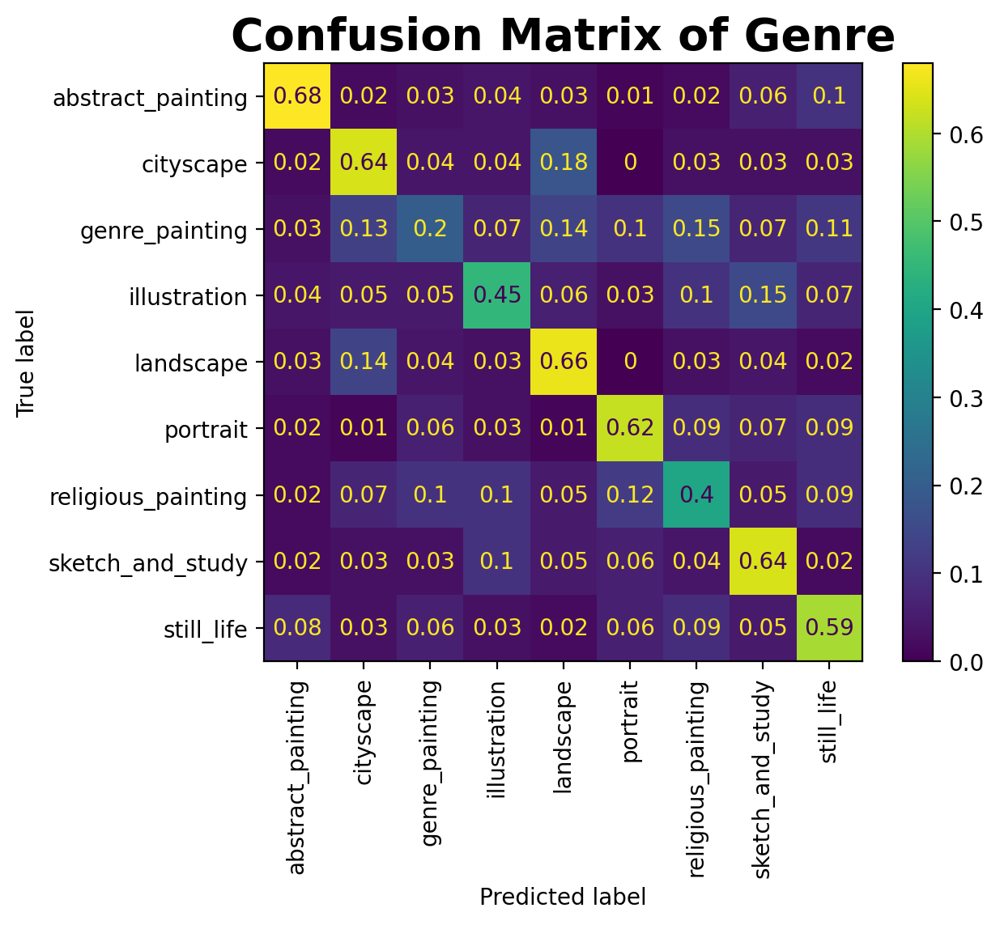

In [51]:
from sklearn.metrics import ConfusionMatrixDisplay


# ConfusionMatrixDisplay(cm, display_labels=testset.classes).plot()

# https://gist.github.com/claudiodsf/6596204#file-np_divide-py-L8
cm_ratio = cm / cm.sum(axis=1)[:, np.newaxis]
cm_ratio = cm_ratio.round(2)
# cm_ratio.sum(axis=1)
fig, ax = plt.subplots(1,1 ,dpi=200)
ConfusionMatrixDisplay(cm_ratio, display_labels=testset.classes).plot(ax=ax)
plt.axes(ax)
plt.xticks(rotation= 90)
plt.title('Confusion Matrix of Genre' , fontsize=20, fontweight = 'bold')

In [52]:
import random
images = trainsetorigin.imgs


# images = random.sample(images, 20)
df = pd.DataFrame(images)
df.columns = ['location', 'label']

df


,location,label
0,../data/wiki_image/genre_train/abstract_painti...,0
1,../data/wiki_image/genre_train/abstract_painti...,0
2,../data/wiki_image/genre_train/abstract_painti...,0
3,../data/wiki_image/genre_train/abstract_painti...,0
4,../data/wiki_image/genre_train/abstract_painti...,0
...,...,...
45498,../data/wiki_image/genre_train/still_life/zina...,9
45499,../data/wiki_image/genre_train/still_life/zina...,9
45500,../data/wiki_image/genre_train/still_life/zina...,9
45501,../data/wiki_image/genre_train/still_life/zina...,9


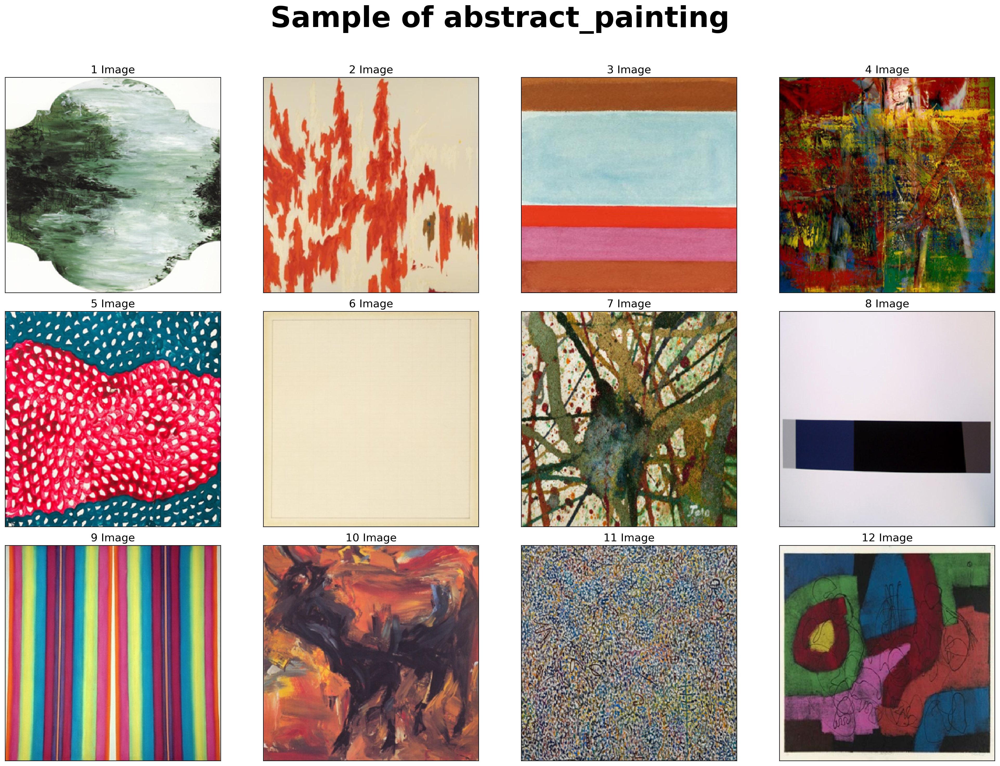

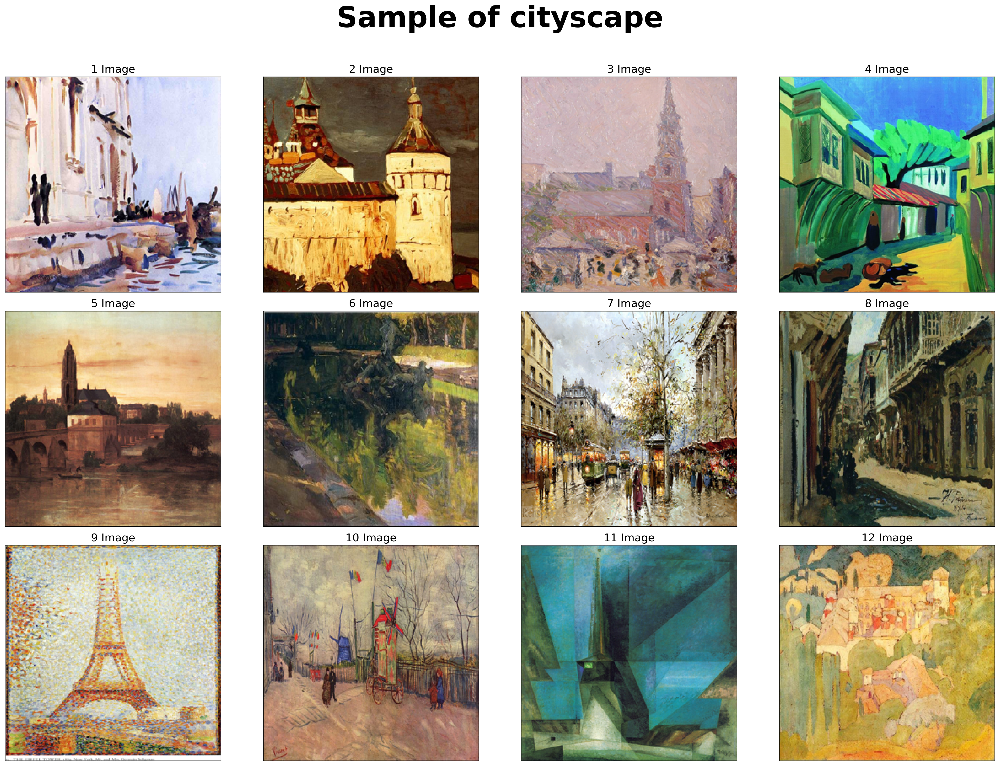

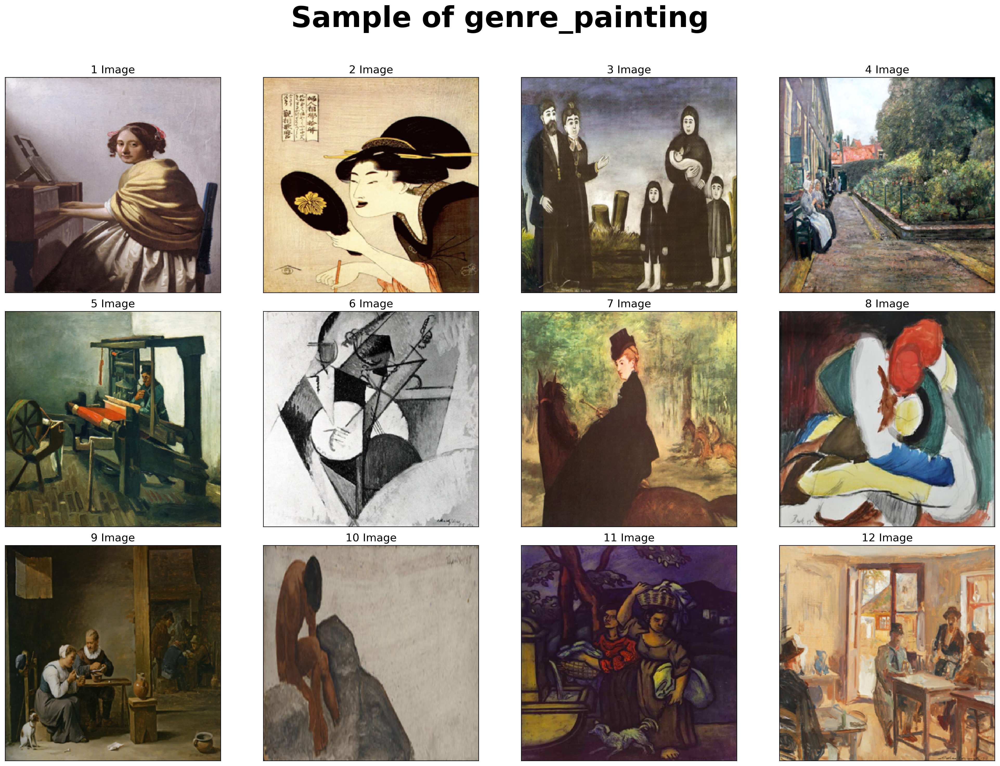

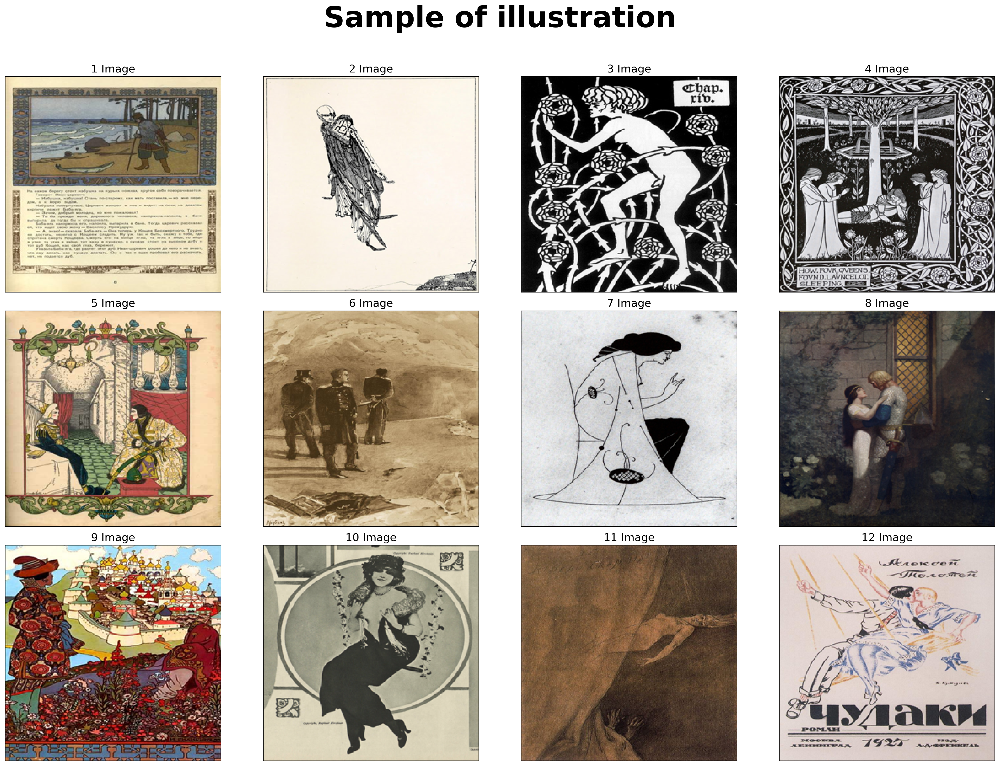

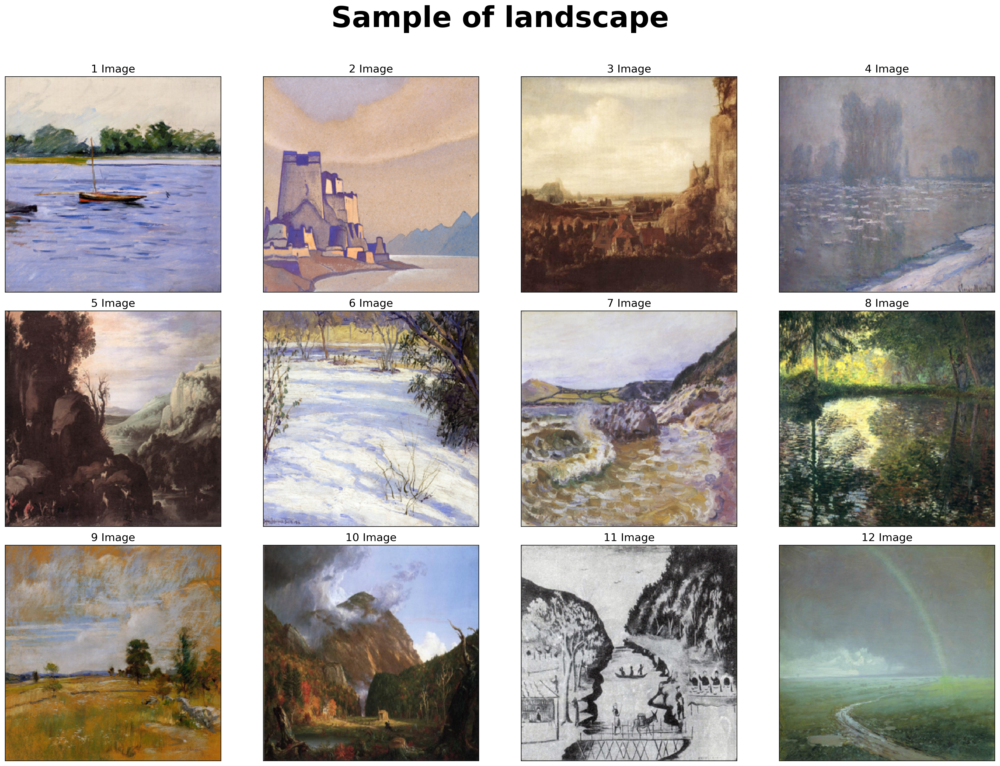

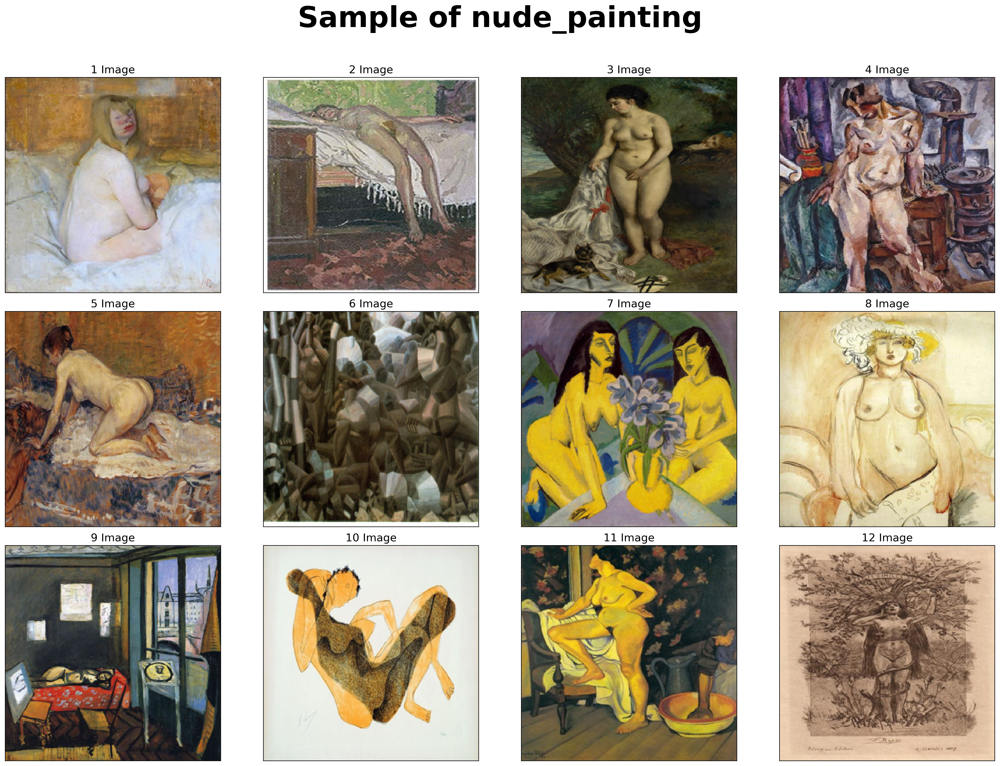

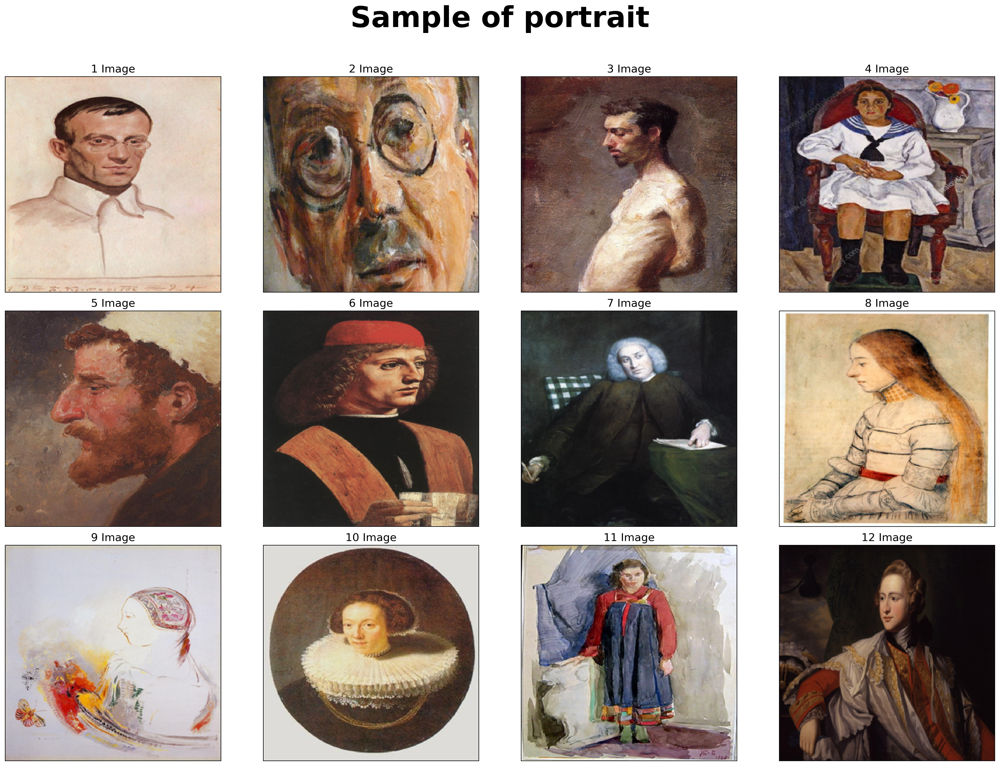

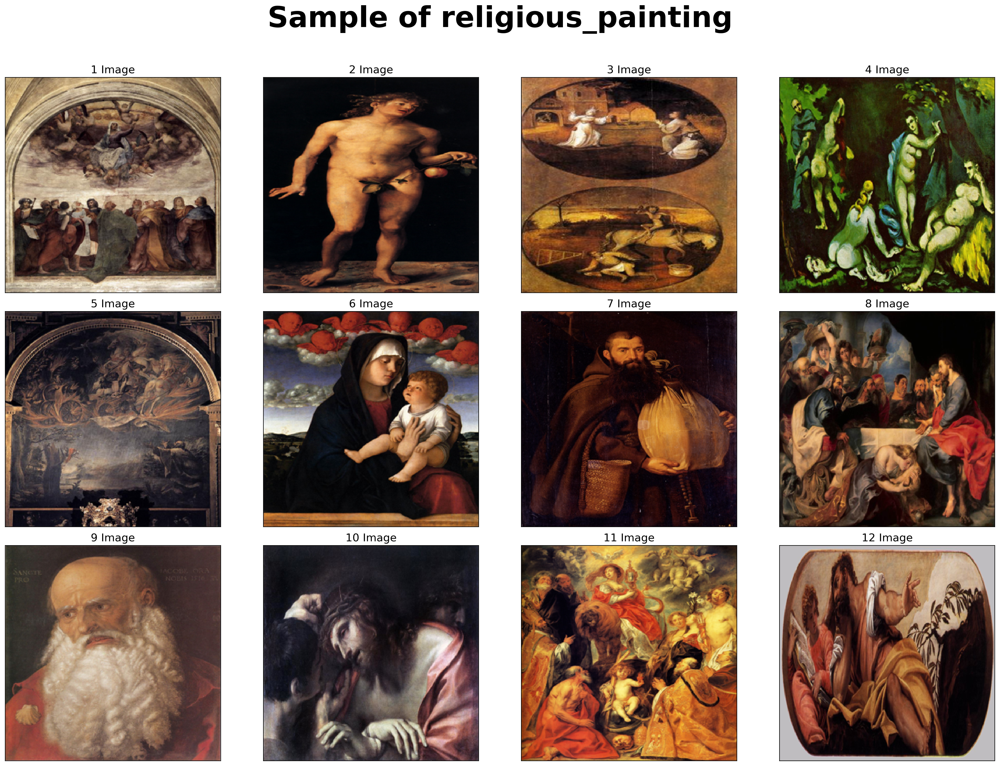

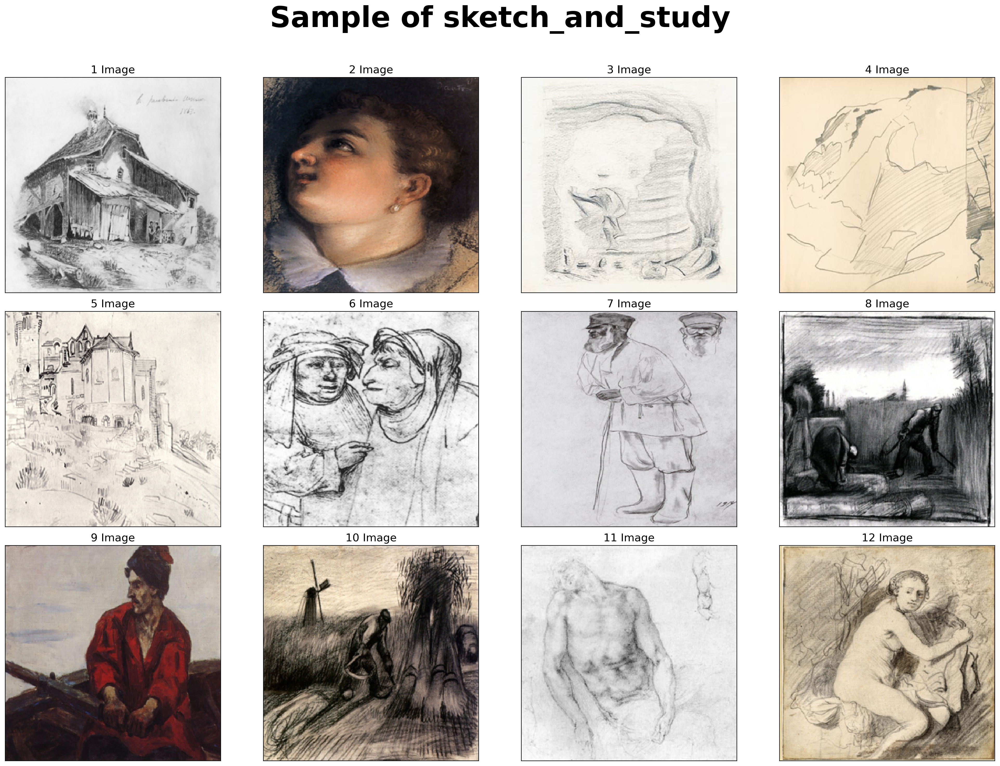

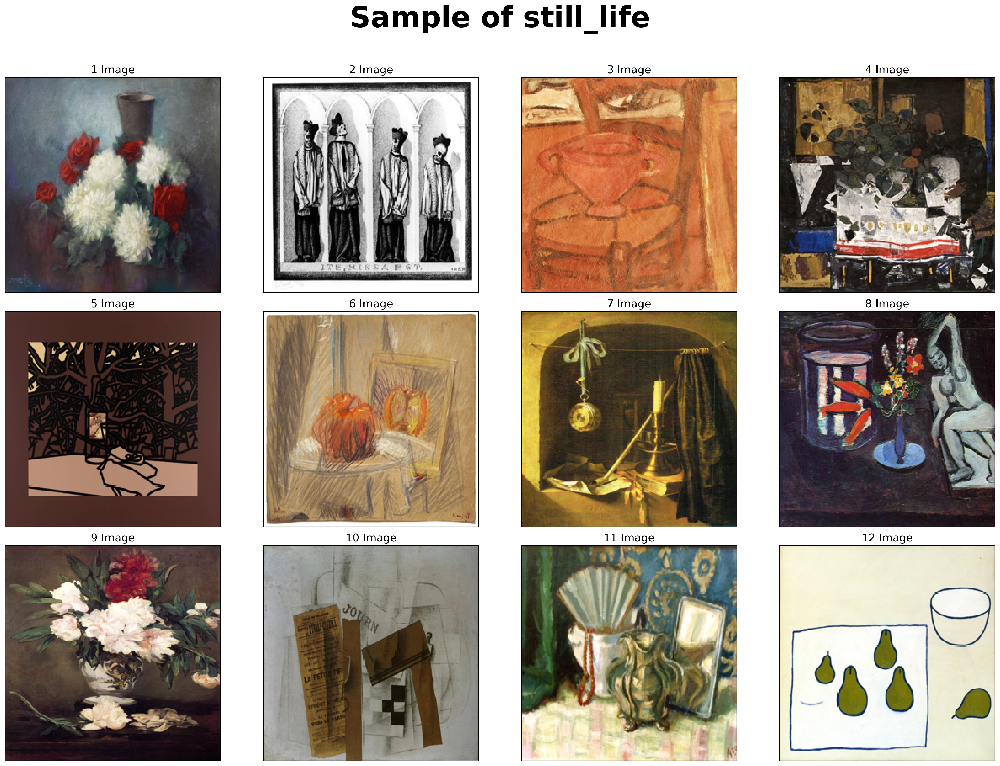

In [53]:

from PIL import Image

def show_layer(trainset,div,title):
    num = trainset.__len__()
    row = num // div + 1 if num % div >= 1 else num // div
    fig, ax = plt.subplots(row, div, figsize=(div * 5, row * 5), dpi = 200)
    fig.suptitle(title, fontsize=40, fontweight = 'bold')
    for idx, data  in enumerate(trainset):
        plt.axes(ax[idx//div, idx%div])
        plt.imshow(Image.open(data).resize((256,256)))
        plt.title(f'{idx+1} Image', fontsize=15)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
    plt.tight_layout()
    plt.show()
labels = trainsetorigin.classes
# labels.remove('nude_painting')
for idx, label in enumerate(labels):
    show_layer(df[df['label'] == idx].sample(12)['location'].tolist(), 4,f"Sample of {label}\n")


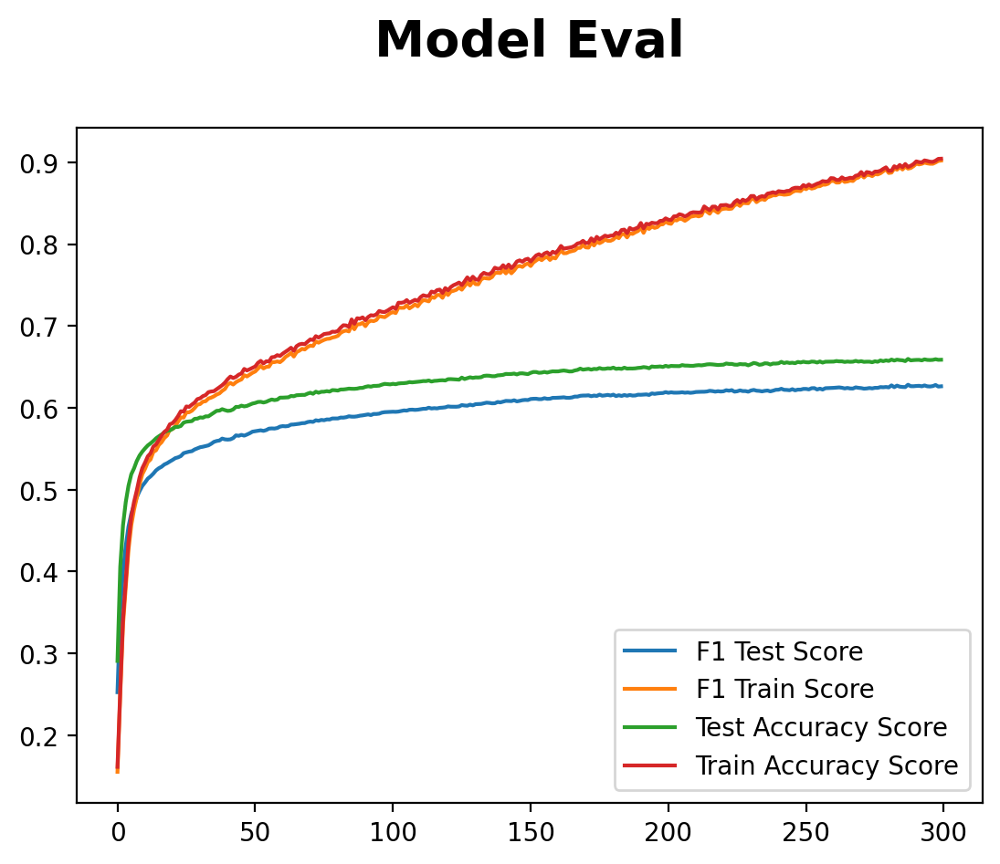

300


In [54]:
plottarget = [
    f1,
    acc,
    train_loss,
    test_loss,
]
plt.figure(dpi=200)
plt.plot(f1, label='F1 Test Score')
plt.plot(f1_train, label='F1 Train Score')
plt.plot(acc, label='Test Accuracy Score')
plt.plot(acc_train, label='Train Accuracy Score')
plt.legend()
plt.title("Model Eval\n", fontsize = 20, fontweight = 'bold')
plt.show()
print(test_loss.__len__())

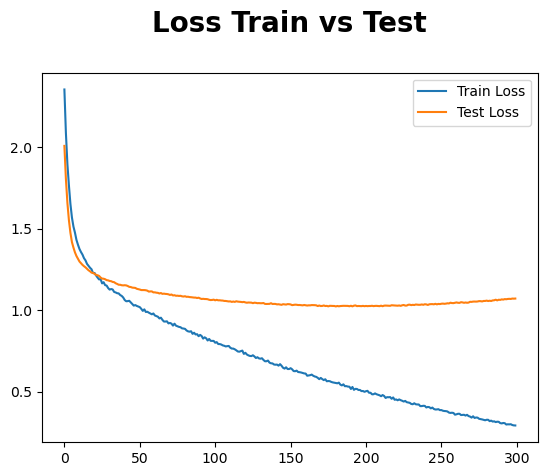

In [55]:
plt.plot(train_loss, label="Train Loss")
plt.plot(test_loss, label="Test Loss")
plt.title('Loss Train vs Test\n', fontsize=20, fontweight = 'bold')
plt.legend()
plt.show()

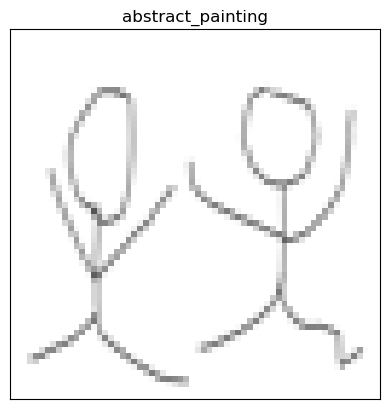

In [56]:
# use Model

from PIL import Image
import cv2

def predict(loc, ax):
    image = Image.open(loc).resize((64,64)).convert("RGB")
    imageori = image.copy()
    imageT = preprocess_vgg11(imageori).to(DEVICE)
    imageT = imageT.unsqueeze(0)

    result = trainset.classes[torch.max(model(imageT), dim=1)[-1].item()]

    plt.axes(ax)
    plt.imshow(imageori)
    plt.title(result)
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.show()

fig, ax = plt.subplots(1,1)
predict('./predict.png', ax)
    

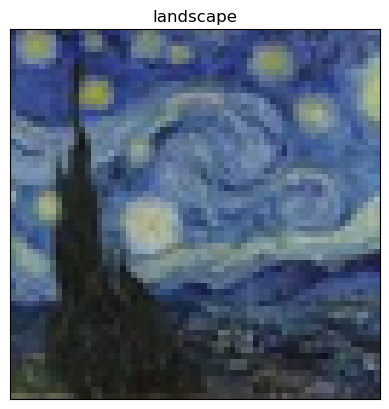

In [57]:
fig, ax = plt.subplots(1,1)
predict('./star.jpg', ax)

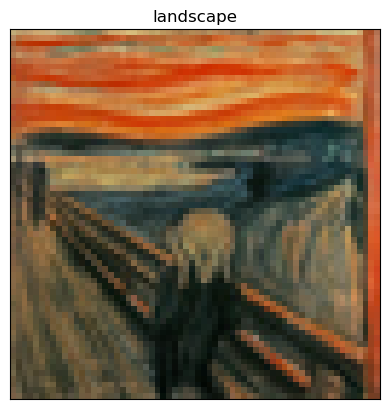

In [58]:
fig, ax = plt.subplots(1,1)
predict('./scream.jpg', ax)